In [10]:
import argparse
from pykeen.hpo import hpo_pipeline
from pykeen.triples import TriplesFactory
from rdflib import Graph

import os
import pandas as pd
import json

import seaborn as sns
import matplotlib.pyplot as plt
import yaml


In [11]:
def load_config(config_path: str) -> dict:
    """Load a YAML config file"""

    with open(config_path, "r", encoding="utf-8") as file:
        config = yaml.safe_load(file)

    return config

In [5]:
# Function to convert turtle KG file to TSV
def turtle_to_tsv(input_file, output_file):
    # Load the Turtle file into an RDFLib Graph
    g = Graph()
    g.parse(input_file, format='turtle')

    # Open the TSV file for writing
    with open(output_file, 'w') as tsvfile:
        # Iterate over triples and write them to the TSV file
        for subj, pred, obj in g:
            tsvfile.write(f"{subj}\t{pred}\t{obj}\n")

In [6]:
# Generate TSV file from Turtle KG
input_file = 'input.ttl'  # Replace with your Turtle file path
output_file = 'output.tsv'  # Output TSV file path
turtle_to_tsv(input_file, output_file)

In [7]:
# Function to generate experiment name from experiment configuration - useful to saving artifacts
def generate_experiment_name(model_name, sampler_name):
    """Generate a unique experiment name based on the combination of parameters"""
    return f"{model_name}_hpo_{sampler_name}"

In [8]:
def run_hpo(config: dict) -> None:
    """Run a HPO run using the provided config"""

    tf = TriplesFactory.from_path('output.tsv', create_inverse_triples=config["train"]["create_inverse"])
    training, testing, validation = tf.split([.8, .1, .1])

    for model in config["models"]:
        for sampler in config["hpo"]["sampler"]:

            experiment_name = generate_experiment_name(model["name"], sampler)
            experiment_path = os.path.join(config["save"]["path"], experiment_name)

            hpo_pipeline_result = hpo_pipeline(
                study_name=experiment_name,
                n_trials=config["hpo"]["ntrials"],
                pruner="MedianPruner",
                sampler=sampler,
                training=training,
                testing=testing,
                validation=validation,
                model=model["name"],
                model_kwargs={
                    "random_seed": config["seed"],
                },
                model_kwargs_ranges=dict(
                    embedding_dim=dict(
                        type=int,
                        low=config["hpo"]["emb"]["low"],
                        high=config["hpo"]["emb"]["high"],
                        q=config["hpo"]["emb"]["step"],
                    ),
                ),
                training_loop="sLCWA",
                training_kwargs_ranges=dict(
                    num_epochs=dict(
                        type=int,
                        low=config["hpo"]["num_epochs"]["low"],
                        high=config["hpo"]["num_epochs"]["high"],
                        q=config["hpo"]["num_epochs"]["step"],
                    ),
                ),
                optimizer=config["optimizer"]["class"],
                optimizer_kwargs_ranges=dict(
                    lr=dict(
                        type=float,
                        low=config["hpo"]["lr"]["low"],
                        high=config["hpo"]["lr"]["high"],
                    ),
                ),
                negative_sampler_kwargs_ranges=dict(
                    num_negs_per_pos=dict(
                        type=int,
                        low=config["hpo"]["neg"]["low"],
                        high=config["hpo"]["neg"]["high"],
                        q=config["hpo"]["neg"]["step"],
                    ),
                ),
                evaluator_kwargs={"filtered": True},
            )

            hpo_pipeline_result.save_to_directory(experiment_path)

    print("Run Complete!")

In [12]:
# Directly assign the path to your YAML configuration file here
config_path = './rotate.yaml'

run_config = load_config(config_path)

assert run_config["type"] == "hpo", "Incorrect Config Type"

run_hpo(run_config)

using automatically assigned random_state=1989105784
[I 2024-02-11 12:53:57,224] A new study created in memory with name: ComplEx_hpo_tpe
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
No random seed is specified. Setting to 3526273620.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:375: UserWarning: Directly use Embedding.shape instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.shape instead of num_embeddings.")


Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 12:54:07,096] Trial 0 finished with value: 0.006178853300595717 and parameters: {'model.embedding_dim': 48, 'optimizer.lr': 0.08210484349673178, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 50, 'training.batch_size': 3032}. Best is trial 0 with value: 0.006178853300595717.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representati

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 12:54:20,788] Trial 1 finished with value: 0.005637211436795776 and parameters: {'model.embedding_dim': 464, 'optimizer.lr': 0.017375201348467664, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 50, 'training.batch_size': 1632}. Best is trial 0 with value: 0.006178853300595717.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 12:54:32,475] Trial 2 finished with value: 0.005016759191107632 and parameters: {'model.embedding_dim': 208, 'optimizer.lr': 0.045165381487378864, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 40, 'training.batch_size': 432}. Best is trial 0 with value: 0.006178853300595717.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 12:54:34,658] Trial 3 finished with value: 0.004620815975203909 and parameters: {'model.embedding_dim': 512, 'optimizer.lr': 0.03380484592297852, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 10, 'training.batch_size': 3932}. Best is trial 0 with value: 0.006178853300595717.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 12:54:46,990] Trial 4 finished with value: 0.007547949862714204 and parameters: {'model.embedding_dim': 176, 'optimizer.lr': 0.07010834200513703, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 50, 'training.batch_size': 1232}. Best is trial 4 with value: 0.007547949862714204.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 12:54:53,197] Trial 5 finished with value: 0.018014194124849635 and parameters: {'model.embedding_dim': 32, 'optimizer.lr': 0.01303739728274141, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 30, 'training.batch_size': 1932}. Best is trial 5 with value: 0.018014194124849635.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representati

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 12:55:01,944] Trial 6 finished with value: 0.005836948527457748 and parameters: {'model.embedding_dim': 368, 'optimizer.lr': 0.015443221830235533, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 30, 'training.batch_size': 1632}. Best is trial 5 with value: 0.018014194124849635.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 12:55:10,883] Trial 7 finished with value: 0.005001170563882335 and parameters: {'model.embedding_dim': 512, 'optimizer.lr': 0.018996080445037793, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 30, 'training.batch_size': 2332}. Best is trial 5 with value: 0.018014194124849635.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 12:55:17,913] Trial 8 finished with value: 0.007095804136649407 and parameters: {'model.embedding_dim': 192, 'optimizer.lr': 0.021635206087094655, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 40, 'training.batch_size': 632}. Best is trial 5 with value: 0.018014194124849635.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representati

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 12:55:23,965] Trial 9 finished with value: 0.008126881959282989 and parameters: {'model.embedding_dim': 288, 'optimizer.lr': 0.06741055972882454, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 20, 'training.batch_size': 732}. Best is trial 5 with value: 0.018014194124849635.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representati

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.03s seconds
[I 2024-02-11 12:55:26,202] Trial 10 finished with value: 0.010269871277467616 and parameters: {'model.embedding_dim': 16, 'optimizer.lr': 0.006330779505857072, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 10, 'training.batch_size': 2632}. Best is trial 5 with value: 0.018014194124849635.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 12:55:28,518] Trial 11 finished with value: 0.01793510775553115 and parameters: {'model.embedding_dim': 32, 'optimizer.lr': 0.002444557259969235, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 10, 'training.batch_size': 2532}. Best is trial 5 with value: 0.018014194124849635.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 12:55:33,001] Trial 12 finished with value: 0.009418764958126566 and parameters: {'model.embedding_dim': 96, 'optimizer.lr': 0.0018517942268122803, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 20, 'training.batch_size': 3232}. Best is trial 5 with value: 0.018014194124849635.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 12:55:37,028] Trial 13 finished with value: 0.008180657674496711 and parameters: {'model.embedding_dim': 112, 'optimizer.lr': 0.03622894804588627, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 20, 'training.batch_size': 2132}. Best is trial 5 with value: 0.018014194124849635.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 12:55:39,607] Trial 14 finished with value: 0.006791273649650469 and parameters: {'model.embedding_dim': 96, 'optimizer.lr': 0.09849594759389725, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 10, 'training.batch_size': 2732}. Best is trial 5 with value: 0.018014194124849635.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 12:55:47,892] Trial 15 finished with value: 0.010004821084040615 and parameters: {'model.embedding_dim': 16, 'optimizer.lr': 0.001145101326812428, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 40, 'training.batch_size': 3632}. Best is trial 5 with value: 0.018014194124849635.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 12:55:54,577] Trial 16 finished with value: 0.008647077966314445 and parameters: {'model.embedding_dim': 320, 'optimizer.lr': 0.03088930655389472, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 20, 'training.batch_size': 1732}. Best is trial 5 with value: 0.018014194124849635.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 12:56:00,807] Trial 17 finished with value: 0.004646847144839794 and parameters: {'model.embedding_dim': 144, 'optimizer.lr': 0.04837366555525126, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 30, 'training.batch_size': 1132}. Best is trial 5 with value: 0.018014194124849635.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 12:56:08,344] Trial 18 finished with value: 0.011143646337455753 and parameters: {'model.embedding_dim': 240, 'optimizer.lr': 0.011178236260260294, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 30, 'training.batch_size': 2232}. Best is trial 5 with value: 0.018014194124849635.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 12:56:11,295] Trial 19 finished with value: 0.0076206688242616135 and parameters: {'model.embedding_dim': 64, 'optimizer.lr': 0.061804457367202414, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 10, 'training.batch_size': 132}. Best is trial 5 with value: 0.018014194124849635.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 12:56:15,908] Trial 20 finished with value: 0.00848355633398469 and parameters: {'model.embedding_dim': 400, 'optimizer.lr': 0.02795047984574919, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 20, 'training.batch_size': 2632}. Best is trial 5 with value: 0.018014194124849635.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 12:56:24,040] Trial 21 finished with value: 0.005355393961867283 and parameters: {'model.embedding_dim': 256, 'optimizer.lr': 0.011033632291395989, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 30, 'training.batch_size': 2132}. Best is trial 5 with value: 0.018014194124849635.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 12:56:33,971] Trial 22 finished with value: 0.005658946766033256 and parameters: {'model.embedding_dim': 224, 'optimizer.lr': 0.01074528964935411, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 40, 'training.batch_size': 2332}. Best is trial 5 with value: 0.018014194124849635.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 12:56:40,657] Trial 23 finished with value: 0.005005155078649566 and parameters: {'model.embedding_dim': 144, 'optimizer.lr': 0.02318160069078574, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 30, 'training.batch_size': 1832}. Best is trial 5 with value: 0.018014194124849635.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 12:56:47,833] Trial 24 finished with value: 0.008081302762997952 and parameters: {'model.embedding_dim': 64, 'optimizer.lr': 0.042669867136565134, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 30, 'training.batch_size': 1232}. Best is trial 5 with value: 0.018014194124849635.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 12:56:58,662] Trial 25 finished with value: 0.005126614159616054 and parameters: {'model.embedding_dim': 144, 'optimizer.lr': 0.008573862029499248, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 40, 'training.batch_size': 3132}. Best is trial 5 with value: 0.018014194124849635.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 12:57:03,269] Trial 26 finished with value: 0.009017862847272776 and parameters: {'model.embedding_dim': 16, 'optimizer.lr': 0.026040266856335488, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 20, 'training.batch_size': 2432}. Best is trial 5 with value: 0.018014194124849635.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 12:57:09,029] Trial 27 finished with value: 0.006683070103501803 and parameters: {'model.embedding_dim': 368, 'optimizer.lr': 0.01365198416332013, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 30, 'training.batch_size': 2832}. Best is trial 5 with value: 0.018014194124849635.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 12:57:12,419] Trial 28 finished with value: 0.008205332863010407 and parameters: {'model.embedding_dim': 320, 'optimizer.lr': 0.05524260568107954, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 10, 'training.batch_size': 2032}. Best is trial 5 with value: 0.018014194124849635.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 12:57:23,116] Trial 29 finished with value: 0.006108099490940679 and parameters: {'model.embedding_dim': 48, 'optimizer.lr': 0.07824677752886591, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 50, 'training.batch_size': 3232}. Best is trial 5 with value: 0.018014194124849635.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 12:57:27,514] Trial 30 finished with value: 0.011964905351048612 and parameters: {'model.embedding_dim': 240, 'optimizer.lr': 0.005707625539074125, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 20, 'training.batch_size': 2932}. Best is trial 5 with value: 0.018014194124849635.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 12:57:32,066] Trial 31 finished with value: 0.012005191118845678 and parameters: {'model.embedding_dim': 240, 'optimizer.lr': 0.004540759322831961, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 20, 'training.batch_size': 2932}. Best is trial 5 with value: 0.018014194124849635.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 12:57:36,579] Trial 32 finished with value: 0.008689579536155024 and parameters: {'model.embedding_dim': 288, 'optimizer.lr': 0.004800926063768404, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 20, 'training.batch_size': 3532}. Best is trial 5 with value: 0.018014194124849635.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 12:57:39,097] Trial 33 finished with value: 0.015593739592816855 and parameters: {'model.embedding_dim': 176, 'optimizer.lr': 0.01682821865181747, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 10, 'training.batch_size': 2932}. Best is trial 5 with value: 0.018014194124849635.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 12:57:41,644] Trial 34 finished with value: 0.008360308349406927 and parameters: {'model.embedding_dim': 112, 'optimizer.lr': 0.03965547084271681, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 10, 'training.batch_size': 3432}. Best is trial 5 with value: 0.018014194124849635.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 12:57:43,981] Trial 35 finished with value: 0.006386757777046941 and parameters: {'model.embedding_dim': 160, 'optimizer.lr': 0.018230764182773744, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 10, 'training.batch_size': 2532}. Best is trial 5 with value: 0.018014194124849635.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 12:57:46,657] Trial 36 finished with value: 0.007518845768050997 and parameters: {'model.embedding_dim': 192, 'optimizer.lr': 0.016502179798547276, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 10, 'training.batch_size': 3032}. Best is trial 5 with value: 0.018014194124849635.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 12:57:49,166] Trial 37 finished with value: 0.011080165232222062 and parameters: {'model.embedding_dim': 80, 'optimizer.lr': 0.02308538519138382, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 10, 'training.batch_size': 3732}. Best is trial 5 with value: 0.018014194124849635.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 12:57:53,922] Trial 38 finished with value: 0.011244978518166913 and parameters: {'model.embedding_dim': 48, 'optimizer.lr': 0.03263211631877918, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 20, 'training.batch_size': 1432}. Best is trial 5 with value: 0.018014194124849635.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 12:57:56,353] Trial 39 finished with value: 0.0070845297016802495 and parameters: {'model.embedding_dim': 208, 'optimizer.lr': 0.0010972826347827348, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 10, 'training.batch_size': 3932}. Best is trial 5 with value: 0.018014194124849635.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represen

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 12:57:59,153] Trial 40 finished with value: 0.008371758529340618 and parameters: {'model.embedding_dim': 288, 'optimizer.lr': 0.014604208245574167, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 10, 'training.batch_size': 1832}. Best is trial 5 with value: 0.018014194124849635.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 12:58:03,816] Trial 41 finished with value: 0.011947602961174244 and parameters: {'model.embedding_dim': 240, 'optimizer.lr': 0.007009290671076266, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 20, 'training.batch_size': 2932}. Best is trial 5 with value: 0.018014194124849635.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 12:58:08,431] Trial 42 finished with value: 0.015575748585873446 and parameters: {'model.embedding_dim': 176, 'optimizer.lr': 0.00817870542433925, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 20, 'training.batch_size': 3332}. Best is trial 5 with value: 0.018014194124849635.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 12:58:12,856] Trial 43 finished with value: 0.009554732644176464 and parameters: {'model.embedding_dim': 192, 'optimizer.lr': 0.018203833087543215, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 20, 'training.batch_size': 3332}. Best is trial 5 with value: 0.018014194124849635.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 12:58:15,710] Trial 44 finished with value: 0.012261020967910761 and parameters: {'model.embedding_dim': 128, 'optimizer.lr': 0.006047012673732063, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 10, 'training.batch_size': 2732}. Best is trial 5 with value: 0.018014194124849635.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 12:58:18,589] Trial 45 finished with value: 0.012261557882243918 and parameters: {'model.embedding_dim': 128, 'optimizer.lr': 0.011860394593602993, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 10, 'training.batch_size': 2732}. Best is trial 5 with value: 0.018014194124849635.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 12:58:21,675] Trial 46 finished with value: 0.013253082280538368 and parameters: {'model.embedding_dim': 176, 'optimizer.lr': 0.021475217348201445, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 10, 'training.batch_size': 2532}. Best is trial 5 with value: 0.018014194124849635.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 12:58:24,681] Trial 47 finished with value: 0.013253097398600373 and parameters: {'model.embedding_dim': 176, 'optimizer.lr': 0.02145783009280996, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 10, 'training.batch_size': 2432}. Best is trial 5 with value: 0.018014194124849635.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 12:58:27,622] Trial 48 finished with value: 0.018488253959449377 and parameters: {'model.embedding_dim': 32, 'optimizer.lr': 0.02742021093281974, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 10, 'training.batch_size': 1432}. Best is trial 48 with value: 0.018488253959449377.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.03s seconds
[I 2024-02-11 12:58:30,746] Trial 49 finished with value: 0.017164036417237263 and parameters: {'model.embedding_dim': 32, 'optimizer.lr': 0.027378485659836655, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 10, 'training.batch_size': 932}. Best is trial 48 with value: 0.018488253959449377.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.03s seconds
[I 2024-02-11 12:58:43,589] Trial 50 finished with value: 0.016168971739183375 and parameters: {'model.embedding_dim': 32, 'optimizer.lr': 0.028003957033130297, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 50, 'training.batch_size': 932}. Best is trial 48 with value: 0.018488253959449377.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 12:58:56,567] Trial 51 finished with value: 0.016170014096020684 and parameters: {'model.embedding_dim': 32, 'optimizer.lr': 0.028297976325045278, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 50, 'training.batch_size': 932}. Best is trial 48 with value: 0.018488253959449377.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 12:59:09,693] Trial 52 finished with value: 0.015662566764016422 and parameters: {'model.embedding_dim': 32, 'optimizer.lr': 0.035943960130599584, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 50, 'training.batch_size': 932}. Best is trial 48 with value: 0.018488253959449377.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 12:59:23,777] Trial 53 finished with value: 0.01632914868289157 and parameters: {'model.embedding_dim': 32, 'optimizer.lr': 0.028922508285870115, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 50, 'training.batch_size': 432}. Best is trial 48 with value: 0.018488253959449377.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 12:59:38,532] Trial 54 finished with value: 0.006805954400634249 and parameters: {'model.embedding_dim': 80, 'optimizer.lr': 0.03071742663666186, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 50, 'training.batch_size': 532}. Best is trial 48 with value: 0.018488253959449377.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 12:59:50,171] Trial 55 finished with value: 0.015266551917417335 and parameters: {'model.embedding_dim': 32, 'optimizer.lr': 0.048769815595102434, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 40, 'training.batch_size': 332}. Best is trial 48 with value: 0.018488253959449377.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:00:02,264] Trial 56 finished with value: 0.006786018579017005 and parameters: {'model.embedding_dim': 80, 'optimizer.lr': 0.03734360575896871, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 40, 'training.batch_size': 832}. Best is trial 48 with value: 0.018488253959449377.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:00:17,075] Trial 57 finished with value: 0.0063063766377368735 and parameters: {'model.embedding_dim': 64, 'optimizer.lr': 0.040378124834622976, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 50, 'training.batch_size': 1432}. Best is trial 48 with value: 0.018488253959449377.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represen

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:00:41,459] Trial 58 finished with value: 0.00873804209517603 and parameters: {'model.embedding_dim': 16, 'optimizer.lr': 0.0261011051094199, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 50, 'training.batch_size': 32}. Best is trial 48 with value: 0.018488253959449377.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:00:55,646] Trial 59 finished with value: 0.00593333597800606 and parameters: {'model.embedding_dim': 96, 'optimizer.lr': 0.0573850351820689, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 50, 'training.batch_size': 1532}. Best is trial 48 with value: 0.018488253959449377.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representati

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:01:08,019] Trial 60 finished with value: 0.010433178234296158 and parameters: {'model.embedding_dim': 48, 'optimizer.lr': 0.044552436025770775, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 40, 'training.batch_size': 332}. Best is trial 48 with value: 0.018488253959449377.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:01:22,335] Trial 61 finished with value: 0.019569116887222376 and parameters: {'model.embedding_dim': 32, 'optimizer.lr': 0.029165471482209975, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 50, 'training.batch_size': 1032}. Best is trial 61 with value: 0.019569116887222376.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:01:36,432] Trial 62 finished with value: 0.019252402873319165 and parameters: {'model.embedding_dim': 32, 'optimizer.lr': 0.02985790994441571, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 50, 'training.batch_size': 1132}. Best is trial 61 with value: 0.019569116887222376.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:01:50,484] Trial 63 finished with value: 0.007288270204949567 and parameters: {'model.embedding_dim': 16, 'optimizer.lr': 0.03338765148926539, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 50, 'training.batch_size': 632}. Best is trial 61 with value: 0.019569116887222376.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:02:04,709] Trial 64 finished with value: 0.011064585198792143 and parameters: {'model.embedding_dim': 48, 'optimizer.lr': 0.025173278356459106, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 50, 'training.batch_size': 1132}. Best is trial 61 with value: 0.019569116887222376.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:02:16,534] Trial 65 finished with value: 0.007580780211007219 and parameters: {'model.embedding_dim': 64, 'optimizer.lr': 0.030404450207435783, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 40, 'training.batch_size': 1232}. Best is trial 61 with value: 0.019569116887222376.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:02:32,453] Trial 66 finished with value: 0.006824267090390654 and parameters: {'model.embedding_dim': 96, 'optimizer.lr': 0.019779790929259376, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 50, 'training.batch_size': 1332}. Best is trial 61 with value: 0.019569116887222376.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:02:45,340] Trial 67 finished with value: 0.006250486883441413 and parameters: {'model.embedding_dim': 432, 'optimizer.lr': 0.09720095064371576, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 40, 'training.batch_size': 1632}. Best is trial 61 with value: 0.019569116887222376.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:03:00,306] Trial 68 finished with value: 0.016742068029305245 and parameters: {'model.embedding_dim': 32, 'optimizer.lr': 0.03756444346883709, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 50, 'training.batch_size': 732}. Best is trial 61 with value: 0.019569116887222376.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:03:12,480] Trial 69 finished with value: 0.007860304452789164 and parameters: {'model.embedding_dim': 64, 'optimizer.lr': 0.037817018160353655, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 40, 'training.batch_size': 1132}. Best is trial 61 with value: 0.019569116887222376.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:03:21,761] Trial 70 finished with value: 0.008641021755552513 and parameters: {'model.embedding_dim': 16, 'optimizer.lr': 0.034891864944663155, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 30, 'training.batch_size': 1832}. Best is trial 61 with value: 0.019569116887222376.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:03:37,967] Trial 71 finished with value: 0.014820870722274159 and parameters: {'model.embedding_dim': 32, 'optimizer.lr': 0.04309989932372936, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 50, 'training.batch_size': 632}. Best is trial 61 with value: 0.019569116887222376.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:03:53,569] Trial 72 finished with value: 0.00935773274597668 and parameters: {'model.embedding_dim': 48, 'optimizer.lr': 0.02412941432583352, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 50, 'training.batch_size': 832}. Best is trial 61 with value: 0.019569116887222376.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representati

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:04:10,056] Trial 73 finished with value: 0.007459972339547483 and parameters: {'model.embedding_dim': 80, 'optimizer.lr': 0.03020339946617348, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 50, 'training.batch_size': 432}. Best is trial 61 with value: 0.019569116887222376.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:04:24,830] Trial 74 finished with value: 0.015066463617008571 and parameters: {'model.embedding_dim': 32, 'optimizer.lr': 0.05269178317153077, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 50, 'training.batch_size': 1032}. Best is trial 61 with value: 0.019569116887222376.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.03s seconds
[I 2024-02-11 13:04:39,883] Trial 75 finished with value: 0.00777378668031909 and parameters: {'model.embedding_dim': 16, 'optimizer.lr': 0.039397152288158044, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 50, 'training.batch_size': 732}. Best is trial 61 with value: 0.019569116887222376.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:04:43,835] Trial 76 finished with value: 0.009375994048231825 and parameters: {'model.embedding_dim': 112, 'optimizer.lr': 0.013461109996005626, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 10, 'training.batch_size': 1332}. Best is trial 61 with value: 0.019569116887222376.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represen

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.03s seconds
[I 2024-02-11 13:04:59,523] Trial 77 finished with value: 0.007502177307522048 and parameters: {'model.embedding_dim': 64, 'optimizer.lr': 0.03222268635868139, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 50, 'training.batch_size': 732}. Best is trial 61 with value: 0.019569116887222376.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:05:03,525] Trial 78 finished with value: 0.009797223240336168 and parameters: {'model.embedding_dim': 48, 'optimizer.lr': 0.027509822103480693, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 10, 'training.batch_size': 1032}. Best is trial 61 with value: 0.019569116887222376.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:05:13,309] Trial 79 finished with value: 0.007927535413351585 and parameters: {'model.embedding_dim': 16, 'optimizer.lr': 0.046004388391303386, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 30, 'training.batch_size': 2032}. Best is trial 61 with value: 0.019569116887222376.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 13:05:27,968] Trial 80 finished with value: 0.0067035209088031145 and parameters: {'model.embedding_dim': 480, 'optimizer.lr': 0.0031935127568553648, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 40, 'training.batch_size': 232}. Best is trial 61 with value: 0.019569116887222376.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represe

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:05:44,115] Trial 81 finished with value: 0.016153071028945396 and parameters: {'model.embedding_dim': 32, 'optimizer.lr': 0.028522934751825442, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 50, 'training.batch_size': 932}. Best is trial 61 with value: 0.019569116887222376.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:06:00,373] Trial 82 finished with value: 0.009545724743106441 and parameters: {'model.embedding_dim': 48, 'optimizer.lr': 0.019669251179532218, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 50, 'training.batch_size': 532}. Best is trial 61 with value: 0.019569116887222376.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:06:18,034] Trial 83 finished with value: 0.007350122574039654 and parameters: {'model.embedding_dim': 80, 'optimizer.lr': 0.03448187236173643, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 50, 'training.batch_size': 2232}. Best is trial 61 with value: 0.019569116887222376.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:06:34,584] Trial 84 finished with value: 0.017279222589119254 and parameters: {'model.embedding_dim': 32, 'optimizer.lr': 0.02288974410018587, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 50, 'training.batch_size': 1732}. Best is trial 61 with value: 0.019569116887222376.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:06:51,743] Trial 85 finished with value: 0.0067578196545906065 and parameters: {'model.embedding_dim': 96, 'optimizer.lr': 0.02278067689026695, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 50, 'training.batch_size': 1732}. Best is trial 61 with value: 0.019569116887222376.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:06:55,592] Trial 86 finished with value: 0.009739116656343066 and parameters: {'model.embedding_dim': 16, 'optimizer.lr': 0.02491155756015037, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 10, 'training.batch_size': 1932}. Best is trial 61 with value: 0.019569116887222376.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:07:13,170] Trial 87 finished with value: 0.00888916863230117 and parameters: {'model.embedding_dim': 64, 'optimizer.lr': 0.01687965870157246, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 50, 'training.batch_size': 1432}. Best is trial 61 with value: 0.019569116887222376.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:07:17,052] Trial 88 finished with value: 0.011688256002088802 and parameters: {'model.embedding_dim': 48, 'optimizer.lr': 0.02066037667541952, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 10, 'training.batch_size': 1732}. Best is trial 61 with value: 0.019569116887222376.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:07:33,822] Trial 89 finished with value: 0.018000382348065103 and parameters: {'model.embedding_dim': 32, 'optimizer.lr': 0.01472112452741513, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 50, 'training.batch_size': 1532}. Best is trial 61 with value: 0.019569116887222376.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:07:40,928] Trial 90 finished with value: 0.018091039723715324 and parameters: {'model.embedding_dim': 32, 'optimizer.lr': 0.00918435108382491, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 20, 'training.batch_size': 1532}. Best is trial 61 with value: 0.019569116887222376.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:07:48,056] Trial 91 finished with value: 0.018097678922839013 and parameters: {'model.embedding_dim': 32, 'optimizer.lr': 0.01002981202427195, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 20, 'training.batch_size': 1532}. Best is trial 61 with value: 0.019569116887222376.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:07:55,155] Trial 92 finished with value: 0.01007906408875379 and parameters: {'model.embedding_dim': 16, 'optimizer.lr': 0.008900967899756307, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 20, 'training.batch_size': 1532}. Best is trial 61 with value: 0.019569116887222376.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:08:05,719] Trial 93 finished with value: 0.010561800986633053 and parameters: {'model.embedding_dim': 64, 'optimizer.lr': 0.010184267110527159, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 30, 'training.batch_size': 1332}. Best is trial 61 with value: 0.019569116887222376.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:08:12,985] Trial 94 finished with value: 0.011637459033917353 and parameters: {'model.embedding_dim': 48, 'optimizer.lr': 0.012907198156673006, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 20, 'training.batch_size': 1632}. Best is trial 61 with value: 0.019569116887222376.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:08:23,100] Trial 95 finished with value: 0.015488524784439964 and parameters: {'model.embedding_dim': 32, 'optimizer.lr': 0.01504438588941729, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 30, 'training.batch_size': 1532}. Best is trial 61 with value: 0.019569116887222376.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:08:27,139] Trial 96 finished with value: 0.012630012393301582 and parameters: {'model.embedding_dim': 80, 'optimizer.lr': 0.003262173797457308, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 10, 'training.batch_size': 1932}. Best is trial 61 with value: 0.019569116887222376.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:08:34,336] Trial 97 finished with value: 0.010181795825074244 and parameters: {'model.embedding_dim': 16, 'optimizer.lr': 0.007022794879835003, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 20, 'training.batch_size': 2132}. Best is trial 61 with value: 0.019569116887222376.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:08:38,623] Trial 98 finished with value: 0.011833856163362107 and parameters: {'model.embedding_dim': 48, 'optimizer.lr': 0.01091656744831173, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 10, 'training.batch_size': 1232}. Best is trial 61 with value: 0.019569116887222376.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:08:47,113] Trial 99 finished with value: 0.005124418862745029 and parameters: {'model.embedding_dim': 336, 'optimizer.lr': 0.01819931542454893, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 20, 'training.batch_size': 1832}. Best is trial 61 with value: 0.019569116887222376.
[I 2024-02-11 13:08:47,174] A new study created in memory with name: ComplEx_hpo_random
INFO:pykeen.hpo.hpo:Using model: <class 'pykeen.models.unimodal.complex.ComplEx'>
INFO:pykeen.hpo.hpo:Using loss: <class 'pykeen.losses.SoftplusLoss'>
INFO:pykeen.hpo.hpo:Using optimizer: <class 'torch.optim.adagrad.Adagrad'>
INFO:pykeen.hpo.hpo:Using training loop: <class 'pykeen.training.slcwa.SLCWATrainingLoop'>
INFO:pykeen.hpo.hpo:Using negative sampler: <class 'pykeen.sampling.basic_negative_sampler.BasicNegativeSampler'>
INFO:pykeen.hpo.hpo:Using evaluator: <class 'pykeen.evaluation.rank_based_evaluator.RankBasedEvaluator'>
INF

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:09:11,352] Trial 0 finished with value: 0.007101814421837775 and parameters: {'model.embedding_dim': 496, 'optimizer.lr': 0.09623522747499104, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 50, 'training.batch_size': 2732}. Best is trial 0 with value: 0.007101814421837775.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:09:25,778] Trial 1 finished with value: 0.00947561179647958 and parameters: {'model.embedding_dim': 48, 'optimizer.lr': 0.03304309956563938, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 40, 'training.batch_size': 2032}. Best is trial 1 with value: 0.00947561179647958.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:09:31,100] Trial 2 finished with value: 0.005858924845895565 and parameters: {'model.embedding_dim': 496, 'optimizer.lr': 0.06586592984292461, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 10, 'training.batch_size': 2532}. Best is trial 1 with value: 0.00947561179647958.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representati

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:09:36,339] Trial 3 finished with value: 0.00898563295727569 and parameters: {'model.embedding_dim': 384, 'optimizer.lr': 0.09547955891996288, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 10, 'training.batch_size': 732}. Best is trial 1 with value: 0.00947561179647958.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:09:41,137] Trial 4 finished with value: 0.007011014846202408 and parameters: {'model.embedding_dim': 288, 'optimizer.lr': 0.02212845396532819, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 10, 'training.batch_size': 432}. Best is trial 1 with value: 0.00947561179647958.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representatio

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:09:45,245] Trial 5 finished with value: 0.008925972519406699 and parameters: {'model.embedding_dim': 16, 'optimizer.lr': 0.07573395993290198, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 10, 'training.batch_size': 2932}. Best is trial 1 with value: 0.00947561179647958.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representatio

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:10:02,384] Trial 6 finished with value: 0.00990737034137122 and parameters: {'model.embedding_dim': 176, 'optimizer.lr': 0.09530603555523644, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 50, 'training.batch_size': 1232}. Best is trial 6 with value: 0.00990737034137122.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representatio

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:10:12,904] Trial 7 finished with value: 0.009664485130903918 and parameters: {'model.embedding_dim': 48, 'optimizer.lr': 0.040264443548209246, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 30, 'training.batch_size': 332}. Best is trial 6 with value: 0.00990737034137122.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representatio

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:10:26,046] Trial 8 finished with value: 0.00871310622595883 and parameters: {'model.embedding_dim': 112, 'optimizer.lr': 0.095916520521757, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 40, 'training.batch_size': 632}. Best is trial 6 with value: 0.00990737034137122.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:10:35,418] Trial 9 finished with value: 0.005303812950599288 and parameters: {'model.embedding_dim': 320, 'optimizer.lr': 0.08977878789014435, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 20, 'training.batch_size': 3032}. Best is trial 6 with value: 0.00990737034137122.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representati

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:10:48,011] Trial 10 finished with value: 0.009920750159148334 and parameters: {'model.embedding_dim': 48, 'optimizer.lr': 0.04460191667301086, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 40, 'training.batch_size': 2132}. Best is trial 10 with value: 0.009920750159148334.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 13:11:01,567] Trial 11 finished with value: 0.0043201990408588695 and parameters: {'model.embedding_dim': 336, 'optimizer.lr': 0.09085063200415643, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 40, 'training.batch_size': 3032}. Best is trial 10 with value: 0.009920750159148334.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represen

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:11:21,259] Trial 12 finished with value: 0.004892400893737712 and parameters: {'model.embedding_dim': 192, 'optimizer.lr': 0.03009023413788602, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 50, 'training.batch_size': 2332}. Best is trial 10 with value: 0.009920750159148334.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:11:38,430] Trial 13 finished with value: 0.00654069599988413 and parameters: {'model.embedding_dim': 288, 'optimizer.lr': 0.030765052706227095, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 40, 'training.batch_size': 1732}. Best is trial 10 with value: 0.009920750159148334.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:12:05,191] Trial 14 finished with value: 0.007144682779539147 and parameters: {'model.embedding_dim': 160, 'optimizer.lr': 0.08613242482278755, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 50, 'training.batch_size': 32}. Best is trial 10 with value: 0.009920750159148334.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:12:13,309] Trial 15 finished with value: 0.010256937184180978 and parameters: {'model.embedding_dim': 176, 'optimizer.lr': 0.040705917962943754, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 20, 'training.batch_size': 2132}. Best is trial 15 with value: 0.010256937184180978.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represen

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:12:35,240] Trial 16 finished with value: 0.006429397326284127 and parameters: {'model.embedding_dim': 160, 'optimizer.lr': 0.03677959029821087, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 50, 'training.batch_size': 3232}. Best is trial 15 with value: 0.010256937184180978.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represen

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:12:47,830] Trial 17 finished with value: 0.005413219759153527 and parameters: {'model.embedding_dim': 128, 'optimizer.lr': 0.05716984674391272, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 30, 'training.batch_size': 732}. Best is trial 15 with value: 0.010256937184180978.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:13:05,330] Trial 18 finished with value: 0.006990664581979288 and parameters: {'model.embedding_dim': 208, 'optimizer.lr': 0.09277278774948065, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 40, 'training.batch_size': 3232}. Best is trial 15 with value: 0.010256937184180978.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:13:15,661] Trial 19 finished with value: 0.005800627241879499 and parameters: {'model.embedding_dim': 336, 'optimizer.lr': 0.04787217955817473, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 30, 'training.batch_size': 3532}. Best is trial 15 with value: 0.010256937184180978.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:13:39,247] Trial 20 finished with value: 0.005949508625860775 and parameters: {'model.embedding_dim': 368, 'optimizer.lr': 0.008069128765219383, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 50, 'training.batch_size': 3332}. Best is trial 15 with value: 0.010256937184180978.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represen

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:13:50,927] Trial 21 finished with value: 0.008532315147619433 and parameters: {'model.embedding_dim': 272, 'optimizer.lr': 0.03352503716343208, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 30, 'training.batch_size': 432}. Best is trial 15 with value: 0.010256937184180978.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:13:59,049] Trial 22 finished with value: 0.006982279793785443 and parameters: {'model.embedding_dim': 416, 'optimizer.lr': 0.07151661569269502, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 20, 'training.batch_size': 1932}. Best is trial 15 with value: 0.010256937184180978.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:14:03,436] Trial 23 finished with value: 0.009912521991131006 and parameters: {'model.embedding_dim': 288, 'optimizer.lr': 0.08777929462395209, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 10, 'training.batch_size': 3932}. Best is trial 15 with value: 0.010256937184180978.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:14:13,570] Trial 24 finished with value: 0.005299094785682878 and parameters: {'model.embedding_dim': 368, 'optimizer.lr': 0.047903445802308146, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 20, 'training.batch_size': 2032}. Best is trial 15 with value: 0.010256937184180978.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represen

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:14:26,487] Trial 25 finished with value: 0.007963915081183286 and parameters: {'model.embedding_dim': 112, 'optimizer.lr': 0.04474672303166751, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 30, 'training.batch_size': 3732}. Best is trial 15 with value: 0.010256937184180978.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:14:31,075] Trial 26 finished with value: 0.009777144785507664 and parameters: {'model.embedding_dim': 128, 'optimizer.lr': 0.07401775995438688, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 10, 'training.batch_size': 3332}. Best is trial 15 with value: 0.010256937184180978.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:14:36,695] Trial 27 finished with value: 0.008484587517226042 and parameters: {'model.embedding_dim': 320, 'optimizer.lr': 0.0299795494815828, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 10, 'training.batch_size': 2632}. Best is trial 15 with value: 0.010256937184180978.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:14:49,024] Trial 28 finished with value: 0.008939628481425212 and parameters: {'model.embedding_dim': 112, 'optimizer.lr': 0.07257191157974718, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 30, 'training.batch_size': 3232}. Best is trial 15 with value: 0.010256937184180978.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:14:53,337] Trial 29 finished with value: 0.008509792554979644 and parameters: {'model.embedding_dim': 272, 'optimizer.lr': 0.02578295608948928, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 10, 'training.batch_size': 2332}. Best is trial 15 with value: 0.010256937184180978.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:15:01,465] Trial 30 finished with value: 0.008349483327774895 and parameters: {'model.embedding_dim': 288, 'optimizer.lr': 0.015317339874345422, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 20, 'training.batch_size': 2032}. Best is trial 15 with value: 0.010256937184180978.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represen

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:15:17,199] Trial 31 finished with value: 0.0061500483575288355 and parameters: {'model.embedding_dim': 432, 'optimizer.lr': 0.05408218878114989, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 40, 'training.batch_size': 932}. Best is trial 15 with value: 0.010256937184180978.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:15:21,525] Trial 32 finished with value: 0.010345554816226751 and parameters: {'model.embedding_dim': 416, 'optimizer.lr': 0.0913178529021342, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 10, 'training.batch_size': 2132}. Best is trial 32 with value: 0.010345554816226751.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:15:33,085] Trial 33 finished with value: 0.006066071195382228 and parameters: {'model.embedding_dim': 464, 'optimizer.lr': 0.07592040160244405, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 30, 'training.batch_size': 1932}. Best is trial 32 with value: 0.010345554816226751.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:15:55,475] Trial 34 finished with value: 0.004935620050227659 and parameters: {'model.embedding_dim': 192, 'optimizer.lr': 0.03098755657217668, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 50, 'training.batch_size': 3232}. Best is trial 32 with value: 0.010345554816226751.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:16:08,102] Trial 35 finished with value: 0.009738980651961469 and parameters: {'model.embedding_dim': 416, 'optimizer.lr': 0.09291323111909684, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 30, 'training.batch_size': 1532}. Best is trial 32 with value: 0.010345554816226751.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:16:33,004] Trial 36 finished with value: 0.006801682533392852 and parameters: {'model.embedding_dim': 272, 'optimizer.lr': 0.050328716850038195, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 50, 'training.batch_size': 2732}. Best is trial 32 with value: 0.010345554816226751.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represe

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:16:47,173] Trial 37 finished with value: 0.00442079032252663 and parameters: {'model.embedding_dim': 480, 'optimizer.lr': 0.06796053044471369, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 30, 'training.batch_size': 632}. Best is trial 32 with value: 0.010345554816226751.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:17:06,098] Trial 38 finished with value: 0.009382543346614664 and parameters: {'model.embedding_dim': 16, 'optimizer.lr': 0.01348663141901936, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 50, 'training.batch_size': 3032}. Best is trial 32 with value: 0.010345554816226751.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:17:24,954] Trial 39 finished with value: 0.005704176900056411 and parameters: {'model.embedding_dim': 256, 'optimizer.lr': 0.001372877498487181, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 50, 'training.batch_size': 2732}. Best is trial 32 with value: 0.010345554816226751.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represen

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:17:35,329] Trial 40 finished with value: 0.0048125917001479 and parameters: {'model.embedding_dim': 480, 'optimizer.lr': 0.056136268914129234, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 20, 'training.batch_size': 632}. Best is trial 32 with value: 0.010345554816226751.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:17:46,388] Trial 41 finished with value: 0.0055825534559501375 and parameters: {'model.embedding_dim': 464, 'optimizer.lr': 0.019601928821746026, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 20, 'training.batch_size': 932}. Best is trial 32 with value: 0.010345554816226751.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represen

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:17:52,029] Trial 42 finished with value: 0.006098958087520696 and parameters: {'model.embedding_dim': 192, 'optimizer.lr': 0.036162188182155476, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 10, 'training.batch_size': 3432}. Best is trial 32 with value: 0.010345554816226751.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represen

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:18:11,609] Trial 43 finished with value: 0.009314360310256717 and parameters: {'model.embedding_dim': 48, 'optimizer.lr': 0.03772486504062806, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 50, 'training.batch_size': 1432}. Best is trial 32 with value: 0.010345554816226751.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:18:32,324] Trial 44 finished with value: 0.008870291056199778 and parameters: {'model.embedding_dim': 272, 'optimizer.lr': 0.09952465821270153, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 50, 'training.batch_size': 2832}. Best is trial 32 with value: 0.010345554816226751.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:18:40,363] Trial 45 finished with value: 0.014339205825752294 and parameters: {'model.embedding_dim': 304, 'optimizer.lr': 0.04725701994933477, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 20, 'training.batch_size': 1932}. Best is trial 45 with value: 0.014339205825752294.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:18:49,026] Trial 46 finished with value: 0.01669606692654911 and parameters: {'model.embedding_dim': 32, 'optimizer.lr': 0.040662041491273754, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 20, 'training.batch_size': 3832}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:19:02,025] Trial 47 finished with value: 0.007622577630146856 and parameters: {'model.embedding_dim': 112, 'optimizer.lr': 0.033147121810488074, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 30, 'training.batch_size': 832}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:19:25,679] Trial 48 finished with value: 0.009599169788422773 and parameters: {'model.embedding_dim': 16, 'optimizer.lr': 0.031173809679342586, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 50, 'training.batch_size': 132}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:19:35,443] Trial 49 finished with value: 0.005382978972555139 and parameters: {'model.embedding_dim': 368, 'optimizer.lr': 0.049224505883799397, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 20, 'training.batch_size': 432}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:19:49,265] Trial 50 finished with value: 0.009467894003160646 and parameters: {'model.embedding_dim': 352, 'optimizer.lr': 0.06769838570129044, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 30, 'training.batch_size': 2432}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:20:10,190] Trial 51 finished with value: 0.008064073090132151 and parameters: {'model.embedding_dim': 384, 'optimizer.lr': 0.007319747491588603, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 50, 'training.batch_size': 2032}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:20:18,554] Trial 52 finished with value: 0.008486819539901689 and parameters: {'model.embedding_dim': 16, 'optimizer.lr': 0.09502963695097817, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 20, 'training.batch_size': 3632}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:20:35,149] Trial 53 finished with value: 0.0041823408029305256 and parameters: {'model.embedding_dim': 448, 'optimizer.lr': 0.02067698144416278, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 30, 'training.batch_size': 1332}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:20:55,265] Trial 54 finished with value: 0.009011464973926407 and parameters: {'model.embedding_dim': 80, 'optimizer.lr': 0.09463536371972568, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 50, 'training.batch_size': 2232}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:21:06,062] Trial 55 finished with value: 0.007146455553885573 and parameters: {'model.embedding_dim': 352, 'optimizer.lr': 0.024392754277856553, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 20, 'training.batch_size': 2232}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:21:12,099] Trial 56 finished with value: 0.012322604854795952 and parameters: {'model.embedding_dim': 176, 'optimizer.lr': 0.03141611586256654, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 10, 'training.batch_size': 1732}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:21:18,433] Trial 57 finished with value: 0.007122570015045113 and parameters: {'model.embedding_dim': 224, 'optimizer.lr': 0.08750316485330567, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 10, 'training.batch_size': 132}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:21:38,228] Trial 58 finished with value: 0.005383799648113321 and parameters: {'model.embedding_dim': 448, 'optimizer.lr': 0.07376678705834139, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 832}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representati

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:22:00,589] Trial 59 finished with value: 0.01128551242356823 and parameters: {'model.embedding_dim': 384, 'optimizer.lr': 0.07459743678401169, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 50, 'training.batch_size': 1332}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:22:18,037] Trial 60 finished with value: 0.005115019443649311 and parameters: {'model.embedding_dim': 336, 'optimizer.lr': 0.08061350162153011, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 40, 'training.batch_size': 1532}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:22:28,044] Trial 61 finished with value: 0.00496983876373107 and parameters: {'model.embedding_dim': 192, 'optimizer.lr': 0.04372458221623174, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 20, 'training.batch_size': 3232}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:22:48,808] Trial 62 finished with value: 0.005914005269169997 and parameters: {'model.embedding_dim': 224, 'optimizer.lr': 0.027485777838839657, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 50, 'training.batch_size': 832}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:23:09,763] Trial 63 finished with value: 0.008622108062864772 and parameters: {'model.embedding_dim': 352, 'optimizer.lr': 0.06999989007207064, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 40, 'training.batch_size': 3532}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:23:25,771] Trial 64 finished with value: 0.006429375461035529 and parameters: {'model.embedding_dim': 160, 'optimizer.lr': 0.04271070310380871, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 30, 'training.batch_size': 1532}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:23:54,167] Trial 65 finished with value: 0.00595411429145921 and parameters: {'model.embedding_dim': 512, 'optimizer.lr': 0.0010864628614781753, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 50, 'training.batch_size': 2132}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:23:59,941] Trial 66 finished with value: 0.007035242287356631 and parameters: {'model.embedding_dim': 352, 'optimizer.lr': 0.0169300407674248, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 10, 'training.batch_size': 3532}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:24:08,785] Trial 67 finished with value: 0.004480386660693279 and parameters: {'model.embedding_dim': 448, 'optimizer.lr': 0.05290555872868437, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 20, 'training.batch_size': 3632}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:24:13,952] Trial 68 finished with value: 0.008566564629638115 and parameters: {'model.embedding_dim': 16, 'optimizer.lr': 0.04450881907795629, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 10, 'training.batch_size': 3532}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:24:34,574] Trial 69 finished with value: 0.008501444813536374 and parameters: {'model.embedding_dim': 352, 'optimizer.lr': 0.028646153446147106, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 40, 'training.batch_size': 2532}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:24:46,169] Trial 70 finished with value: 0.006036332680480949 and parameters: {'model.embedding_dim': 320, 'optimizer.lr': 0.08159001417331187, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 20, 'training.batch_size': 2932}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:24:56,037] Trial 71 finished with value: 0.008669222576005877 and parameters: {'model.embedding_dim': 400, 'optimizer.lr': 0.013011380052293763, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 20, 'training.batch_size': 1132}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:25:09,644] Trial 72 finished with value: 0.006158521220486031 and parameters: {'model.embedding_dim': 464, 'optimizer.lr': 0.043348349733230616, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 30, 'training.batch_size': 3332}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:25:16,672] Trial 73 finished with value: 0.011774190357296155 and parameters: {'model.embedding_dim': 416, 'optimizer.lr': 0.09101449836975338, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 10, 'training.batch_size': 2032}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:25:38,757] Trial 74 finished with value: 0.006819963803260972 and parameters: {'model.embedding_dim': 496, 'optimizer.lr': 0.03680195270345372, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 40, 'training.batch_size': 332}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:25:51,954] Trial 75 finished with value: 0.006929532560339227 and parameters: {'model.embedding_dim': 320, 'optimizer.lr': 0.032255699740727575, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 30, 'training.batch_size': 732}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:26:10,192] Trial 76 finished with value: 0.005442317790928478 and parameters: {'model.embedding_dim': 256, 'optimizer.lr': 0.03258287162184299, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 40, 'training.batch_size': 1432}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:26:19,458] Trial 77 finished with value: 0.007633737924083957 and parameters: {'model.embedding_dim': 352, 'optimizer.lr': 0.02431101850185698, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 20, 'training.batch_size': 832}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representati

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:26:30,230] Trial 78 finished with value: 0.005494352927373478 and parameters: {'model.embedding_dim': 464, 'optimizer.lr': 0.0683548659963899, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 20, 'training.batch_size': 3532}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:26:49,794] Trial 79 finished with value: 0.007469845944965838 and parameters: {'model.embedding_dim': 464, 'optimizer.lr': 0.0638743148819796, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 40, 'training.batch_size': 1332}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:27:01,220] Trial 80 finished with value: 0.0053807706786541355 and parameters: {'model.embedding_dim': 160, 'optimizer.lr': 0.08257249236724513, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 20, 'training.batch_size': 2632}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:27:07,529] Trial 81 finished with value: 0.00917430866040169 and parameters: {'model.embedding_dim': 400, 'optimizer.lr': 0.04353080567904201, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 10, 'training.batch_size': 3732}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:27:24,180] Trial 82 finished with value: 0.006060537652212511 and parameters: {'model.embedding_dim': 192, 'optimizer.lr': 0.0590105665067629, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 30, 'training.batch_size': 3032}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:27:44,076] Trial 83 finished with value: 0.01318148911099362 and parameters: {'model.embedding_dim': 304, 'optimizer.lr': 0.008438792205789886, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 40, 'training.batch_size': 332}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:27:53,906] Trial 84 finished with value: 0.005755729251444011 and parameters: {'model.embedding_dim': 192, 'optimizer.lr': 0.09020095178598458, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 20, 'training.batch_size': 832}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:28:08,919] Trial 85 finished with value: 0.006298801111010333 and parameters: {'model.embedding_dim': 96, 'optimizer.lr': 0.06848538127103755, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 30, 'training.batch_size': 2732}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:28:31,571] Trial 86 finished with value: 0.008014388750435357 and parameters: {'model.embedding_dim': 16, 'optimizer.lr': 0.053411595170274856, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 50, 'training.batch_size': 3732}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:28:42,282] Trial 87 finished with value: 0.006010607538927259 and parameters: {'model.embedding_dim': 480, 'optimizer.lr': 0.09575019434377292, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 20, 'training.batch_size': 3632}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:28:52,784] Trial 88 finished with value: 0.00503349126709049 and parameters: {'model.embedding_dim': 144, 'optimizer.lr': 0.009012069991638224, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 20, 'training.batch_size': 532}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:28:59,222] Trial 89 finished with value: 0.00859399344010658 and parameters: {'model.embedding_dim': 128, 'optimizer.lr': 0.06430404950374809, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 10, 'training.batch_size': 1532}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:29:22,407] Trial 90 finished with value: 0.009138452814104685 and parameters: {'model.embedding_dim': 96, 'optimizer.lr': 0.08427772083924434, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 232}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representatio

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:29:42,618] Trial 91 finished with value: 0.006799054031179904 and parameters: {'model.embedding_dim': 208, 'optimizer.lr': 0.003427715538268494, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 40, 'training.batch_size': 1232}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:30:10,583] Trial 92 finished with value: 0.008183013094194905 and parameters: {'model.embedding_dim': 368, 'optimizer.lr': 0.07756535411094799, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 50, 'training.batch_size': 1632}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:30:16,693] Trial 93 finished with value: 0.008423164615346484 and parameters: {'model.embedding_dim': 288, 'optimizer.lr': 0.027448564727731103, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 10, 'training.batch_size': 1832}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/represent

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:30:39,700] Trial 94 finished with value: 0.009534396914585368 and parameters: {'model.embedding_dim': 176, 'optimizer.lr': 0.07045151683774134, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 40, 'training.batch_size': 732}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:30:55,839] Trial 95 finished with value: 0.006485135961594057 and parameters: {'model.embedding_dim': 16, 'optimizer.lr': 0.08217008117769954, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 30, 'training.batch_size': 3532}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:31:06,857] Trial 96 finished with value: 0.0077862044499084565 and parameters: {'model.embedding_dim': 48, 'optimizer.lr': 0.05646794862167767, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 20, 'training.batch_size': 1432}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representa

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:31:17,369] Trial 97 finished with value: 0.00721056066346554 and parameters: {'model.embedding_dim': 160, 'optimizer.lr': 0.09959472483049688, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 20, 'training.batch_size': 1332}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:31:40,652] Trial 98 finished with value: 0.008694776533737477 and parameters: {'model.embedding_dim': 80, 'optimizer.lr': 0.09428352702751129, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 50, 'training.batch_size': 1132}. Best is trial 46 with value: 0.01669606692654911.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representat

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:32:05,778] Trial 99 finished with value: 0.009912744385504064 and parameters: {'model.embedding_dim': 272, 'optimizer.lr': 0.08436736852732397, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 50, 'training.batch_size': 932}. Best is trial 46 with value: 0.01669606692654911.
[I 2024-02-11 13:32:05,848] A new study created in memory with name: DistMult_hpo_tpe
INFO:pykeen.hpo.hpo:Using model: <class 'pykeen.models.unimodal.distmult.DistMult'>
INFO:pykeen.hpo.hpo:Using loss: <class 'pykeen.losses.MarginRankingLoss'>
INFO:pykeen.hpo.hpo:Using regularizer: <class 'pykeen.regularizers.LpRegularizer'>
INFO:pykeen.hpo.hpo:Using optimizer: <class 'torch.optim.adagrad.Adagrad'>
INFO:pykeen.hpo.hpo:Using training loop: <class 'pykeen.training.slcwa.SLCWATrainingLoop'>
INFO:pykeen.hpo.hpo:Using negative sampler: <class 'pykeen.sampling.basic_negative_sampler.BasicNegativeSampler'>
INFO:pykeen.hpo.hpo:Us

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:32:21,909] Trial 0 finished with value: 0.32782005426437427 and parameters: {'model.embedding_dim': 416, 'loss.margin': 1.5885002834000903, 'regularizer.weight': 0.02249354011390691, 'optimizer.lr': 0.027485451452313958, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 30, 'training.batch_size': 3432}. Best is trial 0 with value: 0.32782005426437427.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/o

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:32:40,822] Trial 1 finished with value: 0.21552900272676925 and parameters: {'model.embedding_dim': 240, 'loss.margin': 1.075270233734726, 'regularizer.weight': 0.05749024300946138, 'optimizer.lr': 0.06639050505369248, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 40, 'training.batch_size': 2932}. Best is trial 0 with value: 0.32782005426437427.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:33:01,887] Trial 2 finished with value: 0.007101888625369919 and parameters: {'model.embedding_dim': 224, 'loss.margin': 1.1437633164782932, 'regularizer.weight': 0.39276281258993795, 'optimizer.lr': 0.027441179484238853, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 40, 'training.batch_size': 3032}. Best is trial 0 with value: 0.32782005426437427.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:33:28,715] Trial 3 finished with value: 0.17696269171381482 and parameters: {'model.embedding_dim': 192, 'loss.margin': 2.2909418225297955, 'regularizer.weight': 0.19636622493569644, 'optimizer.lr': 0.05943367024701645, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 50, 'training.batch_size': 2332}. Best is trial 0 with value: 0.32782005426437427.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:33:53,116] Trial 4 finished with value: 0.009621044527274268 and parameters: {'model.embedding_dim': 112, 'loss.margin': 2.3144926602858495, 'regularizer.weight': 0.6234444952695454, 'optimizer.lr': 0.06534106287486344, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 50, 'training.batch_size': 732}. Best is trial 0 with value: 0.32782005426437427.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:33:58,783] Trial 5 finished with value: 0.01338522460583958 and parameters: {'model.embedding_dim': 32, 'loss.margin': 2.112285174976743, 'regularizer.weight': 0.8508519458214912, 'optimizer.lr': 0.042029675536714065, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 10, 'training.batch_size': 2432}. Best is trial 0 with value: 0.32782005426437427.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/s

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:34:04,617] Trial 6 finished with value: 0.014590628682990018 and parameters: {'model.embedding_dim': 128, 'loss.margin': 0.09898812002250801, 'regularizer.weight': 0.80246681161413, 'optimizer.lr': 0.034999283402264075, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 10, 'training.batch_size': 3932}. Best is trial 0 with value: 0.32782005426437427.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:34:30,253] Trial 7 finished with value: 0.3207151009716882 and parameters: {'model.embedding_dim': 336, 'loss.margin': 1.9132091328545981, 'regularizer.weight': 0.013588547668436486, 'optimizer.lr': 0.048955652717427495, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 50, 'training.batch_size': 1232}. Best is trial 0 with value: 0.32782005426437427.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/o

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:34:40,872] Trial 8 finished with value: 0.16089554392668712 and parameters: {'model.embedding_dim': 384, 'loss.margin': 0.8000061868589087, 'regularizer.weight': 0.5490284092030502, 'optimizer.lr': 0.08062713911404061, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 20, 'training.batch_size': 3732}. Best is trial 0 with value: 0.32782005426437427.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:34:52,888] Trial 9 finished with value: 0.21642617377867582 and parameters: {'model.embedding_dim': 224, 'loss.margin': 2.448209728396658, 'regularizer.weight': 0.34264957961823483, 'optimizer.lr': 0.09763855536880225, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 20, 'training.batch_size': 2132}. Best is trial 0 with value: 0.32782005426437427.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:35:08,931] Trial 10 finished with value: 0.01256046761707407 and parameters: {'model.embedding_dim': 496, 'loss.margin': 1.60822763171566, 'regularizer.weight': 0.999176132368784, 'optimizer.lr': 0.0014184737413941578, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 30, 'training.batch_size': 1632}. Best is trial 0 with value: 0.32782005426437427.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:35:24,748] Trial 11 finished with value: 0.33922876941474533 and parameters: {'model.embedding_dim': 384, 'loss.margin': 2.931330730890712, 'regularizer.weight': 0.03148359080496442, 'optimizer.lr': 0.017354599554402505, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 30, 'training.batch_size': 1132}. Best is trial 11 with value: 0.33922876941474533.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:35:40,847] Trial 12 finished with value: 0.06142193806679658 and parameters: {'model.embedding_dim': 432, 'loss.margin': 2.993514777685392, 'regularizer.weight': 0.19964000497148335, 'optimizer.lr': 0.01436198253868641, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 30, 'training.batch_size': 132}. Best is trial 11 with value: 0.33922876941474533.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:35:52,990] Trial 13 finished with value: 0.07631424660825306 and parameters: {'model.embedding_dim': 512, 'loss.margin': 2.900340734007936, 'regularizer.weight': 0.16442511296066614, 'optimizer.lr': 0.02061955530207047, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 20, 'training.batch_size': 1232}. Best is trial 11 with value: 0.33922876941474533.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/o

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:36:16,842] Trial 14 finished with value: 0.011473390438293974 and parameters: {'model.embedding_dim': 320, 'loss.margin': 0.4145572852389887, 'regularizer.weight': 0.3596686526515896, 'optimizer.lr': 0.0034281184216436097, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 40, 'training.batch_size': 32}. Best is trial 11 with value: 0.33922876941474533.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:36:33,660] Trial 15 finished with value: 0.08296214494637758 and parameters: {'model.embedding_dim': 432, 'loss.margin': 1.5251328982800967, 'regularizer.weight': 0.09437830185889015, 'optimizer.lr': 0.015811293180317182, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 30, 'training.batch_size': 3332}. Best is trial 11 with value: 0.33922876941474533.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")


Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:36:44,534] Trial 16 finished with value: 0.028613185952446937 and parameters: {'model.embedding_dim': 336, 'loss.margin': 2.682155661881602, 'regularizer.weight': 0.2869643863197763, 'optimizer.lr': 0.03381592571249191, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 20, 'training.batch_size': 732}. Best is trial 11 with value: 0.33922876941474533.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:37:07,144] Trial 17 finished with value: 0.029435977723924728 and parameters: {'model.embedding_dim': 432, 'loss.margin': 1.8498746912843234, 'regularizer.weight': 0.5276439126039981, 'optimizer.lr': 0.02429683672060295, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 40, 'training.batch_size': 1732}. Best is trial 11 with value: 0.33922876941474533.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:37:23,619] Trial 18 finished with value: 0.05750990022051163 and parameters: {'model.embedding_dim': 288, 'loss.margin': 1.0561554330327674, 'regularizer.weight': 0.12983265009066577, 'optimizer.lr': 0.012873155101039282, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 30, 'training.batch_size': 2732}. Best is trial 11 with value: 0.33922876941474533.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")


Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:37:40,858] Trial 19 finished with value: 0.09541450375000068 and parameters: {'model.embedding_dim': 384, 'loss.margin': 0.703557931987592, 'regularizer.weight': 0.26908693978354825, 'optimizer.lr': 0.043853580686379165, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 30, 'training.batch_size': 3532}. Best is trial 11 with value: 0.33922876941474533.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:37:51,942] Trial 20 finished with value: 0.39214520375653344 and parameters: {'model.embedding_dim': 384, 'loss.margin': 2.6783675038148984, 'regularizer.weight': 0.010378289818895658, 'optimizer.lr': 0.03452792753389001, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 20, 'training.batch_size': 632}. Best is trial 20 with value: 0.39214520375653344.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:38:03,075] Trial 21 finished with value: 0.3956398785752272 and parameters: {'model.embedding_dim': 384, 'loss.margin': 2.685441980698793, 'regularizer.weight': 0.015368071705378395, 'optimizer.lr': 0.031889656428304804, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 20, 'training.batch_size': 832}. Best is trial 21 with value: 0.3956398785752272.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:38:14,153] Trial 22 finished with value: 0.01719407685092417 and parameters: {'model.embedding_dim': 368, 'loss.margin': 2.6574006660222658, 'regularizer.weight': 0.12352766791086764, 'optimizer.lr': 0.03663004282219027, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 20, 'training.batch_size': 632}. Best is trial 21 with value: 0.3956398785752272.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:38:20,478] Trial 23 finished with value: 0.012802793697655966 and parameters: {'model.embedding_dim': 464, 'loss.margin': 2.632344929505338, 'regularizer.weight': 0.23875775889416823, 'optimizer.lr': 0.05310300925245774, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 10, 'training.batch_size': 1132}. Best is trial 21 with value: 0.3956398785752272.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/o

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:38:31,573] Trial 24 finished with value: 0.38528222764460296 and parameters: {'model.embedding_dim': 288, 'loss.margin': 2.7969803094492938, 'regularizer.weight': 0.020951798807045164, 'optimizer.lr': 0.031120135149084224, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 20, 'training.batch_size': 432}. Best is trial 21 with value: 0.3956398785752272.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:38:42,368] Trial 25 finished with value: 0.006745030292171883 and parameters: {'model.embedding_dim': 288, 'loss.margin': 2.05139176361832, 'regularizer.weight': 0.41829415481241494, 'optimizer.lr': 0.0310496996134354, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 20, 'training.batch_size': 332}. Best is trial 21 with value: 0.3956398785752272.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/s

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:38:48,676] Trial 26 finished with value: 0.05346228442215623 and parameters: {'model.embedding_dim': 304, 'loss.margin': 2.4482306045508593, 'regularizer.weight': 0.09681334166050162, 'optimizer.lr': 0.04461788712260247, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 10, 'training.batch_size': 432}. Best is trial 21 with value: 0.3956398785752272.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:38:59,550] Trial 27 finished with value: 0.039998469341757166 and parameters: {'model.embedding_dim': 176, 'loss.margin': 2.746844024806466, 'regularizer.weight': 0.14773167053937114, 'optimizer.lr': 0.054231132510161775, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 20, 'training.batch_size': 932}. Best is trial 21 with value: 0.3956398785752272.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/o

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:39:05,683] Trial 28 finished with value: 0.13117063785265468 and parameters: {'model.embedding_dim': 256, 'loss.margin': 2.3467491546248764, 'regularizer.weight': 0.07687175883698522, 'optimizer.lr': 0.0387812538681583, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 10, 'training.batch_size': 1632}. Best is trial 21 with value: 0.3956398785752272.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:39:16,948] Trial 29 finished with value: 0.00803681275029476 and parameters: {'model.embedding_dim': 352, 'loss.margin': 1.7278208999470528, 'regularizer.weight': 0.6244258867320462, 'optimizer.lr': 0.027531150160520386, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 20, 'training.batch_size': 332}. Best is trial 21 with value: 0.3956398785752272.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:39:28,270] Trial 30 finished with value: 0.422653332265621 and parameters: {'model.embedding_dim': 480, 'loss.margin': 2.094156251990553, 'regularizer.weight': 0.025484127165823347, 'optimizer.lr': 0.010316945420577293, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 20, 'training.batch_size': 1432}. Best is trial 30 with value: 0.422653332265621.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:39:39,575] Trial 31 finished with value: 0.1769926428803918 and parameters: {'model.embedding_dim': 480, 'loss.margin': 2.1293760706420524, 'regularizer.weight': 0.04648350870861245, 'optimizer.lr': 0.009537262366682597, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 20, 'training.batch_size': 932}. Best is trial 30 with value: 0.422653332265621.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 13:39:51,511] Trial 32 finished with value: 0.24477460418676225 and parameters: {'model.embedding_dim': 464, 'loss.margin': 2.5299595137287687, 'regularizer.weight': 0.06069056935155797, 'optimizer.lr': 0.023692539255393778, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 20, 'training.batch_size': 1432}. Best is trial 30 with value: 0.422653332265621.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/o

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:39:57,778] Trial 33 finished with value: 0.3981325769087717 and parameters: {'model.embedding_dim': 416, 'loss.margin': 2.766616341872221, 'regularizer.weight': 0.011789010828314274, 'optimizer.lr': 0.009317760968476602, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 10, 'training.batch_size': 532}. Best is trial 30 with value: 0.422653332265621.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:40:04,176] Trial 34 finished with value: 0.02200975379951639 and parameters: {'model.embedding_dim': 416, 'loss.margin': 1.2683187127201736, 'regularizer.weight': 0.19842480455082734, 'optimizer.lr': 0.007495409787536669, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 10, 'training.batch_size': 932}. Best is trial 30 with value: 0.422653332265621.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:40:10,602] Trial 35 finished with value: 0.009948723129815654 and parameters: {'model.embedding_dim': 464, 'loss.margin': 2.224955988637797, 'regularizer.weight': 0.11125673909237986, 'optimizer.lr': 0.007155063945362323, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 10, 'training.batch_size': 632}. Best is trial 30 with value: 0.422653332265621.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:40:16,857] Trial 36 finished with value: 0.38745946831844075 and parameters: {'model.embedding_dim': 400, 'loss.margin': 2.542338149258357, 'regularizer.weight': 0.018098081931469973, 'optimizer.lr': 0.021030015650843753, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 10, 'training.batch_size': 1432}. Best is trial 30 with value: 0.422653332265621.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:40:23,290] Trial 37 finished with value: 0.1051135359256282 and parameters: {'model.embedding_dim': 512, 'loss.margin': 2.8025785999990602, 'regularizer.weight': 0.17999964563564066, 'optimizer.lr': 0.061900890424886106, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 10, 'training.batch_size': 1932}. Best is trial 30 with value: 0.422653332265621.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:40:44,221] Trial 38 finished with value: 0.13558850190580918 and parameters: {'model.embedding_dim': 448, 'loss.margin': 2.0089398317728473, 'regularizer.weight': 0.07500788822406523, 'optimizer.lr': 0.028667485740416145, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 40, 'training.batch_size': 832}. Best is trial 30 with value: 0.422653332265621.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:40:50,713] Trial 39 finished with value: 0.009367254737496665 and parameters: {'model.embedding_dim': 32, 'loss.margin': 2.291972433654965, 'regularizer.weight': 0.2662183882992634, 'optimizer.lr': 0.018019320605018544, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 10, 'training.batch_size': 1432}. Best is trial 30 with value: 0.422653332265621.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:41:02,142] Trial 40 finished with value: 0.011704002394506727 and parameters: {'model.embedding_dim': 400, 'loss.margin': 2.4350918177557994, 'regularizer.weight': 0.7129316888683881, 'optimizer.lr': 0.03970578826166933, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 20, 'training.batch_size': 232}. Best is trial 30 with value: 0.422653332265621.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:41:08,447] Trial 41 finished with value: 0.3704028730829049 and parameters: {'model.embedding_dim': 416, 'loss.margin': 2.572643639882614, 'regularizer.weight': 0.022029607198091484, 'optimizer.lr': 0.02252212401355754, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 10, 'training.batch_size': 1432}. Best is trial 30 with value: 0.422653332265621.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:41:14,877] Trial 42 finished with value: 0.35359611675943625 and parameters: {'model.embedding_dim': 352, 'loss.margin': 2.8456404267983832, 'regularizer.weight': 0.0125578289707359, 'optimizer.lr': 0.010686644727408797, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 10, 'training.batch_size': 1832}. Best is trial 30 with value: 0.422653332265621.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:41:21,292] Trial 43 finished with value: 0.019245741253757283 and parameters: {'model.embedding_dim': 400, 'loss.margin': 2.5229614546051753, 'regularizer.weight': 0.45424356507763886, 'optimizer.lr': 0.006067867804625156, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 10, 'training.batch_size': 532}. Best is trial 30 with value: 0.422653332265621.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:41:33,015] Trial 44 finished with value: 0.33270642740789697 and parameters: {'model.embedding_dim': 480, 'loss.margin': 2.182748599952645, 'regularizer.weight': 0.06677689862479502, 'optimizer.lr': 0.07437663263519444, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 20, 'training.batch_size': 2132}. Best is trial 30 with value: 0.422653332265621.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:41:44,300] Trial 45 finished with value: 0.03427951176656752 and parameters: {'model.embedding_dim': 384, 'loss.margin': 2.3794648132104084, 'regularizer.weight': 0.1518125413452097, 'optimizer.lr': 0.019555309631869848, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 20, 'training.batch_size': 1132}. Best is trial 30 with value: 0.422653332265621.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:41:51,091] Trial 46 finished with value: 0.3907094948147968 and parameters: {'model.embedding_dim': 352, 'loss.margin': 2.936768644016349, 'regularizer.weight': 0.011174493672345995, 'optimizer.lr': 0.013475388821317224, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 10, 'training.batch_size': 1332}. Best is trial 30 with value: 0.422653332265621.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:41:57,866] Trial 47 finished with value: 0.01256138116740537 and parameters: {'model.embedding_dim': 352, 'loss.margin': 2.9822990446584114, 'regularizer.weight': 0.22514117506069053, 'optimizer.lr': 0.003455417427527349, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 10, 'training.batch_size': 1232}. Best is trial 30 with value: 0.422653332265621.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/o

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:42:11,470] Trial 48 finished with value: 0.006440598249358543 and parameters: {'model.embedding_dim': 448, 'loss.margin': 2.7299187020226063, 'regularizer.weight': 0.10504280581286571, 'optimizer.lr': 0.013030553585471432, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 20, 'training.batch_size': 32}. Best is trial 30 with value: 0.422653332265621.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:42:28,289] Trial 49 finished with value: 0.00828941856961992 and parameters: {'model.embedding_dim': 320, 'loss.margin': 2.8956147330727537, 'regularizer.weight': 0.33519287758053934, 'optimizer.lr': 0.04906536424755713, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 30, 'training.batch_size': 732}. Best is trial 30 with value: 0.422653332265621.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:42:57,261] Trial 50 finished with value: 0.12259086040755147 and parameters: {'model.embedding_dim': 496, 'loss.margin': 1.3289428882393364, 'regularizer.weight': 0.06293376646003848, 'optimizer.lr': 0.015332778692338334, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 50, 'training.batch_size': 1032}. Best is trial 30 with value: 0.422653332265621.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/o

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:43:04,174] Trial 51 finished with value: 0.4414599763156848 and parameters: {'model.embedding_dim': 416, 'loss.margin': 2.5957431450084227, 'regularizer.weight': 0.011433720601143997, 'optimizer.lr': 0.02540756442503739, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 10, 'training.batch_size': 1332}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/o

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:43:11,056] Trial 52 finished with value: 0.15675933403880932 and parameters: {'model.embedding_dim': 368, 'loss.margin': 2.7062361579721954, 'regularizer.weight': 0.054212329028600494, 'optimizer.lr': 0.026460648530802596, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 10, 'training.batch_size': 1332}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")


Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:43:18,162] Trial 53 finished with value: 0.4357470407970368 and parameters: {'model.embedding_dim': 432, 'loss.margin': 2.988758615763807, 'regularizer.weight': 0.01002342018542962, 'optimizer.lr': 0.09823438614834304, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 10, 'training.batch_size': 1632}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:43:25,257] Trial 54 finished with value: 0.14951509430961982 and parameters: {'model.embedding_dim': 432, 'loss.margin': 1.8988360982763657, 'regularizer.weight': 0.13874542376982743, 'optimizer.lr': 0.08961245144696423, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 10, 'training.batch_size': 1632}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/o

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:43:42,226] Trial 55 finished with value: 0.20219868636393978 and parameters: {'model.embedding_dim': 416, 'loss.margin': 2.9978947368598936, 'regularizer.weight': 0.10212310261147876, 'optimizer.lr': 0.0705193963067913, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 30, 'training.batch_size': 2532}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:43:55,799] Trial 56 finished with value: 0.19153022989556165 and parameters: {'model.embedding_dim': 448, 'loss.margin': 2.6349497940004714, 'regularizer.weight': 0.16648783230028547, 'optimizer.lr': 0.08724230273409805, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 20, 'training.batch_size': 2132}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:44:07,752] Trial 57 finished with value: 0.1755342578623439 and parameters: {'model.embedding_dim': 496, 'loss.margin': 2.8269067031685946, 'regularizer.weight': 0.052601100604267856, 'optimizer.lr': 0.03528705615192196, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 20, 'training.batch_size': 832}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:44:14,893] Trial 58 finished with value: 0.03952803880012696 and parameters: {'model.embedding_dim': 480, 'loss.margin': 2.2554320548055866, 'regularizer.weight': 0.8560513461406913, 'optimizer.lr': 0.045067784142703515, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 10, 'training.batch_size': 532}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:44:27,059] Trial 59 finished with value: 0.06494043837614506 and parameters: {'model.embedding_dim': 192, 'loss.margin': 2.611536266835913, 'regularizer.weight': 0.12069693571059073, 'optimizer.lr': 0.09648067653591719, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 20, 'training.batch_size': 1032}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:44:33,897] Trial 60 finished with value: 0.09699228977853899 and parameters: {'model.embedding_dim': 384, 'loss.margin': 0.13615453057680416, 'regularizer.weight': 0.08568864504281866, 'optimizer.lr': 0.03182468957083617, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 10, 'training.batch_size': 1632}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:44:40,912] Trial 61 finished with value: 0.0114092565960107 and parameters: {'model.embedding_dim': 336, 'loss.margin': 2.8960013308957477, 'regularizer.weight': 0.021197614803817065, 'optimizer.lr': 0.002286759719940059, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 10, 'training.batch_size': 1332}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:44:47,791] Trial 62 finished with value: 0.4069633061844033 and parameters: {'model.embedding_dim': 368, 'loss.margin': 2.7629453019761727, 'regularizer.weight': 0.018996488440819755, 'optimizer.lr': 0.01693673257412208, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 10, 'training.batch_size': 1832}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/o

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:44:54,727] Trial 63 finished with value: 0.3093736897272938 and parameters: {'model.embedding_dim': 432, 'loss.margin': 2.4568130669857, 'regularizer.weight': 0.052093704251860544, 'optimizer.lr': 0.025657797901501255, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 10, 'training.batch_size': 1932}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:45:01,518] Trial 64 finished with value: 0.27501566850881715 and parameters: {'model.embedding_dim': 368, 'loss.margin': 2.742498782693568, 'regularizer.weight': 0.042966567271915404, 'optimizer.lr': 0.017985727503587966, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 10, 'training.batch_size': 2332}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:45:14,183] Trial 65 finished with value: 0.20130960238385853 and parameters: {'model.embedding_dim': 416, 'loss.margin': 2.822383420271555, 'regularizer.weight': 0.0888691785546992, 'optimizer.lr': 0.01081439086015324, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 20, 'training.batch_size': 1732}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:45:31,243] Trial 66 finished with value: 0.024354681821042487 and parameters: {'model.embedding_dim': 400, 'loss.margin': 2.6941225608724393, 'regularizer.weight': 0.13164940671170533, 'optimizer.lr': 0.02202722126553923, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 30, 'training.batch_size': 1532}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:45:38,110] Trial 67 finished with value: 0.02475155105003809 and parameters: {'model.embedding_dim': 448, 'loss.margin': 1.7908825587317134, 'regularizer.weight': 0.18468354379381707, 'optimizer.lr': 0.05469474124922695, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 10, 'training.batch_size': 232}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:45:50,226] Trial 68 finished with value: 0.3515852685169403 and parameters: {'model.embedding_dim': 320, 'loss.margin': 2.535990910345972, 'regularizer.weight': 0.0364203661721379, 'optimizer.lr': 0.029002118968218984, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 20, 'training.batch_size': 2132}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:45:56,965] Trial 69 finished with value: 0.030764725190038398 and parameters: {'model.embedding_dim': 464, 'loss.margin': 2.433864027268252, 'regularizer.weight': 0.2121628696282056, 'optimizer.lr': 0.038679457574070986, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 10, 'training.batch_size': 632}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:46:03,889] Trial 70 finished with value: 0.11091168304936748 and parameters: {'model.embedding_dim': 368, 'loss.margin': 1.6653797545676898, 'regularizer.weight': 0.08073074591087419, 'optimizer.lr': 0.015563791791652628, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 10, 'training.batch_size': 1832}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:46:10,875] Trial 71 finished with value: 0.3391325751374413 and parameters: {'model.embedding_dim': 336, 'loss.margin': 2.9450193285965547, 'regularizer.weight': 0.012299402816818109, 'optimizer.lr': 0.012046117584573576, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 10, 'training.batch_size': 1232}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 13:46:17,932] Trial 72 finished with value: 0.2668508565084355 and parameters: {'model.embedding_dim': 400, 'loss.margin': 2.8573461400004625, 'regularizer.weight': 0.013102756224513474, 'optimizer.lr': 0.006576358307040404, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 10, 'training.batch_size': 1032}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:46:25,045] Trial 73 finished with value: 0.3322754942759522 and parameters: {'model.embedding_dim': 432, 'loss.margin': 2.7816823084237905, 'regularizer.weight': 0.04160934032780301, 'optimizer.lr': 0.019564795128887813, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 10, 'training.batch_size': 1732}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/o

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:46:32,198] Trial 74 finished with value: 0.05963658261355929 and parameters: {'model.embedding_dim': 384, 'loss.margin': 2.6284746571599205, 'regularizer.weight': 0.10702615325171902, 'optimizer.lr': 0.03356331165458832, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 10, 'training.batch_size': 1532}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/o

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:46:38,924] Trial 75 finished with value: 0.41824775742995973 and parameters: {'model.embedding_dim': 272, 'loss.margin': 2.91327189232605, 'regularizer.weight': 0.010193347452048997, 'optimizer.lr': 0.02381708093179874, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 10, 'training.batch_size': 832}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.03s seconds
[I 2024-02-11 13:46:50,758] Trial 76 finished with value: 0.012429582034374978 and parameters: {'model.embedding_dim': 64, 'loss.margin': 2.011634820313587, 'regularizer.weight': 0.9459025861024791, 'optimizer.lr': 0.025116491163213087, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 20, 'training.batch_size': 832}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:47:02,963] Trial 77 finished with value: 0.04607817840215136 and parameters: {'model.embedding_dim': 208, 'loss.margin': 2.356708744053899, 'regularizer.weight': 0.07696057087923625, 'optimizer.lr': 0.029823302938002838, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 20, 'training.batch_size': 432}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:47:20,682] Trial 78 finished with value: 0.023860812205212804 and parameters: {'model.embedding_dim': 144, 'loss.margin': 2.695592753645017, 'regularizer.weight': 0.15022644166791121, 'optimizer.lr': 0.00932405036184895, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 30, 'training.batch_size': 532}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:47:27,733] Trial 79 finished with value: 0.2530697672752784 and parameters: {'model.embedding_dim': 304, 'loss.margin': 2.9972411268833454, 'regularizer.weight': 0.03824902351255573, 'optimizer.lr': 0.02343175618921675, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 10, 'training.batch_size': 732}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:47:34,746] Trial 80 finished with value: 0.0429876130261244 and parameters: {'model.embedding_dim': 256, 'loss.margin': 2.513944828805618, 'regularizer.weight': 0.680158037526186, 'optimizer.lr': 0.04134892415610373, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 10, 'training.batch_size': 3132}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/s

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:47:42,034] Trial 81 finished with value: 0.07180911361495483 and parameters: {'model.embedding_dim': 352, 'loss.margin': 2.905043177875098, 'regularizer.weight': 0.06790502094830274, 'optimizer.lr': 0.014909761088893128, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 10, 'training.batch_size': 1232}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/o

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:47:49,268] Trial 82 finished with value: 0.34187360768395475 and parameters: {'model.embedding_dim': 272, 'loss.margin': 2.7782587225349538, 'regularizer.weight': 0.03619328470372881, 'optimizer.lr': 0.01771602527972669, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 10, 'training.batch_size': 1332}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/o

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:47:56,666] Trial 83 finished with value: 0.4349581641550853 and parameters: {'model.embedding_dim': 416, 'loss.margin': 2.9104076537948744, 'regularizer.weight': 0.011002085334283138, 'optimizer.lr': 0.020710419723799146, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 10, 'training.batch_size': 1532}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:48:04,093] Trial 84 finished with value: 0.43020255416645636 and parameters: {'model.embedding_dim': 416, 'loss.margin': 2.5903676302389407, 'regularizer.weight': 0.01057954253574056, 'optimizer.lr': 0.027511028097264596, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 10, 'training.batch_size': 1532}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:48:11,450] Trial 85 finished with value: 0.07442622817540133 and parameters: {'model.embedding_dim': 416, 'loss.margin': 2.6105953895762912, 'regularizer.weight': 0.11128891195195824, 'optimizer.lr': 0.02093704859748577, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 10, 'training.batch_size': 1132}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/o

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:48:18,867] Trial 86 finished with value: 0.22246315487829718 and parameters: {'model.embedding_dim': 464, 'loss.margin': 2.8850350994247558, 'regularizer.weight': 0.06743945293818436, 'optimizer.lr': 0.03232233744203113, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 10, 'training.batch_size': 1532}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/o

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:48:26,426] Trial 87 finished with value: 0.010206274879073027 and parameters: {'model.embedding_dim': 432, 'loss.margin': 0.8857981105339856, 'regularizer.weight': 0.48089066354627225, 'optimizer.lr': 0.027849072885572715, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 10, 'training.batch_size': 2032}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")


Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:48:33,705] Trial 88 finished with value: 0.3293945276671872 and parameters: {'model.embedding_dim': 448, 'loss.margin': 2.756946094790215, 'regularizer.weight': 0.03613767345653872, 'optimizer.lr': 0.017211910868759644, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 10, 'training.batch_size': 1832}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:48:41,375] Trial 89 finished with value: 0.11373471058218591 and parameters: {'model.embedding_dim': 512, 'loss.margin': 2.8338378618744486, 'regularizer.weight': 0.09720791648560201, 'optimizer.lr': 0.008725410912995188, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 10, 'training.batch_size': 1732}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:48:48,485] Trial 90 finished with value: 0.1958273413390053 and parameters: {'model.embedding_dim': 416, 'loss.margin': 2.5685364154472152, 'regularizer.weight': 0.1257649678528725, 'optimizer.lr': 0.06026365144092308, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 10, 'training.batch_size': 1532}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:49:01,323] Trial 91 finished with value: 0.4074942977036683 and parameters: {'model.embedding_dim': 384, 'loss.margin': 2.676328745610034, 'regularizer.weight': 0.0119734101105819, 'optimizer.lr': 0.02444874367848153, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 20, 'training.batch_size': 832}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/s

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:49:14,247] Trial 92 finished with value: 0.06367427886544112 and parameters: {'model.embedding_dim': 400, 'loss.margin': 2.678798079360717, 'regularizer.weight': 0.05456225543119224, 'optimizer.lr': 0.004615615817944356, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 20, 'training.batch_size': 932}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:49:21,536] Trial 93 finished with value: 0.2903938500958804 and parameters: {'model.embedding_dim': 368, 'loss.margin': 2.474350475202921, 'regularizer.weight': 0.03689293426260297, 'optimizer.lr': 0.024199034782809048, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 10, 'training.batch_size': 832}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:49:34,817] Trial 94 finished with value: 0.005312620177529549 and parameters: {'model.embedding_dim': 384, 'loss.margin': 2.9445441375510626, 'regularizer.weight': 0.576161341943815, 'optimizer.lr': 0.036420686377938855, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 20, 'training.batch_size': 1632}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/o

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:49:42,090] Trial 95 finished with value: 0.13587600874299247 and parameters: {'model.embedding_dim': 416, 'loss.margin': 2.3699919773491964, 'regularizer.weight': 0.07897381551645513, 'optimizer.lr': 0.019725596538365794, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 10, 'training.batch_size': 1032}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:49:49,594] Trial 96 finished with value: 0.420545245629051 and parameters: {'model.embedding_dim': 480, 'loss.margin': 1.4601072587785622, 'regularizer.weight': 0.015513145563875317, 'optimizer.lr': 0.022173567430602045, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 10, 'training.batch_size': 2032}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/o

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:49:57,114] Trial 97 finished with value: 0.37079265746895296 and parameters: {'model.embedding_dim': 496, 'loss.margin': 1.4165859221525914, 'regularizer.weight': 0.024535642782236633, 'optimizer.lr': 0.013440680310725615, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 10, 'training.batch_size': 2032}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")


Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:50:04,764] Trial 98 finished with value: 0.15760272746684614 and parameters: {'model.embedding_dim': 480, 'loss.margin': 1.5267521705525084, 'regularizer.weight': 0.06856795205661505, 'optimizer.lr': 0.026349276355062755, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 10, 'training.batch_size': 2332}. Best is trial 51 with value: 0.4414599763156848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:50:12,311] Trial 99 finished with value: 0.33000723007387944 and parameters: {'model.embedding_dim': 464, 'loss.margin': 1.445983105137533, 'regularizer.weight': 0.054189981193005665, 'optimizer.lr': 0.07674627402436851, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 10, 'training.batch_size': 1832}. Best is trial 51 with value: 0.4414599763156848.
[I 2024-02-11 13:50:12,371] A new study created in memory with name: DistMult_hpo_random
INFO:pykeen.hpo.hpo:Using model: <class 'pykeen.models.unimodal.distmult.DistMult'>
INFO:pykeen.hpo.hpo:Using loss: <class 'pykeen.losses.MarginRankingLoss'>
INFO:pykeen.hpo.hpo:Using regularizer: <class 'pykeen.regularizers.LpRegularizer'>
INFO:pykeen.hpo.hpo:Using optimizer: <class 'torch.optim.adagrad.Adagrad'>
INFO:pykeen.hpo.hpo:Using training loop: <class 'pykeen.training.slcwa.SLCWATrainingLoop'>
INFO:pykeen.hpo.hpo:Using negative sampler: <class 'pyke

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:50:24,764] Trial 0 finished with value: 0.006440946220591574 and parameters: {'model.embedding_dim': 208, 'loss.margin': 1.8056252325459043, 'regularizer.weight': 0.1241326843523891, 'optimizer.lr': 0.00412121986703916, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 20, 'training.batch_size': 2632}. Best is trial 0 with value: 0.006440946220591574.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:50:31,952] Trial 1 finished with value: 0.009344100557869238 and parameters: {'model.embedding_dim': 288, 'loss.margin': 2.026379008985984, 'regularizer.weight': 0.8773717658576481, 'optimizer.lr': 0.0922093972271789, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 10, 'training.batch_size': 2832}. Best is trial 1 with value: 0.009344100557869238.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:51:00,624] Trial 2 finished with value: 0.008436632854701559 and parameters: {'model.embedding_dim': 112, 'loss.margin': 1.6802239458198012, 'regularizer.weight': 0.4080025102780064, 'optimizer.lr': 0.04772516975192975, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 3532}. Best is trial 1 with value: 0.009344100557869238.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:51:07,962] Trial 3 finished with value: 0.015927860435918977 and parameters: {'model.embedding_dim': 224, 'loss.margin': 2.673246305024847, 'regularizer.weight': 0.23867299051671473, 'optimizer.lr': 0.05506958852680823, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 10, 'training.batch_size': 2932}. Best is trial 3 with value: 0.015927860435918977.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/o

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:51:15,432] Trial 4 finished with value: 0.012670568137111454 and parameters: {'model.embedding_dim': 192, 'loss.margin': 1.2950058557211073, 'regularizer.weight': 0.37779844871158963, 'optimizer.lr': 0.044231278003412915, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 10, 'training.batch_size': 432}. Best is trial 3 with value: 0.015927860435918977.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:51:28,734] Trial 5 finished with value: 0.2771614374037989 and parameters: {'model.embedding_dim': 160, 'loss.margin': 2.6880544782236693, 'regularizer.weight': 0.058306315198867045, 'optimizer.lr': 0.062363519085339214, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 20, 'training.batch_size': 532}. Best is trial 5 with value: 0.2771614374037989.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:51:58,661] Trial 6 finished with value: 0.01519040616334995 and parameters: {'model.embedding_dim': 128, 'loss.margin': 1.4632992109409746, 'regularizer.weight': 0.8869851853264759, 'optimizer.lr': 0.08282394654747084, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 50, 'training.batch_size': 1432}. Best is trial 5 with value: 0.2771614374037989.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:52:17,010] Trial 7 finished with value: 0.057945272331271495 and parameters: {'model.embedding_dim': 288, 'loss.margin': 0.7775913211151885, 'regularizer.weight': 0.3531200039149494, 'optimizer.lr': 0.08497776903403716, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 30, 'training.batch_size': 2432}. Best is trial 5 with value: 0.2771614374037989.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:52:42,708] Trial 8 finished with value: 0.03309627902082019 and parameters: {'model.embedding_dim': 272, 'loss.margin': 0.4211766083208196, 'regularizer.weight': 0.30733791708660385, 'optimizer.lr': 0.08732949500033507, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 40, 'training.batch_size': 1032}. Best is trial 5 with value: 0.2771614374037989.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:53:15,234] Trial 9 finished with value: 0.006955693406202746 and parameters: {'model.embedding_dim': 336, 'loss.margin': 0.6814981767466053, 'regularizer.weight': 0.4986293478787433, 'optimizer.lr': 0.0407414529250694, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 50, 'training.batch_size': 2232}. Best is trial 5 with value: 0.2771614374037989.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:53:45,088] Trial 10 finished with value: 0.320018589397826 and parameters: {'model.embedding_dim': 160, 'loss.margin': 0.27827751236633747, 'regularizer.weight': 0.0637825960970791, 'optimizer.lr': 0.07454292072156046, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 50, 'training.batch_size': 1132}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:54:15,282] Trial 11 finished with value: 0.058183902456447875 and parameters: {'model.embedding_dim': 128, 'loss.margin': 0.3646510324816413, 'regularizer.weight': 0.4856032153483132, 'optimizer.lr': 0.08171805825331313, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 50, 'training.batch_size': 1732}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:54:34,635] Trial 12 finished with value: 0.016086364447616963 and parameters: {'model.embedding_dim': 32, 'loss.margin': 2.9535294670325323, 'regularizer.weight': 0.33844402028780596, 'optimizer.lr': 0.09704998398936714, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 30, 'training.batch_size': 3932}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:55:02,594] Trial 13 finished with value: 0.006639977199774843 and parameters: {'model.embedding_dim': 384, 'loss.margin': 0.2523080011472173, 'regularizer.weight': 0.46608207906729776, 'optimizer.lr': 0.024870712468466838, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 40, 'training.batch_size': 2032}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")


Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:55:22,964] Trial 14 finished with value: 0.07876635089573933 and parameters: {'model.embedding_dim': 272, 'loss.margin': 1.6836640483619578, 'regularizer.weight': 0.843779745014655, 'optimizer.lr': 0.006624666733070847, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 30, 'training.batch_size': 2932}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:55:50,055] Trial 15 finished with value: 0.1748841354083592 and parameters: {'model.embedding_dim': 336, 'loss.margin': 2.531784074357066, 'regularizer.weight': 0.7708366185815697, 'optimizer.lr': 0.09335866277918126, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 40, 'training.batch_size': 2832}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/s

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:56:10,854] Trial 16 finished with value: 0.03755307864495098 and parameters: {'model.embedding_dim': 288, 'loss.margin': 2.415405689337418, 'regularizer.weight': 0.6955061482304371, 'optimizer.lr': 0.06410992667944389, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 30, 'training.batch_size': 3532}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:56:18,752] Trial 17 finished with value: 0.005521917587223262 and parameters: {'model.embedding_dim': 288, 'loss.margin': 2.8866875305019066, 'regularizer.weight': 0.9906870250092447, 'optimizer.lr': 0.04837678717868784, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 10, 'training.batch_size': 2232}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:56:26,125] Trial 18 finished with value: 0.05888072242484448 and parameters: {'model.embedding_dim': 400, 'loss.margin': 1.1908534801364667, 'regularizer.weight': 0.1815825736063049, 'optimizer.lr': 0.014506851482731772, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 10, 'training.batch_size': 3932}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:56:59,387] Trial 19 finished with value: 0.10694827870455896 and parameters: {'model.embedding_dim': 304, 'loss.margin': 1.1030152786777259, 'regularizer.weight': 0.6240473201022003, 'optimizer.lr': 0.026044270795189423, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 50, 'training.batch_size': 732}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:57:13,809] Trial 20 finished with value: 0.009755226961919038 and parameters: {'model.embedding_dim': 400, 'loss.margin': 1.4709579415648317, 'regularizer.weight': 0.933809731580862, 'optimizer.lr': 0.07155945104672172, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 20, 'training.batch_size': 132}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:57:40,135] Trial 21 finished with value: 0.011201554987936447 and parameters: {'model.embedding_dim': 512, 'loss.margin': 2.307788349773901, 'regularizer.weight': 0.17349713814410278, 'optimizer.lr': 0.01848742450490305, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 40, 'training.batch_size': 1332}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:57:48,147] Trial 22 finished with value: 0.01339014845589905 and parameters: {'model.embedding_dim': 448, 'loss.margin': 2.750182297497539, 'regularizer.weight': 0.45243198583073996, 'optimizer.lr': 0.01433782825250108, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 10, 'training.batch_size': 532}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:58:09,001] Trial 23 finished with value: 0.0078882494238866 and parameters: {'model.embedding_dim': 336, 'loss.margin': 0.6067635219473303, 'regularizer.weight': 0.6962731584554558, 'optimizer.lr': 0.03960568844083316, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 30, 'training.batch_size': 1632}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:58:34,126] Trial 24 finished with value: 0.014855365361408544 and parameters: {'model.embedding_dim': 32, 'loss.margin': 1.9612690208007901, 'regularizer.weight': 0.1939726432334306, 'optimizer.lr': 0.02935588128988196, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 40, 'training.batch_size': 432}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:59:06,443] Trial 25 finished with value: 0.04663959058907704 and parameters: {'model.embedding_dim': 336, 'loss.margin': 2.441425200039135, 'regularizer.weight': 0.20187790238462852, 'optimizer.lr': 0.09431839651216385, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 50, 'training.batch_size': 1032}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 13:59:20,251] Trial 26 finished with value: 0.13937509250060814 and parameters: {'model.embedding_dim': 224, 'loss.margin': 0.9004707588572469, 'regularizer.weight': 0.1593976260603556, 'optimizer.lr': 0.06331018597360248, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 20, 'training.batch_size': 1732}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:59:34,300] Trial 27 finished with value: 0.009346043802213023 and parameters: {'model.embedding_dim': 96, 'loss.margin': 0.45913898733771097, 'regularizer.weight': 0.7394631183116765, 'optimizer.lr': 0.0556301970096373, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 20, 'training.batch_size': 2432}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 13:59:57,707] Trial 28 finished with value: 0.014477290384225926 and parameters: {'model.embedding_dim': 288, 'loss.margin': 1.808544107564229, 'regularizer.weight': 0.41569210965179276, 'optimizer.lr': 0.0420108981510868, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 30, 'training.batch_size': 32}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:00:24,824] Trial 29 finished with value: 0.03328752539217305 and parameters: {'model.embedding_dim': 160, 'loss.margin': 1.9072064892290115, 'regularizer.weight': 0.8048630487784466, 'optimizer.lr': 0.028043540802116934, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 40, 'training.batch_size': 632}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:00:51,995] Trial 30 finished with value: 0.023049456156831915 and parameters: {'model.embedding_dim': 256, 'loss.margin': 1.4670428744220394, 'regularizer.weight': 0.9384651128436763, 'optimizer.lr': 0.051930329816329064, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 40, 'training.batch_size': 1232}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/o

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:01:00,418] Trial 31 finished with value: 0.02029406997483545 and parameters: {'model.embedding_dim': 336, 'loss.margin': 2.381959597371803, 'regularizer.weight': 0.43964064697345495, 'optimizer.lr': 0.03134983167244307, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 10, 'training.batch_size': 1932}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:01:32,459] Trial 32 finished with value: 0.0873964452380725 and parameters: {'model.embedding_dim': 240, 'loss.margin': 0.2332381924405551, 'regularizer.weight': 0.23621532681596136, 'optimizer.lr': 0.07674535926450722, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 50, 'training.batch_size': 3332}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:01:40,186] Trial 33 finished with value: 0.06146316917469622 and parameters: {'model.embedding_dim': 112, 'loss.margin': 0.770764132748697, 'regularizer.weight': 0.3083942340919812, 'optimizer.lr': 0.020101710682308087, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 10, 'training.batch_size': 1632}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:02:11,905] Trial 34 finished with value: 0.02833036034883348 and parameters: {'model.embedding_dim': 400, 'loss.margin': 1.1019367147223516, 'regularizer.weight': 0.3088728075346081, 'optimizer.lr': 0.07684718869567297, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 50, 'training.batch_size': 1532}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:02:38,927] Trial 35 finished with value: 0.10069348585077745 and parameters: {'model.embedding_dim': 416, 'loss.margin': 0.7784228322362329, 'regularizer.weight': 0.5386822421022305, 'optimizer.lr': 0.009112152141803838, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 40, 'training.batch_size': 1932}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:03:06,237] Trial 36 finished with value: 0.009840575904420484 and parameters: {'model.embedding_dim': 16, 'loss.margin': 1.7716122182407206, 'regularizer.weight': 0.4600373957784575, 'optimizer.lr': 0.01607716518930299, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 40, 'training.batch_size': 1832}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:03:14,496] Trial 37 finished with value: 0.024018083511404907 and parameters: {'model.embedding_dim': 144, 'loss.margin': 1.4915069900784177, 'regularizer.weight': 0.04124508654208071, 'optimizer.lr': 0.009756427950049072, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 10, 'training.batch_size': 1232}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:03:33,745] Trial 38 finished with value: 0.010512968606065428 and parameters: {'model.embedding_dim': 32, 'loss.margin': 0.9261165049021199, 'regularizer.weight': 0.4186739719610449, 'optimizer.lr': 0.05947816155092721, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 30, 'training.batch_size': 1532}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:03:48,879] Trial 39 finished with value: 0.011258807786980837 and parameters: {'model.embedding_dim': 288, 'loss.margin': 2.4362655647777065, 'regularizer.weight': 0.5831268854321581, 'optimizer.lr': 0.018051228029712, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 20, 'training.batch_size': 2632}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:04:19,606] Trial 40 finished with value: 0.031027784537271026 and parameters: {'model.embedding_dim': 320, 'loss.margin': 2.1304638511442207, 'regularizer.weight': 0.2214753955816255, 'optimizer.lr': 0.04067590130029276, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 40, 'training.batch_size': 32}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:04:41,037] Trial 41 finished with value: 0.03384258754496198 and parameters: {'model.embedding_dim': 496, 'loss.margin': 2.2193497976622045, 'regularizer.weight': 0.45546120427819625, 'optimizer.lr': 0.05027654722460229, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 30, 'training.batch_size': 432}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:04:48,985] Trial 42 finished with value: 0.010069707276635512 and parameters: {'model.embedding_dim': 64, 'loss.margin': 1.6541988627306927, 'regularizer.weight': 0.45269476104018475, 'optimizer.lr': 0.06157732810898426, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 10, 'training.batch_size': 2232}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:04:57,551] Trial 43 finished with value: 0.030827705261222756 and parameters: {'model.embedding_dim': 304, 'loss.margin': 0.46775664534994643, 'regularizer.weight': 0.7948571616051604, 'optimizer.lr': 0.06787668513766434, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 10, 'training.batch_size': 1332}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:05:18,172] Trial 44 finished with value: 0.01844101883348814 and parameters: {'model.embedding_dim': 416, 'loss.margin': 0.8458080976509982, 'regularizer.weight': 0.4491134864477336, 'optimizer.lr': 0.03357963820425208, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 30, 'training.batch_size': 3532}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:05:49,122] Trial 45 finished with value: 0.005586509366066652 and parameters: {'model.embedding_dim': 224, 'loss.margin': 1.7537474766571584, 'regularizer.weight': 0.4185350816489767, 'optimizer.lr': 0.027849359322365694, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 3932}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:06:04,097] Trial 46 finished with value: 0.021173031955350394 and parameters: {'model.embedding_dim': 176, 'loss.margin': 2.910340817476041, 'regularizer.weight': 0.6035664413927961, 'optimizer.lr': 0.01606272573807899, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 20, 'training.batch_size': 1232}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:06:11,893] Trial 47 finished with value: 0.016771943094709422 and parameters: {'model.embedding_dim': 320, 'loss.margin': 0.6947352523188814, 'regularizer.weight': 0.5475978745593916, 'optimizer.lr': 0.02377271846299407, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 10, 'training.batch_size': 1632}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:06:19,891] Trial 48 finished with value: 0.02946022795347356 and parameters: {'model.embedding_dim': 192, 'loss.margin': 1.989253492128201, 'regularizer.weight': 0.20636857432102051, 'optimizer.lr': 0.06724222984121651, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 10, 'training.batch_size': 3832}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:06:41,510] Trial 49 finished with value: 0.09768794884536432 and parameters: {'model.embedding_dim': 272, 'loss.margin': 0.03347712545124881, 'regularizer.weight': 0.556868626867227, 'optimizer.lr': 0.0586108948121168, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 30, 'training.batch_size': 1832}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:06:49,437] Trial 50 finished with value: 0.15504166016083554 and parameters: {'model.embedding_dim': 48, 'loss.margin': 2.5009606061467324, 'regularizer.weight': 0.08652897212663788, 'optimizer.lr': 0.07603146720305504, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 10, 'training.batch_size': 3432}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:07:09,303] Trial 51 finished with value: 0.01664329194002608 and parameters: {'model.embedding_dim': 32, 'loss.margin': 1.0798734333035243, 'regularizer.weight': 0.376871465624222, 'optimizer.lr': 0.0654051203382325, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 30, 'training.batch_size': 1332}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/sa

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:07:30,424] Trial 52 finished with value: 0.04873391113355186 and parameters: {'model.embedding_dim': 336, 'loss.margin': 1.4640688630201435, 'regularizer.weight': 0.641410501110841, 'optimizer.lr': 0.05965517601340209, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 30, 'training.batch_size': 1132}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:07:39,045] Trial 53 finished with value: 0.011175264409270892 and parameters: {'model.embedding_dim': 224, 'loss.margin': 1.7763082138224942, 'regularizer.weight': 0.9009524396789114, 'optimizer.lr': 0.08946379478700087, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 10, 'training.batch_size': 1732}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/o

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:08:11,066] Trial 54 finished with value: 0.005421631438726331 and parameters: {'model.embedding_dim': 80, 'loss.margin': 0.6584294978666088, 'regularizer.weight': 0.8232184963903381, 'optimizer.lr': 0.06548228527503412, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 50, 'training.batch_size': 3132}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:08:19,708] Trial 55 finished with value: 0.07101669265730462 and parameters: {'model.embedding_dim': 336, 'loss.margin': 0.4329788591917946, 'regularizer.weight': 0.43911626293228584, 'optimizer.lr': 0.010870904605118987, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 10, 'training.batch_size': 3732}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/o

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:08:35,477] Trial 56 finished with value: 0.1566920822358601 and parameters: {'model.embedding_dim': 464, 'loss.margin': 1.567520298944851, 'regularizer.weight': 0.2032734600513568, 'optimizer.lr': 0.044300952280434756, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 20, 'training.batch_size': 1432}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:08:43,629] Trial 57 finished with value: 0.010921543992504888 and parameters: {'model.embedding_dim': 448, 'loss.margin': 1.339824452009609, 'regularizer.weight': 0.5316272416948178, 'optimizer.lr': 0.003983553517401159, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 10, 'training.batch_size': 3832}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:09:16,997] Trial 58 finished with value: 0.013671736688356872 and parameters: {'model.embedding_dim': 64, 'loss.margin': 0.2894201560239683, 'regularizer.weight': 0.8914681409672567, 'optimizer.lr': 0.06695378410855711, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 50, 'training.batch_size': 3532}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:09:47,096] Trial 59 finished with value: 0.005769903317778486 and parameters: {'model.embedding_dim': 432, 'loss.margin': 1.5466413172075848, 'regularizer.weight': 0.26767911359047686, 'optimizer.lr': 0.012816973378985064, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 40, 'training.batch_size': 3332}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")


Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:10:15,229] Trial 60 finished with value: 0.2639353471293815 and parameters: {'model.embedding_dim': 112, 'loss.margin': 2.972945777790231, 'regularizer.weight': 0.06519020262379754, 'optimizer.lr': 0.03877420613695567, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 40, 'training.batch_size': 1332}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:10:30,006] Trial 61 finished with value: 0.014879276838735567 and parameters: {'model.embedding_dim': 192, 'loss.margin': 0.2864768487666234, 'regularizer.weight': 0.6712786384073542, 'optimizer.lr': 0.04671343823166685, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 20, 'training.batch_size': 2632}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:10:44,238] Trial 62 finished with value: 0.012271849311750106 and parameters: {'model.embedding_dim': 304, 'loss.margin': 0.7366775948901411, 'regularizer.weight': 0.6520787250481376, 'optimizer.lr': 0.07746973295963289, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 20, 'training.batch_size': 632}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:11:06,401] Trial 63 finished with value: 0.14087953302806477 and parameters: {'model.embedding_dim': 368, 'loss.margin': 2.524527298718575, 'regularizer.weight': 0.17096929597622948, 'optimizer.lr': 0.0806972147469484, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 30, 'training.batch_size': 1632}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:11:33,620] Trial 64 finished with value: 0.007370610204603787 and parameters: {'model.embedding_dim': 192, 'loss.margin': 2.10844098304458, 'regularizer.weight': 0.9287277629193433, 'optimizer.lr': 0.033331360096616414, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 40, 'training.batch_size': 3932}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:12:09,223] Trial 65 finished with value: 0.3064608812402979 and parameters: {'model.embedding_dim': 48, 'loss.margin': 1.1763966784975568, 'regularizer.weight': 0.04188310641615474, 'optimizer.lr': 0.038660554534408795, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 50, 'training.batch_size': 3732}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:12:46,022] Trial 66 finished with value: 0.03607091191246456 and parameters: {'model.embedding_dim': 368, 'loss.margin': 1.6294556232390143, 'regularizer.weight': 0.41495282731588323, 'optimizer.lr': 0.0724507235862572, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 50, 'training.batch_size': 1232}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:13:18,538] Trial 67 finished with value: 0.05241776767324001 and parameters: {'model.embedding_dim': 512, 'loss.margin': 2.2855280072333675, 'regularizer.weight': 0.4873220210547302, 'optimizer.lr': 0.04297245908186472, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 2832}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:13:53,739] Trial 68 finished with value: 0.01867545271501203 and parameters: {'model.embedding_dim': 272, 'loss.margin': 2.4145344864012683, 'regularizer.weight': 0.2962202163861374, 'optimizer.lr': 0.05733290289128881, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 50, 'training.batch_size': 232}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:14:02,227] Trial 69 finished with value: 0.005659156454033005 and parameters: {'model.embedding_dim': 80, 'loss.margin': 2.3619761338234153, 'regularizer.weight': 0.9989954806813318, 'optimizer.lr': 0.08499898497772541, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 10, 'training.batch_size': 3232}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:14:10,922] Trial 70 finished with value: 0.01857535938465622 and parameters: {'model.embedding_dim': 160, 'loss.margin': 1.2454661429728529, 'regularizer.weight': 0.9233477785636945, 'optimizer.lr': 0.08410046076166887, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 10, 'training.batch_size': 232}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:14:39,205] Trial 71 finished with value: 0.043554323520976816 and parameters: {'model.embedding_dim': 112, 'loss.margin': 2.203938344797186, 'regularizer.weight': 0.3870329308538371, 'optimizer.lr': 0.09572900859175743, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 40, 'training.batch_size': 2032}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:14:54,108] Trial 72 finished with value: 0.012560661519982494 and parameters: {'model.embedding_dim': 448, 'loss.margin': 1.4986199149990016, 'regularizer.weight': 0.2276016652376965, 'optimizer.lr': 0.032329857144947856, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 20, 'training.batch_size': 332}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:15:17,019] Trial 73 finished with value: 0.14090337745473874 and parameters: {'model.embedding_dim': 256, 'loss.margin': 1.6720277655995788, 'regularizer.weight': 0.2676485178843343, 'optimizer.lr': 0.08279544910014143, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 30, 'training.batch_size': 3632}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:15:53,629] Trial 74 finished with value: 0.16358830669856267 and parameters: {'model.embedding_dim': 128, 'loss.margin': 0.1725962345040456, 'regularizer.weight': 0.18747268010441434, 'optimizer.lr': 0.09547352064715676, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 50, 'training.batch_size': 2432}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:16:09,751] Trial 75 finished with value: 0.05357120767243465 and parameters: {'model.embedding_dim': 288, 'loss.margin': 1.9856928810862573, 'regularizer.weight': 0.894708976661058, 'optimizer.lr': 0.04905518679270799, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 20, 'training.batch_size': 832}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:16:44,460] Trial 76 finished with value: 0.048030516122143485 and parameters: {'model.embedding_dim': 208, 'loss.margin': 2.4065674088541504, 'regularizer.weight': 0.47151269195880613, 'optimizer.lr': 0.06082793885029455, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 50, 'training.batch_size': 1732}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/o

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:17:13,685] Trial 77 finished with value: 0.0855283440232601 and parameters: {'model.embedding_dim': 512, 'loss.margin': 1.729881654851293, 'regularizer.weight': 0.7392145107255693, 'optimizer.lr': 0.09009634269002277, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 40, 'training.batch_size': 3032}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/s

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:17:30,011] Trial 78 finished with value: 0.035848707201553504 and parameters: {'model.embedding_dim': 496, 'loss.margin': 0.2872876006056151, 'regularizer.weight': 0.10641591121769606, 'optimizer.lr': 0.009512856542848253, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 20, 'training.batch_size': 132}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:17:39,043] Trial 79 finished with value: 0.007986684033313853 and parameters: {'model.embedding_dim': 384, 'loss.margin': 0.43911566592734763, 'regularizer.weight': 0.39346005620531865, 'optimizer.lr': 0.030105742225041723, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 10, 'training.batch_size': 1732}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")


Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:18:09,481] Trial 80 finished with value: 0.021199517873347024 and parameters: {'model.embedding_dim': 80, 'loss.margin': 1.214610916002985, 'regularizer.weight': 0.5203664731871298, 'optimizer.lr': 0.023479282251184536, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 40, 'training.batch_size': 3232}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:18:46,413] Trial 81 finished with value: 0.2794635313120028 and parameters: {'model.embedding_dim': 176, 'loss.margin': 0.11198663109466256, 'regularizer.weight': 0.08448082790512396, 'optimizer.lr': 0.07232943054999223, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 50, 'training.batch_size': 1432}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:19:23,269] Trial 82 finished with value: 0.01241622560685939 and parameters: {'model.embedding_dim': 256, 'loss.margin': 2.1303883428447805, 'regularizer.weight': 0.595847197837238, 'optimizer.lr': 0.014540079106435212, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 50, 'training.batch_size': 2032}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:19:58,023] Trial 83 finished with value: 0.008920286659736031 and parameters: {'model.embedding_dim': 144, 'loss.margin': 1.3275002593210976, 'regularizer.weight': 0.4171295366408726, 'optimizer.lr': 0.09832147645161542, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 1432}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:20:27,918] Trial 84 finished with value: 0.011704322848275725 and parameters: {'model.embedding_dim': 128, 'loss.margin': 1.266096015149461, 'regularizer.weight': 0.6512368562454199, 'optimizer.lr': 0.08014592459721949, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 40, 'training.batch_size': 2432}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:21:07,714] Trial 85 finished with value: 0.009638791072196295 and parameters: {'model.embedding_dim': 496, 'loss.margin': 2.5297638858918328, 'regularizer.weight': 0.29089152710093347, 'optimizer.lr': 0.06100522223043459, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 50, 'training.batch_size': 1232}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/o

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:21:17,203] Trial 86 finished with value: 0.044197970413791095 and parameters: {'model.embedding_dim': 352, 'loss.margin': 0.6850112190536816, 'regularizer.weight': 0.6640632710082253, 'optimizer.lr': 0.09852607855507313, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 10, 'training.batch_size': 3532}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:21:56,186] Trial 87 finished with value: 0.0066070067097221555 and parameters: {'model.embedding_dim': 208, 'loss.margin': 0.051243521636627265, 'regularizer.weight': 0.6643662079564533, 'optimizer.lr': 0.022548990475285264, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 50, 'training.batch_size': 3732}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:22:18,886] Trial 88 finished with value: 0.17440321955091434 and parameters: {'model.embedding_dim': 208, 'loss.margin': 1.3832983055463548, 'regularizer.weight': 0.13277797107386013, 'optimizer.lr': 0.0572060890153145, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 30, 'training.batch_size': 3832}. Best is trial 10 with value: 0.320018589397826.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:22:28,797] Trial 89 finished with value: 0.36545119688454053 and parameters: {'model.embedding_dim': 496, 'loss.margin': 1.0150356740579936, 'regularizer.weight': 0.03567974724590338, 'optimizer.lr': 0.07148832125515049, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 10, 'training.batch_size': 3232}. Best is trial 89 with value: 0.36545119688454053.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")


Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:23:05,859] Trial 90 finished with value: 0.03781292514084308 and parameters: {'model.embedding_dim': 80, 'loss.margin': 1.0905309151310962, 'regularizer.weight': 0.9903264934121213, 'optimizer.lr': 0.09111293093796757, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 50, 'training.batch_size': 2432}. Best is trial 89 with value: 0.36545119688454053.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:23:15,047] Trial 91 finished with value: 0.048384154624904224 and parameters: {'model.embedding_dim': 304, 'loss.margin': 2.491911401208936, 'regularizer.weight': 0.4140545581553703, 'optimizer.lr': 0.05631970754150626, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 10, 'training.batch_size': 332}. Best is trial 89 with value: 0.36545119688454053.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/op

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:23:44,444] Trial 92 finished with value: 0.012752300308152081 and parameters: {'model.embedding_dim': 512, 'loss.margin': 0.07363344077218992, 'regularizer.weight': 0.9520483976671296, 'optimizer.lr': 0.029604901356161367, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 40, 'training.batch_size': 1832}. Best is trial 89 with value: 0.36545119688454053.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:23:53,866] Trial 93 finished with value: 0.07602505132539626 and parameters: {'model.embedding_dim': 416, 'loss.margin': 2.5760549191959083, 'regularizer.weight': 0.2335968562365866, 'optimizer.lr': 0.06163144792206213, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 10, 'training.batch_size': 2532}. Best is trial 89 with value: 0.36545119688454053.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/o

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:24:25,008] Trial 94 finished with value: 0.06139179671574864 and parameters: {'model.embedding_dim': 336, 'loss.margin': 0.6422109005596212, 'regularizer.weight': 0.20628647244149503, 'optimizer.lr': 0.010149521132622432, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 40, 'training.batch_size': 2632}. Best is trial 89 with value: 0.36545119688454053.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")


Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:24:54,818] Trial 95 finished with value: 0.010669167455836487 and parameters: {'model.embedding_dim': 384, 'loss.margin': 2.0960045922422523, 'regularizer.weight': 0.4173989216565116, 'optimizer.lr': 0.04035152985184176, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 40, 'training.batch_size': 1632}. Best is trial 89 with value: 0.36545119688454053.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:25:18,070] Trial 96 finished with value: 0.00389363103333771 and parameters: {'model.embedding_dim': 16, 'loss.margin': 1.2227071298535428, 'regularizer.weight': 0.983593508080622, 'optimizer.lr': 0.076733876846996, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 30, 'training.batch_size': 2132}. Best is trial 89 with value: 0.36545119688454053.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/s

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:25:55,552] Trial 97 finished with value: 0.022150534764282106 and parameters: {'model.embedding_dim': 80, 'loss.margin': 0.16268138519444442, 'regularizer.weight': 0.9131672593199995, 'optimizer.lr': 0.049354465507378924, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 50, 'training.batch_size': 832}. Best is trial 89 with value: 0.36545119688454053.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:26:12,889] Trial 98 finished with value: 0.12151945298850032 and parameters: {'model.embedding_dim': 192, 'loss.margin': 1.679402713303848, 'regularizer.weight': 0.9544042568319523, 'optimizer.lr': 0.08321243126496984, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 20, 'training.batch_size': 1632}. Best is trial 89 with value: 0.36545119688454053.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/o

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:26:36,087] Trial 99 finished with value: 0.008338264921465994 and parameters: {'model.embedding_dim': 16, 'loss.margin': 2.0473292550499163, 'regularizer.weight': 0.9234203332712279, 'optimizer.lr': 0.08467078445538824, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 30, 'training.batch_size': 232}. Best is trial 89 with value: 0.36545119688454053.
[I 2024-02-11 14:26:36,146] A new study created in memory with name: RotatE_hpo_tpe
INFO:pykeen.hpo.hpo:Using model: <class 'pykeen.models.unimodal.rotate.RotatE'>
INFO:pykeen.hpo.hpo:Using loss: <class 'pykeen.losses.MarginRankingLoss'>
INFO:pykeen.hpo.hpo:Using optimizer: <class 'torch.optim.adagrad.Adagrad'>
INFO:pykeen.hpo.hpo:Using training loop: <class 'pykeen.training.slcwa.SLCWATrainingLoop'>
INFO:pykeen.hpo.hpo:Using negative sampler: <class 'pykeen.sampling.basic_negative_sampler.BasicNegativeSampler'>
INFO:pykeen.hpo.hpo:Using evaluato

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:27:12,243] Trial 0 finished with value: 0.28444171638327004 and parameters: {'model.embedding_dim': 336, 'loss.margin': 2.7857259353096326, 'optimizer.lr': 0.03609175882155522, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 3532}. Best is trial 0 with value: 0.28444171638327004.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/sit

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:27:21,885] Trial 1 finished with value: 0.017570737221863024 and parameters: {'model.embedding_dim': 112, 'loss.margin': 2.962483456007745, 'optimizer.lr': 0.005552101842705742, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 10, 'training.batch_size': 1032}. Best is trial 0 with value: 0.28444171638327004.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/s

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:27:53,595] Trial 2 finished with value: 0.2577994063222609 and parameters: {'model.embedding_dim': 448, 'loss.margin': 2.8297003914742227, 'optimizer.lr': 0.01979970994605115, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 40, 'training.batch_size': 2232}. Best is trial 0 with value: 0.28444171638327004.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/sit

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:28:04,479] Trial 3 finished with value: 0.02966550436401884 and parameters: {'model.embedding_dim': 336, 'loss.margin': 1.6431598225851225, 'optimizer.lr': 0.0016413202568769296, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 10, 'training.batch_size': 1232}. Best is trial 0 with value: 0.28444171638327004.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:28:35,987] Trial 4 finished with value: 0.2828956233806193 and parameters: {'model.embedding_dim': 352, 'loss.margin': 1.1520131266463678, 'optimizer.lr': 0.06403669659466386, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 40, 'training.batch_size': 2032}. Best is trial 0 with value: 0.28444171638327004.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/sit

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:28:51,864] Trial 5 finished with value: 0.27028576081642214 and parameters: {'model.embedding_dim': 432, 'loss.margin': 2.1873900081037982, 'optimizer.lr': 0.06351300066147912, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 20, 'training.batch_size': 2432}. Best is trial 0 with value: 0.28444171638327004.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/sit

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:29:08,933] Trial 6 finished with value: 0.03888543591465395 and parameters: {'model.embedding_dim': 176, 'loss.margin': 0.6634320606967037, 'optimizer.lr': 0.058551506472907425, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 20, 'training.batch_size': 2432}. Best is trial 0 with value: 0.28444171638327004.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/s

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:29:32,686] Trial 7 finished with value: 0.021685596892710508 and parameters: {'model.embedding_dim': 16, 'loss.margin': 0.9156548776143142, 'optimizer.lr': 0.011789564241573111, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 30, 'training.batch_size': 432}. Best is trial 0 with value: 0.28444171638327004.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:30:11,250] Trial 8 finished with value: 0.22162113540513384 and parameters: {'model.embedding_dim': 176, 'loss.margin': 1.832614651975406, 'optimizer.lr': 0.043480356479860226, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 50, 'training.batch_size': 832}. Best is trial 0 with value: 0.28444171638327004.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/sit

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:30:21,317] Trial 9 finished with value: 0.04640281109978837 and parameters: {'model.embedding_dim': 416, 'loss.margin': 0.40094765705367585, 'optimizer.lr': 0.047662076024859786, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 10, 'training.batch_size': 3732}. Best is trial 0 with value: 0.28444171638327004.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:30:57,684] Trial 10 finished with value: 0.34153367438709203 and parameters: {'model.embedding_dim': 512, 'loss.margin': 2.3554527038900583, 'optimizer.lr': 0.0962325639031636, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 3832}. Best is trial 10 with value: 0.34153367438709203.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:31:34,308] Trial 11 finished with value: 0.32600904551390236 and parameters: {'model.embedding_dim': 496, 'loss.margin': 2.3429076175808015, 'optimizer.lr': 0.09117330481692426, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 3732}. Best is trial 10 with value: 0.34153367438709203.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/s

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:32:10,922] Trial 12 finished with value: 0.34387390435821824 and parameters: {'model.embedding_dim': 496, 'loss.margin': 2.3365037380730103, 'optimizer.lr': 0.09948788759012495, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 3232}. Best is trial 12 with value: 0.34387390435821824.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/s

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:32:43,161] Trial 13 finished with value: 0.3610479531051037 and parameters: {'model.embedding_dim': 496, 'loss.margin': 2.2403999306372406, 'optimizer.lr': 0.09974340834884891, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 40, 'training.batch_size': 3032}. Best is trial 13 with value: 0.3610479531051037.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:33:14,687] Trial 14 finished with value: 0.3305994841856703 and parameters: {'model.embedding_dim': 256, 'loss.margin': 2.0098508715037893, 'optimizer.lr': 0.08135589524341683, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 40, 'training.batch_size': 2932}. Best is trial 13 with value: 0.3610479531051037.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:33:39,618] Trial 15 finished with value: 0.2756177603422418 and parameters: {'model.embedding_dim': 512, 'loss.margin': 1.3020476602044873, 'optimizer.lr': 0.08136296267783588, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 30, 'training.batch_size': 3032}. Best is trial 13 with value: 0.3610479531051037.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:34:10,720] Trial 16 finished with value: 0.33313375948817414 and parameters: {'model.embedding_dim': 384, 'loss.margin': 2.603100845297826, 'optimizer.lr': 0.078397707993457, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 40, 'training.batch_size': 3032}. Best is trial 13 with value: 0.3610479531051037.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:34:48,021] Trial 17 finished with value: 0.35114719485913487 and parameters: {'model.embedding_dim': 272, 'loss.margin': 1.5589998262981264, 'optimizer.lr': 0.09868449053652037, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 40, 'training.batch_size': 1532}. Best is trial 13 with value: 0.3610479531051037.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:35:16,631] Trial 18 finished with value: 0.2754359166221776 and parameters: {'model.embedding_dim': 272, 'loss.margin': 1.5797681281556961, 'optimizer.lr': 0.07542346741286787, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 30, 'training.batch_size': 1532}. Best is trial 13 with value: 0.3610479531051037.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/s

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:35:48,929] Trial 19 finished with value: 0.03367503839838992 and parameters: {'model.embedding_dim': 16, 'loss.margin': 0.06840200556633791, 'optimizer.lr': 0.08972683110078908, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 40, 'training.batch_size': 1632}. Best is trial 13 with value: 0.3610479531051037.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/s

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:36:14,702] Trial 20 finished with value: 0.18929502934847708 and parameters: {'model.embedding_dim': 272, 'loss.margin': 1.92553878895311, 'optimizer.lr': 0.028632406458167586, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 30, 'training.batch_size': 132}. Best is trial 13 with value: 0.3610479531051037.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/sit

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:37:05,284] Trial 21 finished with value: 0.34538387277594723 and parameters: {'model.embedding_dim': 464, 'loss.margin': 2.5705793114873465, 'optimizer.lr': 0.0970977418943075, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 50, 'training.batch_size': 2732}. Best is trial 13 with value: 0.3610479531051037.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/s

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:37:45,176] Trial 22 finished with value: 0.3336660070641286 and parameters: {'model.embedding_dim': 448, 'loss.margin': 2.532754863573878, 'optimizer.lr': 0.09190316514683768, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 40, 'training.batch_size': 2732}. Best is trial 13 with value: 0.3610479531051037.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/sit

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:38:24,864] Trial 23 finished with value: 0.3166402781203429 and parameters: {'model.embedding_dim': 384, 'loss.margin': 2.098424717694186, 'optimizer.lr': 0.07015301060471119, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 40, 'training.batch_size': 1732}. Best is trial 13 with value: 0.3610479531051037.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:39:09,226] Trial 24 finished with value: 0.2918331909962674 and parameters: {'model.embedding_dim': 224, 'loss.margin': 1.261893813693868, 'optimizer.lr': 0.08682781319050882, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 50, 'training.batch_size': 2632}. Best is trial 13 with value: 0.3610479531051037.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/sit

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:39:42,622] Trial 25 finished with value: 0.2709214685036502 and parameters: {'model.embedding_dim': 96, 'loss.margin': 1.6645008554330183, 'optimizer.lr': 0.09969378915526803, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 40, 'training.batch_size': 2032}. Best is trial 13 with value: 0.3610479531051037.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/sit

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:40:29,424] Trial 26 finished with value: 0.3505322535183551 and parameters: {'model.embedding_dim': 304, 'loss.margin': 2.6648980071965163, 'optimizer.lr': 0.08615338737941358, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 50, 'training.batch_size': 3432}. Best is trial 13 with value: 0.3610479531051037.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:40:57,953] Trial 27 finished with value: 0.21932644826996672 and parameters: {'model.embedding_dim': 304, 'loss.margin': 0.940961276756604, 'optimizer.lr': 0.08879928925354, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 30, 'training.batch_size': 3332}. Best is trial 13 with value: 0.3610479531051037.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:41:33,441] Trial 28 finished with value: 0.2914000942623565 and parameters: {'model.embedding_dim': 208, 'loss.margin': 1.8443627865355656, 'optimizer.lr': 0.07424429481377089, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 40, 'training.batch_size': 3432}. Best is trial 13 with value: 0.3610479531051037.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:42:20,863] Trial 29 finished with value: 0.3469732891458002 and parameters: {'model.embedding_dim': 320, 'loss.margin': 2.762451411403894, 'optimizer.lr': 0.08156711085591682, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 50, 'training.batch_size': 3932}. Best is trial 13 with value: 0.3610479531051037.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/sit

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:42:39,475] Trial 30 finished with value: 0.22040888659693272 and parameters: {'model.embedding_dim': 368, 'loss.margin': 1.4270439177368883, 'optimizer.lr': 0.056596694693971515, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 20, 'training.batch_size': 1332}. Best is trial 13 with value: 0.3610479531051037.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:43:27,211] Trial 31 finished with value: 0.3495050136865592 and parameters: {'model.embedding_dim': 320, 'loss.margin': 2.76686035130785, 'optimizer.lr': 0.08395253596368837, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 50, 'training.batch_size': 3932}. Best is trial 13 with value: 0.3610479531051037.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:44:14,692] Trial 32 finished with value: 0.3418365063338208 and parameters: {'model.embedding_dim': 304, 'loss.margin': 2.9600798411288767, 'optimizer.lr': 0.06899997008211767, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 50, 'training.batch_size': 3532}. Best is trial 13 with value: 0.3610479531051037.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:44:59,671] Trial 33 finished with value: 0.3266666868452177 and parameters: {'model.embedding_dim': 240, 'loss.margin': 2.7593484197465754, 'optimizer.lr': 0.0863127539728705, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 50, 'training.batch_size': 3632}. Best is trial 13 with value: 0.3610479531051037.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/sit

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:45:45,856] Trial 34 finished with value: 0.3463780248925886 and parameters: {'model.embedding_dim': 192, 'loss.margin': 2.995763499304248, 'optimizer.lr': 0.09224387643122726, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 50, 'training.batch_size': 3232}. Best is trial 13 with value: 0.3610479531051037.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:46:20,484] Trial 35 finished with value: 0.283227189533382 and parameters: {'model.embedding_dim': 128, 'loss.margin': 2.5216784505208922, 'optimizer.lr': 0.08505635443318608, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 40, 'training.batch_size': 3932}. Best is trial 13 with value: 0.3610479531051037.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/sit

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:46:58,351] Trial 36 finished with value: 0.22446104989642418 and parameters: {'model.embedding_dim': 288, 'loss.margin': 2.2106924398954093, 'optimizer.lr': 0.035707971382800165, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 40, 'training.batch_size': 1032}. Best is trial 13 with value: 0.3610479531051037.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:47:45,969] Trial 37 finished with value: 0.35386316975219984 and parameters: {'model.embedding_dim': 336, 'loss.margin': 2.740745201008856, 'optimizer.lr': 0.09406848432752388, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 50, 'training.batch_size': 2232}. Best is trial 13 with value: 0.3610479531051037.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:48:25,569] Trial 38 finished with value: 0.3536004339525178 and parameters: {'model.embedding_dim': 400, 'loss.margin': 2.3917432760807493, 'optimizer.lr': 0.09631314137546929, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 40, 'training.batch_size': 2232}. Best is trial 13 with value: 0.3610479531051037.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:49:03,634] Trial 39 finished with value: 0.3387972315754588 and parameters: {'model.embedding_dim': 416, 'loss.margin': 2.3849964871549494, 'optimizer.lr': 0.09451553577047134, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 40, 'training.batch_size': 2232}. Best is trial 13 with value: 0.3610479531051037.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:49:34,057] Trial 40 finished with value: 0.3382663468215973 and parameters: {'model.embedding_dim': 400, 'loss.margin': 1.7289641678598624, 'optimizer.lr': 0.09474879540190315, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 30, 'training.batch_size': 2232}. Best is trial 13 with value: 0.3610479531051037.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:50:21,488] Trial 41 finished with value: 0.3603863726344205 and parameters: {'model.embedding_dim': 352, 'loss.margin': 2.647264202478265, 'optimizer.lr': 0.09987612792122506, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 50, 'training.batch_size': 1932}. Best is trial 13 with value: 0.3610479531051037.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/sit

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:50:59,882] Trial 42 finished with value: 0.347658164666708 and parameters: {'model.embedding_dim': 352, 'loss.margin': 2.8809538983366867, 'optimizer.lr': 0.09906731285459812, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 40, 'training.batch_size': 1832}. Best is trial 13 with value: 0.3610479531051037.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/sit

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:51:36,606] Trial 43 finished with value: 0.3546680187783244 and parameters: {'model.embedding_dim': 352, 'loss.margin': 2.0855043957977335, 'optimizer.lr': 0.09385501705955565, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 40, 'training.batch_size': 1432}. Best is trial 13 with value: 0.3610479531051037.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:52:22,191] Trial 44 finished with value: 0.34894499703329823 and parameters: {'model.embedding_dim': 352, 'loss.margin': 2.1950582722756717, 'optimizer.lr': 0.09282551612051462, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 50, 'training.batch_size': 2432}. Best is trial 13 with value: 0.3610479531051037.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/s

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:52:49,603] Trial 45 finished with value: 0.3096392997851993 and parameters: {'model.embedding_dim': 448, 'loss.margin': 2.4413162289008925, 'optimizer.lr': 0.09026615645363381, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 30, 'training.batch_size': 1932}. Best is trial 13 with value: 0.3610479531051037.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:53:08,794] Trial 46 finished with value: 0.3414463816654897 and parameters: {'model.embedding_dim': 480, 'loss.margin': 2.065605539348346, 'optimizer.lr': 0.07720241188249354, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 20, 'training.batch_size': 1132}. Best is trial 13 with value: 0.3610479531051037.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/sit

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:53:50,279] Trial 47 finished with value: 0.14086665017589614 and parameters: {'model.embedding_dim': 416, 'loss.margin': 2.1957302582059315, 'optimizer.lr': 0.013872550625985046, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 50, 'training.batch_size': 632}. Best is trial 13 with value: 0.3610479531051037.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/s

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:54:28,932] Trial 48 finished with value: 0.3381569478811212 and parameters: {'model.embedding_dim': 336, 'loss.margin': 2.2811823232646655, 'optimizer.lr': 0.095074538185358, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 40, 'training.batch_size': 2132}. Best is trial 13 with value: 0.3610479531051037.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:55:14,131] Trial 49 finished with value: 0.33015470960495985 and parameters: {'model.embedding_dim': 400, 'loss.margin': 2.646431469728112, 'optimizer.lr': 0.06406731088541782, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 50, 'training.batch_size': 1432}. Best is trial 13 with value: 0.3610479531051037.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 14:55:51,585] Trial 50 finished with value: 0.34824811794405053 and parameters: {'model.embedding_dim': 368, 'loss.margin': 2.431414340260568, 'optimizer.lr': 0.09962993041580931, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 40, 'training.batch_size': 2532}. Best is trial 13 with value: 0.3610479531051037.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:56:31,188] Trial 51 finished with value: 0.3612733066020952 and parameters: {'model.embedding_dim': 336, 'loss.margin': 1.9499081318650762, 'optimizer.lr': 0.09588278671376105, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 40, 'training.batch_size': 1632}. Best is trial 51 with value: 0.3612733066020952.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:57:11,309] Trial 52 finished with value: 0.3423354608105785 and parameters: {'model.embedding_dim': 368, 'loss.margin': 1.9799972023274723, 'optimizer.lr': 0.09541099905008198, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 40, 'training.batch_size': 1832}. Best is trial 51 with value: 0.3612733066020952.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:57:50,194] Trial 53 finished with value: 0.3746247879054508 and parameters: {'model.embedding_dim': 320, 'loss.margin': 1.8657990530861448, 'optimizer.lr': 0.08982617999291989, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 40, 'training.batch_size': 2332}. Best is trial 53 with value: 0.3746247879054508.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:58:19,390] Trial 54 finished with value: 0.33675532480482556 and parameters: {'model.embedding_dim': 336, 'loss.margin': 1.7831763603133675, 'optimizer.lr': 0.08956112510744134, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 30, 'training.batch_size': 1232}. Best is trial 53 with value: 0.3746247879054508.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/s

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:58:57,481] Trial 55 finished with value: 0.3440550965231464 and parameters: {'model.embedding_dim': 256, 'loss.margin': 1.8991906105485905, 'optimizer.lr': 0.08033511639670103, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 40, 'training.batch_size': 1632}. Best is trial 53 with value: 0.3746247879054508.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 14:59:39,509] Trial 56 finished with value: 0.3673899452901087 and parameters: {'model.embedding_dim': 320, 'loss.margin': 2.0985382500106753, 'optimizer.lr': 0.09178128220216569, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 50, 'training.batch_size': 2432}. Best is trial 53 with value: 0.3746247879054508.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 14:59:49,801] Trial 57 finished with value: 0.19624073926721533 and parameters: {'model.embedding_dim': 288, 'loss.margin': 2.1048276022862034, 'optimizer.lr': 0.08344380668540385, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 10, 'training.batch_size': 2432}. Best is trial 53 with value: 0.3746247879054508.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/s

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 15:00:16,124] Trial 58 finished with value: 0.3026074913352567 and parameters: {'model.embedding_dim': 320, 'loss.margin': 1.4743193616316657, 'optimizer.lr': 0.07334800455417483, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 30, 'training.batch_size': 1932}. Best is trial 53 with value: 0.3746247879054508.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:00:52,131] Trial 59 finished with value: 0.35902133490927207 and parameters: {'model.embedding_dim': 432, 'loss.margin': 1.9937457366872322, 'optimizer.lr': 0.08831017194223778, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 40, 'training.batch_size': 2832}. Best is trial 53 with value: 0.3746247879054508.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/s

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:01:19,949] Trial 60 finished with value: 0.31375406797478866 and parameters: {'model.embedding_dim': 496, 'loss.margin': 1.6644361897704, 'optimizer.lr': 0.08851399400048228, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 30, 'training.batch_size': 2932}. Best is trial 53 with value: 0.3746247879054508.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:01:53,583] Trial 61 finished with value: 0.3429917144934881 and parameters: {'model.embedding_dim': 432, 'loss.margin': 1.9847087392239824, 'optimizer.lr': 0.0913211716854553, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 40, 'training.batch_size': 2732}. Best is trial 53 with value: 0.3746247879054508.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:02:30,533] Trial 62 finished with value: 0.33924651209393686 and parameters: {'model.embedding_dim': 464, 'loss.margin': 2.100107599270855, 'optimizer.lr': 0.09957026768036664, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 40, 'training.batch_size': 2832}. Best is trial 53 with value: 0.3746247879054508.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:03:06,273] Trial 63 finished with value: 0.33589262072501924 and parameters: {'model.embedding_dim': 384, 'loss.margin': 1.8735999428512393, 'optimizer.lr': 0.07864750218646423, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 40, 'training.batch_size': 3132}. Best is trial 53 with value: 0.3746247879054508.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/s

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:03:51,179] Trial 64 finished with value: 0.35192499265709853 and parameters: {'model.embedding_dim': 512, 'loss.margin': 2.254747208194575, 'optimizer.lr': 0.08748274286605509, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 50, 'training.batch_size': 2532}. Best is trial 53 with value: 0.3746247879054508.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:04:26,086] Trial 65 finished with value: 0.28931369091898934 and parameters: {'model.embedding_dim': 352, 'loss.margin': 1.757739094988315, 'optimizer.lr': 0.053303817387250485, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 40, 'training.batch_size': 2032}. Best is trial 53 with value: 0.3746247879054508.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/s

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 15:05:11,180] Trial 66 finished with value: 0.3308466376624602 and parameters: {'model.embedding_dim': 288, 'loss.margin': 2.020401749570624, 'optimizer.lr': 0.09696430121442792, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 50, 'training.batch_size': 1632}. Best is trial 53 with value: 0.3746247879054508.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/sit

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:05:32,225] Trial 67 finished with value: 0.24685221359694803 and parameters: {'model.embedding_dim': 432, 'loss.margin': 1.9164841831571537, 'optimizer.lr': 0.04578923834678791, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 20, 'training.batch_size': 1432}. Best is trial 53 with value: 0.3746247879054508.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/s

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:06:06,799] Trial 68 finished with value: 0.3676736519875593 and parameters: {'model.embedding_dim': 480, 'loss.margin': 2.1112344115269344, 'optimizer.lr': 0.09236242362130961, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 40, 'training.batch_size': 2932}. Best is trial 53 with value: 0.3746247879054508.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/sit

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:06:41,282] Trial 69 finished with value: 0.370367502049532 and parameters: {'model.embedding_dim': 480, 'loss.margin': 1.578163283244539, 'optimizer.lr': 0.08321116657911717, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 40, 'training.batch_size': 3032}. Best is trial 53 with value: 0.3746247879054508.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site-

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:07:23,776] Trial 70 finished with value: 0.3687256911387305 and parameters: {'model.embedding_dim': 480, 'loss.margin': 1.3389337134365003, 'optimizer.lr': 0.0824328033644208, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 2932}. Best is trial 53 with value: 0.3746247879054508.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:08:06,416] Trial 71 finished with value: 0.36832050258322696 and parameters: {'model.embedding_dim': 480, 'loss.margin': 1.3268404524877342, 'optimizer.lr': 0.08248724555655039, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 3032}. Best is trial 53 with value: 0.3746247879054508.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 15:08:49,333] Trial 72 finished with value: 0.36341383232753316 and parameters: {'model.embedding_dim': 480, 'loss.margin': 1.0707299883517676, 'optimizer.lr': 0.08316416673130016, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 3032}. Best is trial 53 with value: 0.3746247879054508.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:09:31,898] Trial 73 finished with value: 0.3427725646176241 and parameters: {'model.embedding_dim': 480, 'loss.margin': 0.981384134930392, 'optimizer.lr': 0.07017406563294429, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 3232}. Best is trial 53 with value: 0.3746247879054508.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:10:14,864] Trial 74 finished with value: 0.2959914759421042 and parameters: {'model.embedding_dim': 464, 'loss.margin': 1.0985713282968756, 'optimizer.lr': 0.08237400458757799, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 3032}. Best is trial 53 with value: 0.3746247879054508.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/sit

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:10:57,698] Trial 75 finished with value: 0.3655911031772632 and parameters: {'model.embedding_dim': 480, 'loss.margin': 1.336090213628088, 'optimizer.lr': 0.07922888618177393, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 3132}. Best is trial 53 with value: 0.3746247879054508.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:11:40,503] Trial 76 finished with value: 0.3638938800768703 and parameters: {'model.embedding_dim': 480, 'loss.margin': 1.3659236103491075, 'optimizer.lr': 0.07585079308674969, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 3132}. Best is trial 53 with value: 0.3746247879054508.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/sit

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:12:23,465] Trial 77 finished with value: 0.31719984142013524 and parameters: {'model.embedding_dim': 512, 'loss.margin': 1.3488078466364177, 'optimizer.lr': 0.07256259094313113, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 3432}. Best is trial 53 with value: 0.3746247879054508.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:13:08,306] Trial 78 finished with value: 0.2405043402928979 and parameters: {'model.embedding_dim': 480, 'loss.margin': 0.8070780654487396, 'optimizer.lr': 0.06568883833174087, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 50, 'training.batch_size': 3132}. Best is trial 53 with value: 0.3746247879054508.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:13:51,677] Trial 79 finished with value: 0.3080772479292108 and parameters: {'model.embedding_dim': 496, 'loss.margin': 1.231746306920545, 'optimizer.lr': 0.07663952277130862, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 2832}. Best is trial 53 with value: 0.3746247879054508.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:14:35,168] Trial 80 finished with value: 0.32971119594802456 and parameters: {'model.embedding_dim': 448, 'loss.margin': 1.5644648245153936, 'optimizer.lr': 0.07991383626368907, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 2632}. Best is trial 53 with value: 0.3746247879054508.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:15:18,835] Trial 81 finished with value: 0.3044354719049734 and parameters: {'model.embedding_dim': 464, 'loss.margin': 1.1460740017700375, 'optimizer.lr': 0.08420775051864025, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 2932}. Best is trial 53 with value: 0.3746247879054508.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/sit

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:16:04,174] Trial 82 finished with value: 0.28604416427586743 and parameters: {'model.embedding_dim': 496, 'loss.margin': 1.400114668504884, 'optimizer.lr': 0.08555614619657231, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 50, 'training.batch_size': 3332}. Best is trial 53 with value: 0.3746247879054508.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:16:47,892] Trial 83 finished with value: 0.35445108861213487 and parameters: {'model.embedding_dim': 480, 'loss.margin': 1.0288750263328146, 'optimizer.lr': 0.0767404503982134, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 3132}. Best is trial 53 with value: 0.3746247879054508.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/sit

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:17:31,863] Trial 84 finished with value: 0.3285739593878137 and parameters: {'model.embedding_dim': 448, 'loss.margin': 1.272142775592529, 'optimizer.lr': 0.08041174271751764, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 3032}. Best is trial 53 with value: 0.3746247879054508.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:18:17,756] Trial 85 finished with value: 0.3172274621622055 and parameters: {'model.embedding_dim': 512, 'loss.margin': 1.5027222942758618, 'optimizer.lr': 0.06046821722766467, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 50, 'training.batch_size': 3632}. Best is trial 53 with value: 0.3746247879054508.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:19:03,533] Trial 86 finished with value: 0.23311514562445051 and parameters: {'model.embedding_dim': 464, 'loss.margin': 0.8580200947782947, 'optimizer.lr': 0.07507701798391553, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 50, 'training.batch_size': 3332}. Best is trial 53 with value: 0.3746247879054508.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/s

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:19:47,742] Trial 87 finished with value: 0.36683568474071787 and parameters: {'model.embedding_dim': 480, 'loss.margin': 1.1986634178637317, 'optimizer.lr': 0.08330413061928212, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 2932}. Best is trial 53 with value: 0.3746247879054508.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:20:32,182] Trial 88 finished with value: 0.3035401563223525 and parameters: {'model.embedding_dim': 496, 'loss.margin': 1.3349181692869911, 'optimizer.lr': 0.07090353131496357, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 2632}. Best is trial 53 with value: 0.3746247879054508.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/sit

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 15:21:17,530] Trial 89 finished with value: 0.31288612305736496 and parameters: {'model.embedding_dim': 160, 'loss.margin': 1.2252442147405074, 'optimizer.lr': 0.08619851763670307, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 50, 'training.batch_size': 2732}. Best is trial 53 with value: 0.3746247879054508.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/s

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:22:02,253] Trial 90 finished with value: 0.3349424455317247 and parameters: {'model.embedding_dim': 432, 'loss.margin': 1.646701603345429, 'optimizer.lr': 0.07855724808222819, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 2532}. Best is trial 53 with value: 0.3746247879054508.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:22:47,183] Trial 91 finished with value: 0.36325753331193494 and parameters: {'model.embedding_dim': 480, 'loss.margin': 1.1351135291826748, 'optimizer.lr': 0.08252222582771798, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 2932}. Best is trial 53 with value: 0.3746247879054508.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:23:32,546] Trial 92 finished with value: 0.31419895092366557 and parameters: {'model.embedding_dim': 448, 'loss.margin': 1.0739655410171287, 'optimizer.lr': 0.09055371387486878, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 2332}. Best is trial 53 with value: 0.3746247879054508.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:24:19,850] Trial 93 finished with value: 0.19077041803915445 and parameters: {'model.embedding_dim': 512, 'loss.margin': 0.6890472262472582, 'optimizer.lr': 0.08562136594423209, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 50, 'training.batch_size': 3132}. Best is trial 53 with value: 0.3746247879054508.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/s

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:25:05,494] Trial 94 finished with value: 0.3004363968979085 and parameters: {'model.embedding_dim': 464, 'loss.margin': 1.3999801060806643, 'optimizer.lr': 0.06683582548011337, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 2832}. Best is trial 53 with value: 0.3746247879054508.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/sit

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:25:51,188] Trial 95 finished with value: 0.37218153284309746 and parameters: {'model.embedding_dim': 480, 'loss.margin': 1.542623716598004, 'optimizer.lr': 0.08348217854965963, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 3032}. Best is trial 53 with value: 0.3746247879054508.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/sit

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 15:26:37,164] Trial 96 finished with value: 0.016278817318843883 and parameters: {'model.embedding_dim': 80, 'loss.margin': 1.4716121931190755, 'optimizer.lr': 0.001638351156436041, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 50, 'training.batch_size': 3232}. Best is trial 53 with value: 0.3746247879054508.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:27:22,679] Trial 97 finished with value: 0.3444360509533858 and parameters: {'model.embedding_dim': 496, 'loss.margin': 1.5762825578010953, 'optimizer.lr': 0.09279490217585437, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 3332}. Best is trial 53 with value: 0.3746247879054508.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/sit

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:28:09,697] Trial 98 finished with value: 0.2653118294348011 and parameters: {'model.embedding_dim': 416, 'loss.margin': 1.189201587871873, 'optimizer.lr': 0.08789581429068433, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 50, 'training.batch_size': 3532}. Best is trial 53 with value: 0.3746247879054508.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/sit

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:28:55,356] Trial 99 finished with value: 0.21667025256419095 and parameters: {'model.embedding_dim': 464, 'loss.margin': 1.3139398789559404, 'optimizer.lr': 0.03723964571630482, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 2932}. Best is trial 53 with value: 0.3746247879054508.
[I 2024-02-11 15:28:55,415] A new study created in memory with name: RotatE_hpo_random
INFO:pykeen.hpo.hpo:Using model: <class 'pykeen.models.unimodal.rotate.RotatE'>
INFO:pykeen.hpo.hpo:Using loss: <class 'pykeen.losses.MarginRankingLoss'>
INFO:pykeen.hpo.hpo:Using optimizer: <class 'torch.optim.adagrad.Adagrad'>
INFO:pykeen.hpo.hpo:Using training loop: <class 'pykeen.training.slcwa.SLCWATrainingLoop'>
INFO:pykeen.hpo.hpo:Using negative sampler: <class 'pykeen.sampling.basic_negative_sampler.BasicNegativeSampler'>
INFO:pykeen.hpo.hpo:Using evaluator: <class 'pykeen.evaluation.rank_based_e

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 15:29:18,142] Trial 0 finished with value: 0.24776375204023116 and parameters: {'model.embedding_dim': 112, 'loss.margin': 2.873449831460401, 'optimizer.lr': 0.055453543366405574, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 20, 'training.batch_size': 32}. Best is trial 0 with value: 0.24776375204023116.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 15:29:38,764] Trial 1 finished with value: 0.0063697346502434166 and parameters: {'model.embedding_dim': 64, 'loss.margin': 2.473319410006349, 'optimizer.lr': 0.0010353148162622716, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 20, 'training.batch_size': 3032}. Best is trial 0 with value: 0.24776375204023116.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:30:00,041] Trial 2 finished with value: 0.11069908354495163 and parameters: {'model.embedding_dim': 512, 'loss.margin': 0.6091590431114449, 'optimizer.lr': 0.07801488106602075, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 20, 'training.batch_size': 1732}. Best is trial 0 with value: 0.24776375204023116.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 15:30:48,411] Trial 3 finished with value: 0.03993193710807471 and parameters: {'model.embedding_dim': 16, 'loss.margin': 1.7544034080366349, 'optimizer.lr': 0.02745023449253864, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 50, 'training.batch_size': 1332}. Best is trial 0 with value: 0.24776375204023116.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/sit

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 15:31:01,275] Trial 4 finished with value: 0.13411082085882625 and parameters: {'model.embedding_dim': 256, 'loss.margin': 2.583642995206787, 'optimizer.lr': 0.02850516135828441, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 10, 'training.batch_size': 2732}. Best is trial 0 with value: 0.24776375204023116.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/sit

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:31:22,706] Trial 5 finished with value: 0.08268722066355395 and parameters: {'model.embedding_dim': 336, 'loss.margin': 0.5837847866659438, 'optimizer.lr': 0.08013664709316792, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 20, 'training.batch_size': 3632}. Best is trial 0 with value: 0.24776375204023116.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:31:35,310] Trial 6 finished with value: 0.23149532878659823 and parameters: {'model.embedding_dim': 384, 'loss.margin': 2.369203815122105, 'optimizer.lr': 0.09739411911144531, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 10, 'training.batch_size': 1432}. Best is trial 0 with value: 0.24776375204023116.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/sit

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 15:32:14,021] Trial 7 finished with value: 0.03787260963012926 and parameters: {'model.embedding_dim': 224, 'loss.margin': 0.6652439772020663, 'optimizer.lr': 0.005427840436977516, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 40, 'training.batch_size': 632}. Best is trial 0 with value: 0.24776375204023116.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:32:26,788] Trial 8 finished with value: 0.12852934904872146 and parameters: {'model.embedding_dim': 448, 'loss.margin': 1.234103663187259, 'optimizer.lr': 0.052738659751752785, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 10, 'training.batch_size': 32}. Best is trial 0 with value: 0.24776375204023116.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/site

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:32:50,738] Trial 9 finished with value: 0.24358937037940914 and parameters: {'model.embedding_dim': 384, 'loss.margin': 2.207319297102943, 'optimizer.lr': 0.052064005890652555, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 20, 'training.batch_size': 2332}. Best is trial 0 with value: 0.24776375204023116.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:33:04,002] Trial 10 finished with value: 0.0644893447068609 and parameters: {'model.embedding_dim': 352, 'loss.margin': 0.05885836469025996, 'optimizer.lr': 0.07717098617388973, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 10, 'training.batch_size': 1332}. Best is trial 0 with value: 0.24776375204023116.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/s

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 15:34:00,645] Trial 11 finished with value: 0.11977996526910943 and parameters: {'model.embedding_dim': 320, 'loss.margin': 2.7375373335443327, 'optimizer.lr': 0.007958825714855178, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 50, 'training.batch_size': 2832}. Best is trial 0 with value: 0.24776375204023116.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 15:34:13,043] Trial 12 finished with value: 0.04402352163513251 and parameters: {'model.embedding_dim': 320, 'loss.margin': 2.6676442780153464, 'optimizer.lr': 0.0035443528416113173, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 10, 'training.batch_size': 2832}. Best is trial 0 with value: 0.24776375204023116.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 15:34:43,137] Trial 13 finished with value: 0.01769727459520814 and parameters: {'model.embedding_dim': 32, 'loss.margin': 0.9406685190636269, 'optimizer.lr': 0.0045078102646405535, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 30, 'training.batch_size': 2832}. Best is trial 0 with value: 0.24776375204023116.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 15:35:31,781] Trial 14 finished with value: 0.028279879528606656 and parameters: {'model.embedding_dim': 160, 'loss.margin': 0.1406910376110172, 'optimizer.lr': 0.035659988416063715, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 50, 'training.batch_size': 832}. Best is trial 0 with value: 0.24776375204023116.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:36:05,966] Trial 15 finished with value: 0.22424546876244014 and parameters: {'model.embedding_dim': 400, 'loss.margin': 1.848737687582327, 'optimizer.lr': 0.03468290521355565, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 30, 'training.batch_size': 1132}. Best is trial 0 with value: 0.24776375204023116.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:36:54,505] Trial 16 finished with value: 0.3315271996787029 and parameters: {'model.embedding_dim': 448, 'loss.margin': 2.3847069238997323, 'optimizer.lr': 0.08055397816287764, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 50, 'training.batch_size': 2432}. Best is trial 16 with value: 0.3315271996787029.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 15:37:33,916] Trial 17 finished with value: 0.02119085894010496 and parameters: {'model.embedding_dim': 16, 'loss.margin': 1.7906714687197214, 'optimizer.lr': 0.006655845884646579, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 40, 'training.batch_size': 232}. Best is trial 16 with value: 0.3315271996787029.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:38:09,467] Trial 18 finished with value: 0.2091604460184187 and parameters: {'model.embedding_dim': 320, 'loss.margin': 1.5160117345630737, 'optimizer.lr': 0.035134915095759695, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 30, 'training.batch_size': 3932}. Best is trial 16 with value: 0.3315271996787029.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:38:32,944] Trial 19 finished with value: 0.046531713602423384 and parameters: {'model.embedding_dim': 320, 'loss.margin': 2.7349602856756787, 'optimizer.lr': 0.003532269327661859, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 20, 'training.batch_size': 332}. Best is trial 16 with value: 0.3315271996787029.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 15:39:24,485] Trial 20 finished with value: 0.025968838678644864 and parameters: {'model.embedding_dim': 224, 'loss.margin': 0.3786681116687237, 'optimizer.lr': 0.02812219366737654, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 50, 'training.batch_size': 1732}. Best is trial 16 with value: 0.3315271996787029.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 15:39:45,549] Trial 21 finished with value: 0.00954076430001627 and parameters: {'model.embedding_dim': 80, 'loss.margin': 0.2871941258949656, 'optimizer.lr': 0.0010723138832058011, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 20, 'training.batch_size': 1632}. Best is trial 16 with value: 0.3315271996787029.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:40:22,410] Trial 22 finished with value: 0.1890270212249528 and parameters: {'model.embedding_dim': 512, 'loss.margin': 1.1597245847011763, 'optimizer.lr': 0.02908202761731484, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 30, 'training.batch_size': 1032}. Best is trial 16 with value: 0.3315271996787029.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:40:53,211] Trial 23 finished with value: 0.38626731863238706 and parameters: {'model.embedding_dim': 320, 'loss.margin': 2.199451719135009, 'optimizer.lr': 0.08497516419036034, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 30, 'training.batch_size': 532}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:41:13,817] Trial 24 finished with value: 0.045342322589946284 and parameters: {'model.embedding_dim': 272, 'loss.margin': 0.9624242328698783, 'optimizer.lr': 0.011727278398846512, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 20, 'training.batch_size': 1732}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:41:25,486] Trial 25 finished with value: 0.07745748090682916 and parameters: {'model.embedding_dim': 64, 'loss.margin': 1.5901209325404388, 'optimizer.lr': 0.08753685366117829, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 10, 'training.batch_size': 2432}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:41:40,147] Trial 26 finished with value: 0.14187915573819232 and parameters: {'model.embedding_dim': 480, 'loss.margin': 0.6236466175600768, 'optimizer.lr': 0.09145718499138271, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 10, 'training.batch_size': 3132}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 15:42:19,752] Trial 27 finished with value: 0.026218369869090947 and parameters: {'model.embedding_dim': 112, 'loss.margin': 0.6486311489742348, 'optimizer.lr': 0.02153965860224665, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 40, 'training.batch_size': 432}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:42:50,503] Trial 28 finished with value: 0.05583806564577862 and parameters: {'model.embedding_dim': 176, 'loss.margin': 0.5493556576020703, 'optimizer.lr': 0.09101860410237969, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 30, 'training.batch_size': 1632}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:43:03,593] Trial 29 finished with value: 0.0546484552760712 and parameters: {'model.embedding_dim': 192, 'loss.margin': 0.26792233203664906, 'optimizer.lr': 0.08889098914651215, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 10, 'training.batch_size': 1032}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 15:43:48,886] Trial 30 finished with value: 0.2725603031892568 and parameters: {'model.embedding_dim': 256, 'loss.margin': 1.169856146624932, 'optimizer.lr': 0.07035033185091515, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 40, 'training.batch_size': 2632}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:44:00,678] Trial 31 finished with value: 0.058622452403636956 and parameters: {'model.embedding_dim': 80, 'loss.margin': 1.3595132495840052, 'optimizer.lr': 0.031603658975486906, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 10, 'training.batch_size': 3432}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 15:44:13,574] Trial 32 finished with value: 0.05106254048475945 and parameters: {'model.embedding_dim': 176, 'loss.margin': 0.7089902836442182, 'optimizer.lr': 0.06284272362547313, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 10, 'training.batch_size': 2932}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 15:44:44,153] Trial 33 finished with value: 0.23823866880043934 and parameters: {'model.embedding_dim': 192, 'loss.margin': 1.6817317112420735, 'optimizer.lr': 0.0581772941445141, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 30, 'training.batch_size': 2632}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/s

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:45:32,722] Trial 34 finished with value: 0.06404550743386614 and parameters: {'model.embedding_dim': 448, 'loss.margin': 0.6820612245551502, 'optimizer.lr': 0.024149898943370267, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 40, 'training.batch_size': 2732}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:46:05,385] Trial 35 finished with value: 0.24149477664898655 and parameters: {'model.embedding_dim': 176, 'loss.margin': 2.2198488283261595, 'optimizer.lr': 0.07370028077838943, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 30, 'training.batch_size': 1532}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:46:54,580] Trial 36 finished with value: 0.09792938671647904 and parameters: {'model.embedding_dim': 144, 'loss.margin': 1.842428187746799, 'optimizer.lr': 0.012464814664760047, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 50, 'training.batch_size': 1632}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 15:47:35,589] Trial 37 finished with value: 0.1325666342255446 and parameters: {'model.embedding_dim': 144, 'loss.margin': 0.6545718636486291, 'optimizer.lr': 0.08591908546061337, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 40, 'training.batch_size': 2332}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/s

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:48:07,030] Trial 38 finished with value: 0.22292978896075502 and parameters: {'model.embedding_dim': 512, 'loss.margin': 0.974795961736863, 'optimizer.lr': 0.0694608633274861, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 30, 'training.batch_size': 1432}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 15:48:28,703] Trial 39 finished with value: 0.0519903147275223 and parameters: {'model.embedding_dim': 288, 'loss.margin': 2.8755109404673505, 'optimizer.lr': 0.004854079045114955, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 20, 'training.batch_size': 1032}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:48:50,518] Trial 40 finished with value: 0.08308884634994412 and parameters: {'model.embedding_dim': 272, 'loss.margin': 0.6017990443959335, 'optimizer.lr': 0.058241127783608355, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 20, 'training.batch_size': 532}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 15:49:32,375] Trial 41 finished with value: 0.1187636699288197 and parameters: {'model.embedding_dim': 48, 'loss.margin': 2.810833076746646, 'optimizer.lr': 0.04953913660122598, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 40, 'training.batch_size': 1232}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/sit

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.03s seconds
[I 2024-02-11 15:50:12,652] Trial 42 finished with value: 0.050698224440697756 and parameters: {'model.embedding_dim': 32, 'loss.margin': 1.2351354125671705, 'optimizer.lr': 0.019092584045462588, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 40, 'training.batch_size': 1732}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:50:24,796] Trial 43 finished with value: 0.12254836130476991 and parameters: {'model.embedding_dim': 112, 'loss.margin': 2.1268851609295982, 'optimizer.lr': 0.06970175531830654, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 10, 'training.batch_size': 332}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:50:50,661] Trial 44 finished with value: 0.327137373807941 and parameters: {'model.embedding_dim': 464, 'loss.margin': 2.0213630465147694, 'optimizer.lr': 0.07844678401836055, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 20, 'training.batch_size': 732}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:51:23,869] Trial 45 finished with value: 0.0412922450728931 and parameters: {'model.embedding_dim': 336, 'loss.margin': 2.550397583171439, 'optimizer.lr': 0.0019504349247864011, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 30, 'training.batch_size': 3432}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 15:51:37,439] Trial 46 finished with value: 0.04531794540880004 and parameters: {'model.embedding_dim': 336, 'loss.margin': 0.34557374753100656, 'optimizer.lr': 0.043252603672242596, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 10, 'training.batch_size': 32}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 15:52:01,085] Trial 47 finished with value: 0.16869607441785084 and parameters: {'model.embedding_dim': 272, 'loss.margin': 1.1598043254826995, 'optimizer.lr': 0.05832257163037257, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 20, 'training.batch_size': 3232}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 15:52:45,362] Trial 48 finished with value: 0.2834119317429142 and parameters: {'model.embedding_dim': 208, 'loss.margin': 2.757425587139373, 'optimizer.lr': 0.03786294876877001, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 40, 'training.batch_size': 3232}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:53:36,352] Trial 49 finished with value: 0.3085133683332308 and parameters: {'model.embedding_dim': 512, 'loss.margin': 2.2544594130172775, 'optimizer.lr': 0.0643543170991771, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 50, 'training.batch_size': 1732}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:54:34,660] Trial 50 finished with value: 0.3534797731517915 and parameters: {'model.embedding_dim': 432, 'loss.margin': 2.9398358041657104, 'optimizer.lr': 0.0878052793411696, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 50, 'training.batch_size': 2132}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 15:55:17,010] Trial 51 finished with value: 0.35211530802241114 and parameters: {'model.embedding_dim': 144, 'loss.margin': 2.2642770123327702, 'optimizer.lr': 0.07676674684853953, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 40, 'training.batch_size': 632}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/s

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 15:55:29,385] Trial 52 finished with value: 0.10336046561908051 and parameters: {'model.embedding_dim': 208, 'loss.margin': 1.3953380818195504, 'optimizer.lr': 0.031706956729726975, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 10, 'training.batch_size': 3732}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 15:56:06,250] Trial 53 finished with value: 0.12654303118440466 and parameters: {'model.embedding_dim': 304, 'loss.margin': 0.7654511264529549, 'optimizer.lr': 0.05232005532702599, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 30, 'training.batch_size': 1932}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:56:44,946] Trial 54 finished with value: 0.26192448756698355 and parameters: {'model.embedding_dim': 496, 'loss.margin': 1.4126208543973793, 'optimizer.lr': 0.0637366935993393, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 30, 'training.batch_size': 2032}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/s

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:57:10,763] Trial 55 finished with value: 0.05552780270952835 and parameters: {'model.embedding_dim': 368, 'loss.margin': 0.16830484728868456, 'optimizer.lr': 0.06435829230684473, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 20, 'training.batch_size': 2132}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:58:00,559] Trial 56 finished with value: 0.2135311259812501 and parameters: {'model.embedding_dim': 208, 'loss.margin': 1.4774189209231743, 'optimizer.lr': 0.04812176228524476, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 2932}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:58:32,319] Trial 57 finished with value: 0.10198127801901229 and parameters: {'model.embedding_dim': 288, 'loss.margin': 0.9599937249977993, 'optimizer.lr': 0.03429633833209343, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 30, 'training.batch_size': 3132}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 15:59:17,439] Trial 58 finished with value: 0.08445538632256379 and parameters: {'model.embedding_dim': 352, 'loss.margin': 2.1805131719483986, 'optimizer.lr': 0.008327552924629066, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 40, 'training.batch_size': 632}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 15:59:30,967] Trial 59 finished with value: 0.06518989969839671 and parameters: {'model.embedding_dim': 272, 'loss.margin': 0.6543817871355047, 'optimizer.lr': 0.060304336916183914, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 10, 'training.batch_size': 3532}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:00:12,811] Trial 60 finished with value: 0.027576954129893208 and parameters: {'model.embedding_dim': 16, 'loss.margin': 2.20129925347244, 'optimizer.lr': 0.02071415595494412, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 40, 'training.batch_size': 3532}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 16:01:12,072] Trial 61 finished with value: 0.37678997444470347 and parameters: {'model.embedding_dim': 448, 'loss.margin': 1.895947818550176, 'optimizer.lr': 0.09384179345981045, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 50, 'training.batch_size': 432}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 16:01:56,831] Trial 62 finished with value: 0.2517545185809789 and parameters: {'model.embedding_dim': 384, 'loss.margin': 1.4696064657893806, 'optimizer.lr': 0.04094921494956974, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 40, 'training.batch_size': 1532}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/s

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 16:02:57,238] Trial 63 finished with value: 0.34577674249683693 and parameters: {'model.embedding_dim': 416, 'loss.margin': 2.584078254700332, 'optimizer.lr': 0.04499657866887001, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 50, 'training.batch_size': 132}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/s

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 16:03:50,827] Trial 64 finished with value: 0.02011136814516628 and parameters: {'model.embedding_dim': 464, 'loss.margin': 0.21786322755907872, 'optimizer.lr': 0.030434194216237796, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 50, 'training.batch_size': 2332}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.1

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:04:14,695] Trial 65 finished with value: 0.1710533185464176 and parameters: {'model.embedding_dim': 80, 'loss.margin': 1.6728191368538994, 'optimizer.lr': 0.049445617684523255, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 20, 'training.batch_size': 3032}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/s

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:04:56,534] Trial 66 finished with value: 0.0814266725003804 and parameters: {'model.embedding_dim': 16, 'loss.margin': 1.1854452125390909, 'optimizer.lr': 0.07566025163628334, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 40, 'training.batch_size': 732}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/sit

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:05:19,433] Trial 67 finished with value: 0.2693749582688101 and parameters: {'model.embedding_dim': 208, 'loss.margin': 2.2868877954662565, 'optimizer.lr': 0.08643464031698342, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 20, 'training.batch_size': 132}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:06:12,162] Trial 68 finished with value: 0.24010050744697878 and parameters: {'model.embedding_dim': 240, 'loss.margin': 1.3611462612289786, 'optimizer.lr': 0.052397931190413846, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 50, 'training.batch_size': 1432}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 16:07:06,956] Trial 69 finished with value: 0.08922970240105649 and parameters: {'model.embedding_dim': 192, 'loss.margin': 0.9317985367437598, 'optimizer.lr': 0.02294888847126626, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 50, 'training.batch_size': 1632}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 16:07:55,352] Trial 70 finished with value: 0.03525515016059782 and parameters: {'model.embedding_dim': 400, 'loss.margin': 0.4013260884766734, 'optimizer.lr': 0.020039603843509186, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 40, 'training.batch_size': 1432}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:08:09,456] Trial 71 finished with value: 0.1842708361048068 and parameters: {'model.embedding_dim': 176, 'loss.margin': 1.9879256799186829, 'optimizer.lr': 0.08756374971179805, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 10, 'training.batch_size': 2332}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 16:08:46,641] Trial 72 finished with value: 0.22239008253910442 and parameters: {'model.embedding_dim': 256, 'loss.margin': 1.7422070787265502, 'optimizer.lr': 0.03352425410306576, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 30, 'training.batch_size': 3132}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 16:09:36,294] Trial 73 finished with value: 0.06935964803294803 and parameters: {'model.embedding_dim': 416, 'loss.margin': 0.5398654322047916, 'optimizer.lr': 0.049865153708714055, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 40, 'training.batch_size': 2132}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:10:35,643] Trial 74 finished with value: 0.27502998125049893 and parameters: {'model.embedding_dim': 256, 'loss.margin': 2.474249151521163, 'optimizer.lr': 0.03297101760951775, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 50, 'training.batch_size': 2032}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/s

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:11:30,377] Trial 75 finished with value: 0.34424798036732335 and parameters: {'model.embedding_dim': 272, 'loss.margin': 1.9500967470768207, 'optimizer.lr': 0.07597847964547362, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 50, 'training.batch_size': 2132}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:12:12,279] Trial 76 finished with value: 0.15948723589798106 and parameters: {'model.embedding_dim': 224, 'loss.margin': 0.673383017029354, 'optimizer.lr': 0.09038893814362868, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 40, 'training.batch_size': 2832}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:12:34,669] Trial 77 finished with value: 0.013204884917418447 and parameters: {'model.embedding_dim': 16, 'loss.margin': 2.866769879678394, 'optimizer.lr': 0.004520623483222804, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 20, 'training.batch_size': 1532}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/s

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:13:07,581] Trial 78 finished with value: 0.28643771806087864 and parameters: {'model.embedding_dim': 32, 'loss.margin': 2.4798596031100146, 'optimizer.lr': 0.09511184313185665, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 30, 'training.batch_size': 2832}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/s

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 16:14:01,536] Trial 79 finished with value: 0.1967094789851284 and parameters: {'model.embedding_dim': 80, 'loss.margin': 1.103682204182487, 'optimizer.lr': 0.07424808749733118, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 50, 'training.batch_size': 3532}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/sit

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 16:14:28,234] Trial 80 finished with value: 0.2635414318178925 and parameters: {'model.embedding_dim': 368, 'loss.margin': 2.0251860566471898, 'optimizer.lr': 0.05931321396152397, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 20, 'training.batch_size': 2632}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/s

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 16:15:27,170] Trial 81 finished with value: 0.1510703500100212 and parameters: {'model.embedding_dim': 368, 'loss.margin': 1.0042547522897745, 'optimizer.lr': 0.029615616560705965, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 50, 'training.batch_size': 1232}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 16:15:40,231] Trial 82 finished with value: 0.03905034229588634 and parameters: {'model.embedding_dim': 336, 'loss.margin': 0.9288333176524249, 'optimizer.lr': 0.006513181485562556, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 10, 'training.batch_size': 332}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/s

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:16:03,134] Trial 83 finished with value: 0.031003101450292295 and parameters: {'model.embedding_dim': 64, 'loss.margin': 1.0565248566059755, 'optimizer.lr': 0.019308768454810183, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 20, 'training.batch_size': 832}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:16:39,183] Trial 84 finished with value: 0.27146362398114643 and parameters: {'model.embedding_dim': 144, 'loss.margin': 1.4685370927166668, 'optimizer.lr': 0.08004913600248163, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 30, 'training.batch_size': 1932}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 16:17:03,860] Trial 85 finished with value: 0.030375505830430825 and parameters: {'model.embedding_dim': 144, 'loss.margin': 0.28807289323308816, 'optimizer.lr': 0.0555806016008547, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 20, 'training.batch_size': 3932}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 16:17:39,844] Trial 86 finished with value: 0.11195867228461671 and parameters: {'model.embedding_dim': 512, 'loss.margin': 0.7034344291269389, 'optimizer.lr': 0.07008200181391873, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 30, 'training.batch_size': 132}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/s

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:18:34,856] Trial 87 finished with value: 0.12461793440564861 and parameters: {'model.embedding_dim': 48, 'loss.margin': 2.8658173789525074, 'optimizer.lr': 0.029727285733161482, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 50, 'training.batch_size': 932}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/s

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 16:18:48,878] Trial 88 finished with value: 0.12238186939860209 and parameters: {'model.embedding_dim': 384, 'loss.margin': 2.8425151929882864, 'optimizer.lr': 0.0302902733275929, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 10, 'training.batch_size': 132}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 16:19:12,315] Trial 89 finished with value: 0.27181564394464175 and parameters: {'model.embedding_dim': 400, 'loss.margin': 2.123025734078002, 'optimizer.lr': 0.04857565010371675, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 20, 'training.batch_size': 1632}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/s

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:19:37,794] Trial 90 finished with value: 0.03812969058091921 and parameters: {'model.embedding_dim': 272, 'loss.margin': 0.04405938772871154, 'optimizer.lr': 0.06451354248706946, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 20, 'training.batch_size': 432}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:20:33,149] Trial 91 finished with value: 0.1580728210927261 and parameters: {'model.embedding_dim': 304, 'loss.margin': 0.6941665293072098, 'optimizer.lr': 0.08500016577075269, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 50, 'training.batch_size': 132}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/si

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:21:07,187] Trial 92 finished with value: 0.021092902972985772 and parameters: {'model.embedding_dim': 128, 'loss.margin': 0.2620283668683744, 'optimizer.lr': 0.05876278915315217, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 30, 'training.batch_size': 2732}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 16:21:53,152] Trial 93 finished with value: 0.32518487263405915 and parameters: {'model.embedding_dim': 400, 'loss.margin': 1.4483395013978968, 'optimizer.lr': 0.09198429403979383, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 40, 'training.batch_size': 2332}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:22:07,106] Trial 94 finished with value: 0.081313531918358 and parameters: {'model.embedding_dim': 128, 'loss.margin': 1.7014641680359124, 'optimizer.lr': 0.023099860565688815, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 10, 'training.batch_size': 2032}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/s

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 16:22:33,068] Trial 95 finished with value: 0.0592348478900083 and parameters: {'model.embedding_dim': 304, 'loss.margin': 1.0699919582900006, 'optimizer.lr': 0.00808805168041404, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 20, 'training.batch_size': 3532}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/s

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:22:48,220] Trial 96 finished with value: 0.06001846692801613 and parameters: {'model.embedding_dim': 304, 'loss.margin': 2.6521924897725935, 'optimizer.lr': 0.010147811161990934, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 10, 'training.batch_size': 32}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/s

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 16:23:12,193] Trial 97 finished with value: 0.19037456737353425 and parameters: {'model.embedding_dim': 272, 'loss.margin': 1.4019689681714609, 'optimizer.lr': 0.06196352439428337, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 20, 'training.batch_size': 3132}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.10/

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:23:56,609] Trial 98 finished with value: 0.026289091030110998 and parameters: {'model.embedding_dim': 48, 'loss.margin': 0.36914588978995067, 'optimizer.lr': 0.025064892220136914, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 40, 'training.batch_size': 2532}. Best is trial 23 with value: 0.38626731863238706.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs/saturn/lib/python3.1

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 16:24:11,690] Trial 99 finished with value: 0.08555168959831858 and parameters: {'model.embedding_dim': 448, 'loss.margin': 0.6554989620075797, 'optimizer.lr': 0.06561712701022389, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 10, 'training.batch_size': 2632}. Best is trial 23 with value: 0.38626731863238706.
[I 2024-02-11 16:24:11,752] A new study created in memory with name: TransE_hpo_tpe
INFO:pykeen.hpo.hpo:Using model: <class 'pykeen.models.unimodal.trans_e.TransE'>
INFO:pykeen.hpo.hpo:Using loss: <class 'pykeen.losses.MarginRankingLoss'>
INFO:pykeen.hpo.hpo:Using optimizer: <class 'torch.optim.adagrad.Adagrad'>
INFO:pykeen.hpo.hpo:Using training loop: <class 'pykeen.training.slcwa.SLCWATrainingLoop'>
INFO:pykeen.hpo.hpo:Using negative sampler: <class 'pykeen.sampling.basic_negative_sampler.BasicNegativeSampler'>
INFO:pykeen.hpo.hpo:Using evaluator: <class 'pykeen.evaluation.rank_based_e

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:24:46,708] Trial 0 finished with value: 0.30267046550453297 and parameters: {'model.embedding_dim': 224, 'model.scoring_fct_norm': 1, 'loss.margin': 1.673986975481573, 'optimizer.lr': 0.09805309044715207, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 30, 'training.batch_size': 2232}. Best is trial 0 with value: 0.30267046550453297.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/e

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:25:10,369] Trial 1 finished with value: 0.13386587579510212 and parameters: {'model.embedding_dim': 80, 'model.scoring_fct_norm': 1, 'loss.margin': 0.9276016953503718, 'optimizer.lr': 0.056512585131645414, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 20, 'training.batch_size': 3232}. Best is trial 0 with value: 0.30267046550453297.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:26:04,603] Trial 2 finished with value: 0.33646076124804114 and parameters: {'model.embedding_dim': 240, 'model.scoring_fct_norm': 2, 'loss.margin': 2.7476937264618693, 'optimizer.lr': 0.030144023606717925, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 50, 'training.batch_size': 3832}. Best is trial 2 with value: 0.33646076124804114.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:26:38,305] Trial 3 finished with value: 0.3893458938341669 and parameters: {'model.embedding_dim': 304, 'model.scoring_fct_norm': 2, 'loss.margin': 2.3275308496188645, 'optimizer.lr': 0.011653838369544218, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 30, 'training.batch_size': 1232}. Best is trial 3 with value: 0.3893458938341669.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/e

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:27:34,407] Trial 4 finished with value: 0.27501430792587883 and parameters: {'model.embedding_dim': 272, 'model.scoring_fct_norm': 2, 'loss.margin': 2.255764460508414, 'optimizer.lr': 0.03306322654860934, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 50, 'training.batch_size': 3132}. Best is trial 3 with value: 0.3893458938341669.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/en

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:27:48,098] Trial 5 finished with value: 0.057039290466586186 and parameters: {'model.embedding_dim': 240, 'model.scoring_fct_norm': 1, 'loss.margin': 0.2801873997839939, 'optimizer.lr': 0.014512158444226424, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 10, 'training.batch_size': 1132}. Best is trial 3 with value: 0.3893458938341669.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 16:28:42,858] Trial 6 finished with value: 0.3987699186325848 and parameters: {'model.embedding_dim': 96, 'model.scoring_fct_norm': 2, 'loss.margin': 1.5493873383743473, 'optimizer.lr': 0.03013910773182114, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 50, 'training.batch_size': 2432}. Best is trial 6 with value: 0.3987699186325848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/env

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:29:28,713] Trial 7 finished with value: 0.23176772108196683 and parameters: {'model.embedding_dim': 416, 'model.scoring_fct_norm': 2, 'loss.margin': 2.4835910002733206, 'optimizer.lr': 0.045306453541198555, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 40, 'training.batch_size': 3932}. Best is trial 6 with value: 0.3987699186325848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:30:13,017] Trial 8 finished with value: 0.15377635464800407 and parameters: {'model.embedding_dim': 16, 'model.scoring_fct_norm': 1, 'loss.margin': 1.2482025023541643, 'optimizer.lr': 0.05756225994056231, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 40, 'training.batch_size': 332}. Best is trial 6 with value: 0.3987699186325848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/env

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:30:47,770] Trial 9 finished with value: 0.39188335556592063 and parameters: {'model.embedding_dim': 160, 'model.scoring_fct_norm': 2, 'loss.margin': 0.31979350430115194, 'optimizer.lr': 0.08916588344564946, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 30, 'training.batch_size': 2432}. Best is trial 6 with value: 0.3987699186325848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 16:31:46,645] Trial 10 finished with value: 0.17571354852125404 and parameters: {'model.embedding_dim': 464, 'model.scoring_fct_norm': 2, 'loss.margin': 1.7021681191478466, 'optimizer.lr': 0.07196879254875187, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 50, 'training.batch_size': 1632}. Best is trial 6 with value: 0.3987699186325848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:32:10,739] Trial 11 finished with value: 0.3358463882365253 and parameters: {'model.embedding_dim': 96, 'model.scoring_fct_norm': 2, 'loss.margin': 0.30444783746501614, 'optimizer.lr': 0.09938542688674637, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 20, 'training.batch_size': 2432}. Best is trial 6 with value: 0.3987699186325848.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/e

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:32:55,651] Trial 12 finished with value: 0.41074275053588133 and parameters: {'model.embedding_dim': 144, 'model.scoring_fct_norm': 2, 'loss.margin': 0.8175949485779963, 'optimizer.lr': 0.08006511566153625, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 40, 'training.batch_size': 2732}. Best is trial 12 with value: 0.41074275053588133.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturnclou

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:33:40,817] Trial 13 finished with value: 0.38454046969782396 and parameters: {'model.embedding_dim': 144, 'model.scoring_fct_norm': 2, 'loss.margin': 1.0918749740910343, 'optimizer.lr': 0.07305714832694306, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 40, 'training.batch_size': 3032}. Best is trial 12 with value: 0.41074275053588133.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturnclou

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:34:26,230] Trial 14 finished with value: 0.19162654254759381 and parameters: {'model.embedding_dim': 16, 'model.scoring_fct_norm': 2, 'loss.margin': 0.7066092730416057, 'optimizer.lr': 0.029733105834917544, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 40, 'training.batch_size': 2832}. Best is trial 12 with value: 0.41074275053588133.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturnclou

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:35:21,007] Trial 15 finished with value: 0.222603978073113 and parameters: {'model.embedding_dim': 352, 'model.scoring_fct_norm': 2, 'loss.margin': 1.4627964416231563, 'optimizer.lr': 0.0723109604201969, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 1832}. Best is trial 12 with value: 0.41074275053588133.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/en

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:36:06,224] Trial 16 finished with value: 0.3026522198181094 and parameters: {'model.embedding_dim': 160, 'model.scoring_fct_norm': 2, 'loss.margin': 1.9487530166649176, 'optimizer.lr': 0.044656950120353305, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 40, 'training.batch_size': 3432}. Best is trial 12 with value: 0.41074275053588133.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturnclou

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:37:02,433] Trial 17 finished with value: 0.18995930802545363 and parameters: {'model.embedding_dim': 96, 'model.scoring_fct_norm': 1, 'loss.margin': 0.693504837283482, 'optimizer.lr': 0.0852193773558561, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 50, 'training.batch_size': 2732}. Best is trial 12 with value: 0.41074275053588133.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/e

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 16:37:50,859] Trial 18 finished with value: 0.1510389701464738 and parameters: {'model.embedding_dim': 192, 'model.scoring_fct_norm': 2, 'loss.margin': 0.007744599876725045, 'optimizer.lr': 0.02146916280127131, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 40, 'training.batch_size': 32}. Best is trial 12 with value: 0.41074275053588133.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:38:15,013] Trial 19 finished with value: 0.030742398721464323 and parameters: {'model.embedding_dim': 64, 'model.scoring_fct_norm': 2, 'loss.margin': 1.356888215725597, 'optimizer.lr': 0.005075025617828223, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 20, 'training.batch_size': 1432}. Best is trial 12 with value: 0.41074275053588133.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturnclou

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:38:50,603] Trial 20 finished with value: 0.236998543513473 and parameters: {'model.embedding_dim': 128, 'model.scoring_fct_norm': 1, 'loss.margin': 1.9776654554493764, 'optimizer.lr': 0.06282356280377979, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 30, 'training.batch_size': 832}. Best is trial 12 with value: 0.41074275053588133.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/e

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 16:39:26,152] Trial 21 finished with value: 0.39215668520129543 and parameters: {'model.embedding_dim': 144, 'model.scoring_fct_norm': 2, 'loss.margin': 0.572936236761486, 'optimizer.lr': 0.08773398154026024, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 30, 'training.batch_size': 2232}. Best is trial 12 with value: 0.41074275053588133.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 16:40:01,656] Trial 22 finished with value: 0.4151176064298655 and parameters: {'model.embedding_dim': 48, 'model.scoring_fct_norm': 2, 'loss.margin': 0.8218082852433047, 'optimizer.lr': 0.08812977733475562, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 30, 'training.batch_size': 2032}. Best is trial 22 with value: 0.4151176064298655.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/e

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:40:47,288] Trial 23 finished with value: 0.39730060768158226 and parameters: {'model.embedding_dim': 32, 'model.scoring_fct_norm': 2, 'loss.margin': 1.075759180426822, 'optimizer.lr': 0.0805703769117419, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 40, 'training.batch_size': 2032}. Best is trial 22 with value: 0.4151176064298655.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/en

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 16:41:44,244] Trial 24 finished with value: 0.432007330255483 and parameters: {'model.embedding_dim': 48, 'model.scoring_fct_norm': 2, 'loss.margin': 0.9247010474355253, 'optimizer.lr': 0.04344642472325172, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 50, 'training.batch_size': 2632}. Best is trial 24 with value: 0.432007330255483.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/env

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:41:58,357] Trial 25 finished with value: 0.3950218695253233 and parameters: {'model.embedding_dim': 64, 'model.scoring_fct_norm': 2, 'loss.margin': 0.8799630908281229, 'optimizer.lr': 0.06624330454903599, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 10, 'training.batch_size': 3532}. Best is trial 24 with value: 0.432007330255483.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/en

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 16:42:23,175] Trial 26 finished with value: 0.3563880518064646 and parameters: {'model.embedding_dim': 48, 'model.scoring_fct_norm': 2, 'loss.margin': 0.542308565841588, 'optimizer.lr': 0.0433375466216207, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 20, 'training.batch_size': 2632}. Best is trial 24 with value: 0.432007330255483.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:42:59,372] Trial 27 finished with value: 0.3573417122819231 and parameters: {'model.embedding_dim': 112, 'model.scoring_fct_norm': 2, 'loss.margin': 1.159589815615807, 'optimizer.lr': 0.08139700035491164, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 30, 'training.batch_size': 1932}. Best is trial 24 with value: 0.432007330255483.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/en

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:43:46,781] Trial 28 finished with value: 0.3920073724338881 and parameters: {'model.embedding_dim': 192, 'model.scoring_fct_norm': 2, 'loss.margin': 0.89405866246855, 'optimizer.lr': 0.09531269753849862, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 40, 'training.batch_size': 2832}. Best is trial 24 with value: 0.432007330255483.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/env

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:44:45,534] Trial 29 finished with value: 0.2100115086452134 and parameters: {'model.embedding_dim': 208, 'model.scoring_fct_norm': 1, 'loss.margin': 0.006078380621214574, 'optimizer.lr': 0.0933791688800082, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 50, 'training.batch_size': 2132}. Best is trial 24 with value: 0.432007330255483.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:45:21,223] Trial 30 finished with value: 0.3572148455832194 and parameters: {'model.embedding_dim': 48, 'model.scoring_fct_norm': 2, 'loss.margin': 0.48496839323202373, 'optimizer.lr': 0.07759168770321899, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 30, 'training.batch_size': 1532}. Best is trial 24 with value: 0.432007330255483.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/e

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:46:18,538] Trial 31 finished with value: 0.24557997833137407 and parameters: {'model.embedding_dim': 112, 'model.scoring_fct_norm': 2, 'loss.margin': 1.6250025246618607, 'optimizer.lr': 0.04852014580568355, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 50, 'training.batch_size': 2432}. Best is trial 24 with value: 0.432007330255483.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 16:47:15,582] Trial 32 finished with value: 0.31995415558896373 and parameters: {'model.embedding_dim': 96, 'model.scoring_fct_norm': 2, 'loss.margin': 1.717519364262227, 'optimizer.lr': 0.04088034589491646, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 50, 'training.batch_size': 2532}. Best is trial 24 with value: 0.432007330255483.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/en

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:48:13,125] Trial 33 finished with value: 0.42014232389758877 and parameters: {'model.embedding_dim': 64, 'model.scoring_fct_norm': 2, 'loss.margin': 0.831576007106929, 'optimizer.lr': 0.03820324523354496, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 50, 'training.batch_size': 2932}. Best is trial 24 with value: 0.432007330255483.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/en

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 16:48:59,879] Trial 34 finished with value: 0.3997457444826564 and parameters: {'model.embedding_dim': 64, 'model.scoring_fct_norm': 2, 'loss.margin': 0.8029097136470944, 'optimizer.lr': 0.037170367867369894, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 40, 'training.batch_size': 3432}. Best is trial 24 with value: 0.432007330255483.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/e

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 16:49:57,995] Trial 35 finished with value: 0.36723176448841033 and parameters: {'model.embedding_dim': 16, 'model.scoring_fct_norm': 2, 'loss.margin': 1.0269281682105762, 'optimizer.lr': 0.05004108033312192, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 50, 'training.batch_size': 3032}. Best is trial 24 with value: 0.432007330255483.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/e

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:50:45,569] Trial 36 finished with value: 0.2218194726478334 and parameters: {'model.embedding_dim': 288, 'model.scoring_fct_norm': 2, 'loss.margin': 2.9138446508235365, 'optimizer.lr': 0.059462494161805865, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 40, 'training.batch_size': 3632}. Best is trial 24 with value: 0.432007330255483.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:51:43,446] Trial 37 finished with value: 0.39120990731913297 and parameters: {'model.embedding_dim': 64, 'model.scoring_fct_norm': 2, 'loss.margin': 1.3462381702582158, 'optimizer.lr': 0.02564211284479525, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 50, 'training.batch_size': 3232}. Best is trial 24 with value: 0.432007330255483.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/e

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:52:19,242] Trial 38 finished with value: 0.15624989634678713 and parameters: {'model.embedding_dim': 176, 'model.scoring_fct_norm': 1, 'loss.margin': 0.4288013639416783, 'optimizer.lr': 0.05337998313745788, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 30, 'training.batch_size': 2232}. Best is trial 24 with value: 0.432007330255483.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:53:18,138] Trial 39 finished with value: 0.40379480553514835 and parameters: {'model.embedding_dim': 128, 'model.scoring_fct_norm': 2, 'loss.margin': 0.7222631564318351, 'optimizer.lr': 0.021232844918965498, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 50, 'training.batch_size': 2932}. Best is trial 24 with value: 0.432007330255483.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:53:43,441] Trial 40 finished with value: 0.44199836707955764 and parameters: {'model.embedding_dim': 240, 'model.scoring_fct_norm': 2, 'loss.margin': 0.9749007372043433, 'optimizer.lr': 0.036796030333557786, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 20, 'training.batch_size': 1832}. Best is trial 40 with value: 0.44199836707955764.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturnclo

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:54:08,875] Trial 41 finished with value: 0.4360123447582613 and parameters: {'model.embedding_dim': 224, 'model.scoring_fct_norm': 2, 'loss.margin': 0.9483945109421271, 'optimizer.lr': 0.03266479966749239, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 20, 'training.batch_size': 1732}. Best is trial 40 with value: 0.44199836707955764.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:54:23,377] Trial 42 finished with value: 0.45417875616401193 and parameters: {'model.embedding_dim': 336, 'model.scoring_fct_norm': 2, 'loss.margin': 0.9626351976054691, 'optimizer.lr': 0.03570269208654488, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 10, 'training.batch_size': 1732}. Best is trial 42 with value: 0.45417875616401193.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturnclou

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:54:37,742] Trial 43 finished with value: 0.3836407102153299 and parameters: {'model.embedding_dim': 336, 'model.scoring_fct_norm': 2, 'loss.margin': 1.2157066183539138, 'optimizer.lr': 0.036588038476332116, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 10, 'training.batch_size': 1132}. Best is trial 42 with value: 0.45417875616401193.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturnclou

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:55:03,211] Trial 44 finished with value: 0.4423875141184345 and parameters: {'model.embedding_dim': 240, 'model.scoring_fct_norm': 2, 'loss.margin': 1.0040867412305785, 'optimizer.lr': 0.03541583536228899, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 20, 'training.batch_size': 1732}. Best is trial 42 with value: 0.45417875616401193.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:55:28,874] Trial 45 finished with value: 0.4587978540146046 and parameters: {'model.embedding_dim': 240, 'model.scoring_fct_norm': 2, 'loss.margin': 0.9533550117916977, 'optimizer.lr': 0.032484521614937326, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 20, 'training.batch_size': 1332}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 16:55:54,239] Trial 46 finished with value: 0.4520419675588483 and parameters: {'model.embedding_dim': 240, 'model.scoring_fct_norm': 2, 'loss.margin': 1.0021656826569028, 'optimizer.lr': 0.0315353864130921, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 20, 'training.batch_size': 1732}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/e

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:56:08,444] Trial 47 finished with value: 0.40738328386216194 and parameters: {'model.embedding_dim': 256, 'model.scoring_fct_norm': 2, 'loss.margin': 1.3335981934736836, 'optimizer.lr': 0.014658520145791106, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 10, 'training.batch_size': 832}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:56:33,816] Trial 48 finished with value: 0.418215607931693 and parameters: {'model.embedding_dim': 336, 'model.scoring_fct_norm': 2, 'loss.margin': 1.444050140634711, 'optimizer.lr': 0.025106530931108394, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 20, 'training.batch_size': 1432}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/e

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 16:56:48,035] Trial 49 finished with value: 0.3732869059160991 and parameters: {'model.embedding_dim': 304, 'model.scoring_fct_norm': 2, 'loss.margin': 1.0530219673803123, 'optimizer.lr': 0.028448914452234738, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 10, 'training.batch_size': 1232}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 16:57:13,445] Trial 50 finished with value: 0.38283365425045995 and parameters: {'model.embedding_dim': 384, 'model.scoring_fct_norm': 2, 'loss.margin': 1.2243558276173876, 'optimizer.lr': 0.03353672995566462, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 20, 'training.batch_size': 932}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:57:39,011] Trial 51 finished with value: 0.44827278533467824 and parameters: {'model.embedding_dim': 240, 'model.scoring_fct_norm': 2, 'loss.margin': 0.9785447676227171, 'optimizer.lr': 0.03297308457901427, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 20, 'training.batch_size': 1832}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:58:04,457] Trial 52 finished with value: 0.3821210484247295 and parameters: {'model.embedding_dim': 240, 'model.scoring_fct_norm': 2, 'loss.margin': 0.6341461106253669, 'optimizer.lr': 0.01817289840428663, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 20, 'training.batch_size': 1732}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:58:30,102] Trial 53 finished with value: 0.4374956478730389 and parameters: {'model.embedding_dim': 272, 'model.scoring_fct_norm': 2, 'loss.margin': 0.9957172058774181, 'optimizer.lr': 0.03360238217769435, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 20, 'training.batch_size': 1432}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 16:58:44,580] Trial 54 finished with value: 0.3880348411796755 and parameters: {'model.embedding_dim': 304, 'model.scoring_fct_norm': 2, 'loss.margin': 1.1109453272859964, 'optimizer.lr': 0.026576034624255, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 10, 'training.batch_size': 1232}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/en

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 16:59:09,965] Trial 55 finished with value: 0.21493481168419803 and parameters: {'model.embedding_dim': 256, 'model.scoring_fct_norm': 2, 'loss.margin': 0.18179202720372045, 'optimizer.lr': 0.039646901077363995, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 20, 'training.batch_size': 1832}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturnclo

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 16:59:36,009] Trial 56 finished with value: 0.3503258371634649 and parameters: {'model.embedding_dim': 224, 'model.scoring_fct_norm': 2, 'loss.margin': 1.2571037796800963, 'optimizer.lr': 0.04825188753181729, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 20, 'training.batch_size': 1532}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:00:02,096] Trial 57 finished with value: 0.43308832729275065 and parameters: {'model.embedding_dim': 512, 'model.scoring_fct_norm': 2, 'loss.margin': 0.754633788510173, 'optimizer.lr': 0.0226584271214454, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 20, 'training.batch_size': 1632}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/e

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:00:16,485] Trial 58 finished with value: 0.15166133254575678 and parameters: {'model.embedding_dim': 288, 'model.scoring_fct_norm': 1, 'loss.margin': 0.4010949536348426, 'optimizer.lr': 0.02998044191029296, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 10, 'training.batch_size': 532}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:00:42,631] Trial 59 finished with value: 0.3090550202512765 and parameters: {'model.embedding_dim': 240, 'model.scoring_fct_norm': 2, 'loss.margin': 0.6385856451557963, 'optimizer.lr': 0.010051063005449903, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 20, 'training.batch_size': 1932}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:00:57,110] Trial 60 finished with value: 0.4296362561295117 and parameters: {'model.embedding_dim': 208, 'model.scoring_fct_norm': 2, 'loss.margin': 1.502375398395457, 'optimizer.lr': 0.03375397113818918, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 10, 'training.batch_size': 2132}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/e

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:01:23,169] Trial 61 finished with value: 0.43802970071429315 and parameters: {'model.embedding_dim': 288, 'model.scoring_fct_norm': 2, 'loss.margin': 0.9295685871328991, 'optimizer.lr': 0.035108287425663603, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 20, 'training.batch_size': 1332}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturnclou

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:01:48,887] Trial 62 finished with value: 0.4074775149962417 and parameters: {'model.embedding_dim': 272, 'model.scoring_fct_norm': 2, 'loss.margin': 0.9672440940109356, 'optimizer.lr': 0.04108539480174926, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 20, 'training.batch_size': 1032}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:02:14,969] Trial 63 finished with value: 0.3918708740214193 and parameters: {'model.embedding_dim': 320, 'model.scoring_fct_norm': 2, 'loss.margin': 1.147005024628058, 'optimizer.lr': 0.0355098023282976, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 20, 'training.batch_size': 1332}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/en

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:02:40,695] Trial 64 finished with value: 0.4245611015724422 and parameters: {'model.embedding_dim': 368, 'model.scoring_fct_norm': 2, 'loss.margin': 0.8946476726530246, 'optimizer.lr': 0.04552393264226754, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 20, 'training.batch_size': 1632}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:03:06,513] Trial 65 finished with value: 0.44475231897866085 and parameters: {'model.embedding_dim': 208, 'model.scoring_fct_norm': 2, 'loss.margin': 1.0263130882473033, 'optimizer.lr': 0.03180364834904471, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 20, 'training.batch_size': 1832}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:03:43,445] Trial 66 finished with value: 0.3879230185247194 and parameters: {'model.embedding_dim': 192, 'model.scoring_fct_norm': 2, 'loss.margin': 1.2821629171831126, 'optimizer.lr': 0.030600513868961635, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 30, 'training.batch_size': 1832}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:03:58,115] Trial 67 finished with value: 0.36531147999628466 and parameters: {'model.embedding_dim': 208, 'model.scoring_fct_norm': 2, 'loss.margin': 1.8247584707441067, 'optimizer.lr': 0.01768818012357887, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 10, 'training.batch_size': 2032}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 17:04:35,256] Trial 68 finished with value: 0.25002657316551785 and parameters: {'model.embedding_dim': 256, 'model.scoring_fct_norm': 2, 'loss.margin': 1.428815577542648, 'optimizer.lr': 0.05266781934629741, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 30, 'training.batch_size': 2332}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 17:05:00,968] Trial 69 finished with value: 0.4411348659658941 and parameters: {'model.embedding_dim': 176, 'model.scoring_fct_norm': 2, 'loss.margin': 1.074840267619518, 'optimizer.lr': 0.027603982139500428, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 20, 'training.batch_size': 1632}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:05:27,146] Trial 70 finished with value: 0.42663036693962786 and parameters: {'model.embedding_dim': 240, 'model.scoring_fct_norm': 2, 'loss.margin': 2.372374952225731, 'optimizer.lr': 0.02325734086301631, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 20, 'training.batch_size': 1732}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:05:52,860] Trial 71 finished with value: 0.44329631162741134 and parameters: {'model.embedding_dim': 176, 'model.scoring_fct_norm': 2, 'loss.margin': 1.1290534533798764, 'optimizer.lr': 0.028994373443975766, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 20, 'training.batch_size': 1532}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturnclou

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:06:18,692] Trial 72 finished with value: 0.4390218406178351 and parameters: {'model.embedding_dim': 176, 'model.scoring_fct_norm': 2, 'loss.margin': 1.149606312786547, 'optimizer.lr': 0.03079869995663741, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 20, 'training.batch_size': 1532}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/e

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:06:44,734] Trial 73 finished with value: 0.4106422212248475 and parameters: {'model.embedding_dim': 224, 'model.scoring_fct_norm': 2, 'loss.margin': 0.7630488725906328, 'optimizer.lr': 0.041615479658426824, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 20, 'training.batch_size': 1932}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 17:07:10,484] Trial 74 finished with value: 0.41313207202983804 and parameters: {'model.embedding_dim': 224, 'model.scoring_fct_norm': 2, 'loss.margin': 1.0121195317586744, 'optimizer.lr': 0.01929946416453713, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 20, 'training.batch_size': 2132}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 17:07:25,203] Trial 75 finished with value: 0.4035452050170653 and parameters: {'model.embedding_dim': 432, 'model.scoring_fct_norm': 2, 'loss.margin': 0.8415767647336412, 'optimizer.lr': 0.04580119718607269, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 10, 'training.batch_size': 1832}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:07:51,297] Trial 76 finished with value: 0.4246525086089113 and parameters: {'model.embedding_dim': 192, 'model.scoring_fct_norm': 2, 'loss.margin': 0.6740777544250816, 'optimizer.lr': 0.037362652715406286, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 20, 'training.batch_size': 1432}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:08:16,948] Trial 77 finished with value: 0.3783380564508521 and parameters: {'model.embedding_dim': 160, 'model.scoring_fct_norm': 2, 'loss.margin': 0.5573404717177588, 'optimizer.lr': 0.03956600411605012, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 20, 'training.batch_size': 1732}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:08:55,036] Trial 78 finished with value: 0.38406100825535705 and parameters: {'model.embedding_dim': 272, 'model.scoring_fct_norm': 2, 'loss.margin': 1.1585302923897691, 'optimizer.lr': 0.031232028233044523, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 30, 'training.batch_size': 1532}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturnclou

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 17:09:09,923] Trial 79 finished with value: 0.4217431926344658 and parameters: {'model.embedding_dim': 208, 'model.scoring_fct_norm': 2, 'loss.margin': 1.5812836522593594, 'optimizer.lr': 0.02726927101291762, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 10, 'training.batch_size': 2032}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:09:47,348] Trial 80 finished with value: 0.4443268547933897 and parameters: {'model.embedding_dim': 240, 'model.scoring_fct_norm': 2, 'loss.margin': 1.0030266856020678, 'optimizer.lr': 0.02402772150649134, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 30, 'training.batch_size': 2332}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:10:24,969] Trial 81 finished with value: 0.44468838502840596 and parameters: {'model.embedding_dim': 240, 'model.scoring_fct_norm': 2, 'loss.margin': 1.0015085409767646, 'optimizer.lr': 0.02379102526394001, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 30, 'training.batch_size': 2332}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:11:02,184] Trial 82 finished with value: 0.43231772613910413 and parameters: {'model.embedding_dim': 256, 'model.scoring_fct_norm': 2, 'loss.margin': 1.0611480003869638, 'optimizer.lr': 0.015069372772967524, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 30, 'training.batch_size': 2532}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturnclou

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:11:39,600] Trial 83 finished with value: 0.4432020428692992 and parameters: {'model.embedding_dim': 224, 'model.scoring_fct_norm': 2, 'loss.margin': 0.8526470901011118, 'optimizer.lr': 0.024512882013456205, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 30, 'training.batch_size': 2332}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:12:16,885] Trial 84 finished with value: 0.4147080176905427 and parameters: {'model.embedding_dim': 208, 'model.scoring_fct_norm': 2, 'loss.margin': 0.8620150953328432, 'optimizer.lr': 0.012187834150644495, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 30, 'training.batch_size': 2332}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:12:54,475] Trial 85 finished with value: 0.4292785311096098 and parameters: {'model.embedding_dim': 224, 'model.scoring_fct_norm': 2, 'loss.margin': 0.7809149268680058, 'optimizer.lr': 0.022896166662310438, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 30, 'training.batch_size': 2332}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:13:32,076] Trial 86 finished with value: 0.4215427053255546 and parameters: {'model.embedding_dim': 160, 'model.scoring_fct_norm': 2, 'loss.margin': 1.1972683083172617, 'optimizer.lr': 0.024822466875149454, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 30, 'training.batch_size': 2532}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:14:09,673] Trial 87 finished with value: 0.4355337193922813 and parameters: {'model.embedding_dim': 176, 'model.scoring_fct_norm': 2, 'loss.margin': 1.2990060266661476, 'optimizer.lr': 0.019970629022399503, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 30, 'training.batch_size': 2232}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:14:49,186] Trial 88 finished with value: 0.4145131932514189 and parameters: {'model.embedding_dim': 304, 'model.scoring_fct_norm': 2, 'loss.margin': 0.9089518765354806, 'optimizer.lr': 0.016002923429088125, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 30, 'training.batch_size': 2132}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturnclou

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:15:26,381] Trial 89 finished with value: 0.4310000464898841 and parameters: {'model.embedding_dim': 240, 'model.scoring_fct_norm': 2, 'loss.margin': 0.7149626126656938, 'optimizer.lr': 0.024644232729812754, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 30, 'training.batch_size': 2732}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:16:04,265] Trial 90 finished with value: 0.16551432712573355 and parameters: {'model.embedding_dim': 288, 'model.scoring_fct_norm': 1, 'loss.margin': 0.6152365666287551, 'optimizer.lr': 0.02853983102618146, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 30, 'training.batch_size': 2432}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:16:30,771] Trial 91 finished with value: 0.4409084458253366 and parameters: {'model.embedding_dim': 256, 'model.scoring_fct_norm': 2, 'loss.margin': 0.9948272687639664, 'optimizer.lr': 0.03207739279735884, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 20, 'training.batch_size': 1932}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:16:57,085] Trial 92 finished with value: 0.4282761057743981 and parameters: {'model.embedding_dim': 240, 'model.scoring_fct_norm': 2, 'loss.margin': 1.39452032065996, 'optimizer.lr': 0.02092449792942962, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 20, 'training.batch_size': 1332}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/en

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 17:17:23,689] Trial 93 finished with value: 0.44910684194796796 and parameters: {'model.embedding_dim': 192, 'model.scoring_fct_norm': 2, 'loss.margin': 1.0853622885069352, 'optimizer.lr': 0.028907510262704165, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 20, 'training.batch_size': 1632}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturnclou

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:18:01,908] Trial 94 finished with value: 0.27849533313944064 and parameters: {'model.embedding_dim': 192, 'model.scoring_fct_norm': 2, 'loss.margin': 1.0978533967466735, 'optimizer.lr': 0.0071219789521860255, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 30, 'training.batch_size': 1632}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturnclo

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:18:28,403] Trial 95 finished with value: 0.40363194782005263 and parameters: {'model.embedding_dim': 224, 'model.scoring_fct_norm': 2, 'loss.margin': 0.8422511216362463, 'optimizer.lr': 0.029296747781000144, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 20, 'training.batch_size': 1132}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturnclou

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 17:19:17,942] Trial 96 finished with value: 0.40650350426915094 and parameters: {'model.embedding_dim': 192, 'model.scoring_fct_norm': 2, 'loss.margin': 1.207649648917012, 'optimizer.lr': 0.02541518004155121, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 40, 'training.batch_size': 2132}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 17:19:55,864] Trial 97 finished with value: 0.44772606833852235 and parameters: {'model.embedding_dim': 160, 'model.scoring_fct_norm': 2, 'loss.margin': 0.9316372412818235, 'optimizer.lr': 0.03417068827917303, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 30, 'training.batch_size': 2032}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:20:22,112] Trial 98 finished with value: 0.4170558098176224 and parameters: {'model.embedding_dim': 144, 'model.scoring_fct_norm': 2, 'loss.margin': 0.9348077912082527, 'optimizer.lr': 0.032911129180994626, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 20, 'training.batch_size': 1832}. Best is trial 45 with value: 0.4587978540146046.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:20:36,950] Trial 99 finished with value: 0.4122522634894528 and parameters: {'model.embedding_dim': 128, 'model.scoring_fct_norm': 2, 'loss.margin': 1.0416519064462362, 'optimizer.lr': 0.038091949605405115, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 10, 'training.batch_size': 1932}. Best is trial 45 with value: 0.4587978540146046.
[I 2024-02-11 17:20:37,011] A new study created in memory with name: TransE_hpo_random
INFO:pykeen.hpo.hpo:Using model: <class 'pykeen.models.unimodal.trans_e.TransE'>
INFO:pykeen.hpo.hpo:Using loss: <class 'pykeen.losses.MarginRankingLoss'>
INFO:pykeen.hpo.hpo:Using optimizer: <class 'torch.optim.adagrad.Adagrad'>
INFO:pykeen.hpo.hpo:Using training loop: <class 'pykeen.training.slcwa.SLCWATrainingLoop'>
INFO:pykeen.hpo.hpo:Using negative sampler: <class 'pykeen.sampling.basic_negative_sampler.BasicNegativeSampler'>
INFO:pykeen.hpo.hpo:Using evaluator: <class 

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:21:26,393] Trial 0 finished with value: 0.16426224388481236 and parameters: {'model.embedding_dim': 288, 'model.scoring_fct_norm': 1, 'loss.margin': 0.4232590249461281, 'optimizer.lr': 0.04073204053032676, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 40, 'training.batch_size': 332}. Best is trial 0 with value: 0.16426224388481236.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/e

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 17:22:05,212] Trial 1 finished with value: 0.16124180997372295 and parameters: {'model.embedding_dim': 64, 'model.scoring_fct_norm': 2, 'loss.margin': 2.8945088875263374, 'optimizer.lr': 0.0968075820122186, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 30, 'training.batch_size': 132}. Best is trial 0 with value: 0.16426224388481236.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/en

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:22:43,236] Trial 2 finished with value: 0.3767252334618311 and parameters: {'model.embedding_dim': 256, 'model.scoring_fct_norm': 2, 'loss.margin': 0.39078847842071895, 'optimizer.lr': 0.0588920174895194, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 30, 'training.batch_size': 232}. Best is trial 2 with value: 0.3767252334618311.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/envs

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:23:45,439] Trial 3 finished with value: 0.2216034619905257 and parameters: {'model.embedding_dim': 432, 'model.scoring_fct_norm': 1, 'loss.margin': 0.09421252599238261, 'optimizer.lr': 0.08749093233122132, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 50, 'training.batch_size': 2232}. Best is trial 2 with value: 0.3767252334618311.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/e

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:24:01,150] Trial 4 finished with value: 0.34142887438861796 and parameters: {'model.embedding_dim': 496, 'model.scoring_fct_norm': 2, 'loss.margin': 1.5949962306666552, 'optimizer.lr': 0.04373913296677406, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 10, 'training.batch_size': 2532}. Best is trial 2 with value: 0.3767252334618311.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/e

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:24:39,666] Trial 5 finished with value: 0.2487319064141894 and parameters: {'model.embedding_dim': 448, 'model.scoring_fct_norm': 1, 'loss.margin': 0.26387389519940707, 'optimizer.lr': 0.06578160640924512, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 30, 'training.batch_size': 832}. Best is trial 2 with value: 0.3767252334618311.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/en

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:24:54,881] Trial 6 finished with value: 0.2955393604679484 and parameters: {'model.embedding_dim': 496, 'model.scoring_fct_norm': 1, 'loss.margin': 2.5621298951472196, 'optimizer.lr': 0.06315832158993191, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 10, 'training.batch_size': 2332}. Best is trial 2 with value: 0.3767252334618311.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/en

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:25:58,221] Trial 7 finished with value: 0.17620774868654906 and parameters: {'model.embedding_dim': 320, 'model.scoring_fct_norm': 2, 'loss.margin': 1.908835037271128, 'optimizer.lr': 0.05076997310414975, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 50, 'training.batch_size': 832}. Best is trial 2 with value: 0.3767252334618311.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/env

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 17:26:36,675] Trial 8 finished with value: 0.36205327127094433 and parameters: {'model.embedding_dim': 272, 'model.scoring_fct_norm': 2, 'loss.margin': 0.5135708848841611, 'optimizer.lr': 0.09542607534919749, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 30, 'training.batch_size': 632}. Best is trial 2 with value: 0.3767252334618311.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/en

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:27:03,988] Trial 9 finished with value: 0.3550164115921587 and parameters: {'model.embedding_dim': 80, 'model.scoring_fct_norm': 2, 'loss.margin': 0.5819953068146348, 'optimizer.lr': 0.028266323020557562, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 20, 'training.batch_size': 1332}. Best is trial 2 with value: 0.3767252334618311.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/en

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:27:55,042] Trial 10 finished with value: 0.38750610394680113 and parameters: {'model.embedding_dim': 16, 'model.scoring_fct_norm': 2, 'loss.margin': 2.7496168738604996, 'optimizer.lr': 0.06935717334545827, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 40, 'training.batch_size': 1332}. Best is trial 10 with value: 0.38750610394680113.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 17:28:33,488] Trial 11 finished with value: 0.27290876766012195 and parameters: {'model.embedding_dim': 112, 'model.scoring_fct_norm': 1, 'loss.margin': 1.8740878652718038, 'optimizer.lr': 0.06953587117734185, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 30, 'training.batch_size': 632}. Best is trial 10 with value: 0.38750610394680113.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:29:26,898] Trial 12 finished with value: 0.2083649667328873 and parameters: {'model.embedding_dim': 208, 'model.scoring_fct_norm': 1, 'loss.margin': 1.3625692043196354, 'optimizer.lr': 0.03674512393236931, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 40, 'training.batch_size': 32}. Best is trial 10 with value: 0.38750610394680113.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/e

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:30:29,376] Trial 13 finished with value: 0.22364278143620347 and parameters: {'model.embedding_dim': 480, 'model.scoring_fct_norm': 1, 'loss.margin': 2.571189992725175, 'optimizer.lr': 0.0335150896485881, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 50, 'training.batch_size': 932}. Best is trial 10 with value: 0.38750610394680113.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/e

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 17:31:09,834] Trial 14 finished with value: 0.41971340247669686 and parameters: {'model.embedding_dim': 416, 'model.scoring_fct_norm': 2, 'loss.margin': 2.33806983020059, 'optimizer.lr': 0.008776387402338711, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 30, 'training.batch_size': 1932}. Best is trial 14 with value: 0.41971340247669686.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:32:11,120] Trial 15 finished with value: 0.3114907597909882 and parameters: {'model.embedding_dim': 320, 'model.scoring_fct_norm': 1, 'loss.margin': 2.244619462522224, 'optimizer.lr': 0.07246994177683866, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 2232}. Best is trial 14 with value: 0.41971340247669686.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/e

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:32:26,208] Trial 16 finished with value: 0.24359862328949794 and parameters: {'model.embedding_dim': 432, 'model.scoring_fct_norm': 2, 'loss.margin': 0.492194688531189, 'optimizer.lr': 0.08438289311093576, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 10, 'training.batch_size': 1332}. Best is trial 14 with value: 0.41971340247669686.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 17:32:53,931] Trial 17 finished with value: 0.286752810683654 and parameters: {'model.embedding_dim': 496, 'model.scoring_fct_norm': 2, 'loss.margin': 1.2147049634641645, 'optimizer.lr': 0.053624344167045986, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 20, 'training.batch_size': 132}. Best is trial 14 with value: 0.41971340247669686.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:33:45,433] Trial 18 finished with value: 0.2884791308994787 and parameters: {'model.embedding_dim': 48, 'model.scoring_fct_norm': 1, 'loss.margin': 1.146687462729573, 'optimizer.lr': 0.09942614797463564, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 40, 'training.batch_size': 2132}. Best is trial 14 with value: 0.41971340247669686.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/e

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:34:01,254] Trial 19 finished with value: 0.41035853536459793 and parameters: {'model.embedding_dim': 256, 'model.scoring_fct_norm': 2, 'loss.margin': 1.32130027629178, 'optimizer.lr': 0.032736156922651166, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 10, 'training.batch_size': 2732}. Best is trial 14 with value: 0.41971340247669686.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:34:52,244] Trial 20 finished with value: 0.04086308400242871 and parameters: {'model.embedding_dim': 112, 'model.scoring_fct_norm': 1, 'loss.margin': 0.29804351026032117, 'optimizer.lr': 0.016257129659361318, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 40, 'training.batch_size': 2832}. Best is trial 14 with value: 0.41971340247669686.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncl

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:35:55,213] Trial 21 finished with value: 0.017692413080814096 and parameters: {'model.embedding_dim': 48, 'model.scoring_fct_norm': 2, 'loss.margin': 1.0781233954108562, 'optimizer.lr': 0.001978181610288724, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 50, 'training.batch_size': 3032}. Best is trial 14 with value: 0.41971340247669686.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturnclo

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:36:47,234] Trial 22 finished with value: 0.24694651622352667 and parameters: {'model.embedding_dim': 320, 'model.scoring_fct_norm': 1, 'loss.margin': 1.147148071450948, 'optimizer.lr': 0.08148934689329605, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 40, 'training.batch_size': 3732}. Best is trial 14 with value: 0.41971340247669686.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 17:37:27,232] Trial 23 finished with value: 0.12399397765862183 and parameters: {'model.embedding_dim': 384, 'model.scoring_fct_norm': 1, 'loss.margin': 0.5807842894579817, 'optimizer.lr': 0.015067548789626045, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 30, 'training.batch_size': 3532}. Best is trial 14 with value: 0.41971340247669686.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturnclo

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 17:38:33,702] Trial 24 finished with value: 0.18107775960495548 and parameters: {'model.embedding_dim': 496, 'model.scoring_fct_norm': 2, 'loss.margin': 2.9831173612107174, 'optimizer.lr': 0.08951666711446953, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 50, 'training.batch_size': 3732}. Best is trial 14 with value: 0.41971340247669686.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturnclou

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:39:01,480] Trial 25 finished with value: 0.4285137166383908 and parameters: {'model.embedding_dim': 208, 'model.scoring_fct_norm': 2, 'loss.margin': 1.22647750454575, 'optimizer.lr': 0.025248816909694327, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 20, 'training.batch_size': 2632}. Best is trial 25 with value: 0.4285137166383908.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/e

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 17:39:29,006] Trial 26 finished with value: 0.45381773652595786 and parameters: {'model.embedding_dim': 208, 'model.scoring_fct_norm': 2, 'loss.margin': 0.9313254288883254, 'optimizer.lr': 0.03872220063068064, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 20, 'training.batch_size': 832}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:40:08,848] Trial 27 finished with value: 0.16919093874387972 and parameters: {'model.embedding_dim': 304, 'model.scoring_fct_norm': 1, 'loss.margin': 0.3370555704275304, 'optimizer.lr': 0.05876008095774414, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 30, 'training.batch_size': 332}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:40:50,011] Trial 28 finished with value: 0.28947410768710574 and parameters: {'model.embedding_dim': 240, 'model.scoring_fct_norm': 2, 'loss.margin': 2.6180309435835323, 'optimizer.lr': 0.044360152352222744, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 30, 'training.batch_size': 1732}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncl

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:41:52,449] Trial 29 finished with value: 0.24973967381116027 and parameters: {'model.embedding_dim': 464, 'model.scoring_fct_norm': 1, 'loss.margin': 2.4137091777546247, 'optimizer.lr': 0.037700807708099277, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 732}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:42:08,080] Trial 30 finished with value: 0.39804176973132827 and parameters: {'model.embedding_dim': 352, 'model.scoring_fct_norm': 2, 'loss.margin': 1.9355881423618184, 'optimizer.lr': 0.014731075798481666, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 10, 'training.batch_size': 532}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturnclou

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:42:24,292] Trial 31 finished with value: 0.22640161657045466 and parameters: {'model.embedding_dim': 496, 'model.scoring_fct_norm': 2, 'loss.margin': 0.5195013567391531, 'optimizer.lr': 0.08547371809261728, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 10, 'training.batch_size': 1132}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturnclou

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 17:42:52,267] Trial 32 finished with value: 0.027488325587673994 and parameters: {'model.embedding_dim': 80, 'model.scoring_fct_norm': 1, 'loss.margin': 2.7631354902945846, 'optimizer.lr': 0.0036806385003264833, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 20, 'training.batch_size': 3132}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncl

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:43:20,451] Trial 33 finished with value: 0.3702160355468027 and parameters: {'model.embedding_dim': 400, 'model.scoring_fct_norm': 1, 'loss.margin': 2.74858591012414, 'optimizer.lr': 0.09436906938485788, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 20, 'training.batch_size': 732}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/en

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 17:44:11,896] Trial 34 finished with value: 0.11477093741329572 and parameters: {'model.embedding_dim': 480, 'model.scoring_fct_norm': 1, 'loss.margin': 2.344097836678384, 'optimizer.lr': 0.005569057789129171, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 40, 'training.batch_size': 2332}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturnclou

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:44:39,794] Trial 35 finished with value: 0.18758195659274093 and parameters: {'model.embedding_dim': 464, 'model.scoring_fct_norm': 2, 'loss.margin': 1.9433884411089566, 'optimizer.lr': 0.0942653713140379, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 20, 'training.batch_size': 832}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:45:07,824] Trial 36 finished with value: 0.2380081556403913 and parameters: {'model.embedding_dim': 336, 'model.scoring_fct_norm': 2, 'loss.margin': 2.2722861634687996, 'optimizer.lr': 0.06398811943638034, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 20, 'training.batch_size': 332}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:46:11,494] Trial 37 finished with value: 0.16777744300559216 and parameters: {'model.embedding_dim': 48, 'model.scoring_fct_norm': 1, 'loss.margin': 0.29065973015657975, 'optimizer.lr': 0.09448611063286952, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 50, 'training.batch_size': 2232}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturnclou

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 17:46:39,279] Trial 38 finished with value: 0.33239733707796915 and parameters: {'model.embedding_dim': 16, 'model.scoring_fct_norm': 2, 'loss.margin': 1.4836312209769476, 'optimizer.lr': 0.058883330747885904, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 20, 'training.batch_size': 832}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:47:30,386] Trial 39 finished with value: 0.20493949262836275 and parameters: {'model.embedding_dim': 224, 'model.scoring_fct_norm': 2, 'loss.margin': 1.9284952767092638, 'optimizer.lr': 0.09996146417799082, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 40, 'training.batch_size': 3532}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:47:58,533] Trial 40 finished with value: 0.35752487768535074 and parameters: {'model.embedding_dim': 352, 'model.scoring_fct_norm': 1, 'loss.margin': 2.8353598321128866, 'optimizer.lr': 0.09948675328397365, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 20, 'training.batch_size': 232}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 17:48:38,755] Trial 41 finished with value: 0.026952640449767556 and parameters: {'model.embedding_dim': 64, 'model.scoring_fct_norm': 1, 'loss.margin': 0.06269258179485626, 'optimizer.lr': 0.04645565197033868, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 30, 'training.batch_size': 2532}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturnclo

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:48:54,312] Trial 42 finished with value: 0.2207870994711163 and parameters: {'model.embedding_dim': 496, 'model.scoring_fct_norm': 1, 'loss.margin': 1.2246606934550508, 'optimizer.lr': 0.07966551135069452, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 10, 'training.batch_size': 732}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/e

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:49:57,558] Trial 43 finished with value: 0.4458433062728959 and parameters: {'model.embedding_dim': 352, 'model.scoring_fct_norm': 2, 'loss.margin': 0.8181976157331855, 'optimizer.lr': 0.02613546922146986, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 3432}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:50:39,100] Trial 44 finished with value: 0.19980685449223215 and parameters: {'model.embedding_dim': 336, 'model.scoring_fct_norm': 1, 'loss.margin': 0.29418231033214737, 'optimizer.lr': 0.03814372433267813, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 30, 'training.batch_size': 2932}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturnclo

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:50:55,355] Trial 45 finished with value: 0.23180210331094558 and parameters: {'model.embedding_dim': 368, 'model.scoring_fct_norm': 2, 'loss.margin': 0.40755777133800386, 'optimizer.lr': 0.02149509702777936, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 10, 'training.batch_size': 3732}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturnclo

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 17:51:47,899] Trial 46 finished with value: 0.2445179005781735 and parameters: {'model.embedding_dim': 240, 'model.scoring_fct_norm': 2, 'loss.margin': 1.465226981673509, 'optimizer.lr': 0.09106276115025247, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 40, 'training.batch_size': 3732}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 17:52:53,071] Trial 47 finished with value: 0.18716583686345706 and parameters: {'model.embedding_dim': 368, 'model.scoring_fct_norm': 1, 'loss.margin': 1.0842427661666343, 'optimizer.lr': 0.027456309140050296, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 50, 'training.batch_size': 2232}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturnclo

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 17:53:09,332] Trial 48 finished with value: 0.2207755783002055 and parameters: {'model.embedding_dim': 352, 'model.scoring_fct_norm': 2, 'loss.margin': 2.192948984954291, 'optimizer.lr': 0.08388040044320075, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 10, 'training.batch_size': 1732}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 17:53:50,367] Trial 49 finished with value: 0.1926798354391148 and parameters: {'model.embedding_dim': 352, 'model.scoring_fct_norm': 1, 'loss.margin': 2.6532434487591208, 'optimizer.lr': 0.028729713489303525, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 30, 'training.batch_size': 3032}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturnclou

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:54:56,466] Trial 50 finished with value: 0.4107243743670788 and parameters: {'model.embedding_dim': 16, 'model.scoring_fct_norm': 2, 'loss.margin': 2.0349212541701145, 'optimizer.lr': 0.07159596840467954, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 50, 'training.batch_size': 3932}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:55:37,496] Trial 51 finished with value: 0.23745750752319525 and parameters: {'model.embedding_dim': 240, 'model.scoring_fct_norm': 2, 'loss.margin': 1.5820344120782313, 'optimizer.lr': 0.030873472368545818, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 30, 'training.batch_size': 532}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturnclou

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:55:53,184] Trial 52 finished with value: 0.11928085496011252 and parameters: {'model.embedding_dim': 64, 'model.scoring_fct_norm': 2, 'loss.margin': 1.621254762711217, 'optimizer.lr': 0.022046723172941193, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 10, 'training.batch_size': 1332}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 17:56:46,156] Trial 53 finished with value: 0.3075490164333199 and parameters: {'model.embedding_dim': 64, 'model.scoring_fct_norm': 2, 'loss.margin': 0.5452754887596165, 'optimizer.lr': 0.01534139177121948, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 40, 'training.batch_size': 732}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/e

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:57:02,349] Trial 54 finished with value: 0.3739275869284886 and parameters: {'model.embedding_dim': 368, 'model.scoring_fct_norm': 2, 'loss.margin': 1.8310164625684622, 'optimizer.lr': 0.013930915682449078, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 10, 'training.batch_size': 3132}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturnclou

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:58:08,644] Trial 55 finished with value: 0.35941319879965855 and parameters: {'model.embedding_dim': 400, 'model.scoring_fct_norm': 2, 'loss.margin': 0.1967100875859642, 'optimizer.lr': 0.07202970769124319, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 50, 'training.batch_size': 532}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:58:24,551] Trial 56 finished with value: 0.36822589834793407 and parameters: {'model.embedding_dim': 64, 'model.scoring_fct_norm': 2, 'loss.margin': 2.725697553935044, 'optimizer.lr': 0.08643963998613877, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 10, 'training.batch_size': 2232}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/e

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:58:41,022] Trial 57 finished with value: 0.18138399974755945 and parameters: {'model.embedding_dim': 64, 'model.scoring_fct_norm': 1, 'loss.margin': 2.488086470148921, 'optimizer.lr': 0.06978949472336318, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 10, 'training.batch_size': 1432}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 17:59:45,846] Trial 58 finished with value: 0.07728755311158537 and parameters: {'model.embedding_dim': 96, 'model.scoring_fct_norm': 1, 'loss.margin': 0.843926747132322, 'optimizer.lr': 0.025169253283126355, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 50, 'training.batch_size': 2232}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 18:00:52,845] Trial 59 finished with value: 0.07774463845156042 and parameters: {'model.embedding_dim': 48, 'model.scoring_fct_norm': 1, 'loss.margin': 0.7840867390042487, 'optimizer.lr': 0.028380478443115996, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 50, 'training.batch_size': 3432}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturnclou

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 18:01:33,977] Trial 60 finished with value: 0.16020179335603374 and parameters: {'model.embedding_dim': 48, 'model.scoring_fct_norm': 1, 'loss.margin': 1.5575835654524688, 'optimizer.lr': 0.03431458874557719, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 30, 'training.batch_size': 732}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 18:01:50,446] Trial 61 finished with value: 0.2270287472801301 and parameters: {'model.embedding_dim': 448, 'model.scoring_fct_norm': 1, 'loss.margin': 1.2083982559836084, 'optimizer.lr': 0.04542504385651891, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 10, 'training.batch_size': 2932}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 18:02:31,803] Trial 62 finished with value: 0.3807325922420804 and parameters: {'model.embedding_dim': 176, 'model.scoring_fct_norm': 2, 'loss.margin': 1.0754685053032604, 'optimizer.lr': 0.05630954678766157, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 30, 'training.batch_size': 432}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 18:03:13,862] Trial 63 finished with value: 0.2956911370134354 and parameters: {'model.embedding_dim': 112, 'model.scoring_fct_norm': 1, 'loss.margin': 2.258779274282749, 'optimizer.lr': 0.06257676436141803, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 30, 'training.batch_size': 1132}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 18:03:42,539] Trial 64 finished with value: 0.044177411219212 and parameters: {'model.embedding_dim': 80, 'model.scoring_fct_norm': 1, 'loss.margin': 1.3931864478223157, 'optimizer.lr': 0.01096783728458241, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 20, 'training.batch_size': 2832}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/e

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 18:04:38,216] Trial 65 finished with value: 0.19380526989804073 and parameters: {'model.embedding_dim': 480, 'model.scoring_fct_norm': 2, 'loss.margin': 2.902429138639929, 'optimizer.lr': 0.06853432305125812, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 40, 'training.batch_size': 1632}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 18:05:45,561] Trial 66 finished with value: 0.18277103446036036 and parameters: {'model.embedding_dim': 496, 'model.scoring_fct_norm': 1, 'loss.margin': 0.21162801942858067, 'optimizer.lr': 0.02438752331243222, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 50, 'training.batch_size': 132}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturnclou

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 18:06:52,286] Trial 67 finished with value: 0.32872600097739785 and parameters: {'model.embedding_dim': 160, 'model.scoring_fct_norm': 1, 'loss.margin': 2.5197909712952935, 'optimizer.lr': 0.08562946030178147, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 50, 'training.batch_size': 332}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 18:07:09,026] Trial 68 finished with value: 0.22266827930491287 and parameters: {'model.embedding_dim': 480, 'model.scoring_fct_norm': 1, 'loss.margin': 0.7937759399461912, 'optimizer.lr': 0.043381600615575756, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 10, 'training.batch_size': 2532}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturnclo

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 18:08:02,951] Trial 69 finished with value: 0.19738545903570087 and parameters: {'model.embedding_dim': 336, 'model.scoring_fct_norm': 1, 'loss.margin': 0.6882614879400251, 'optimizer.lr': 0.037761543642185535, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 40, 'training.batch_size': 3032}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturnclo

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 18:08:31,792] Trial 70 finished with value: 0.3796578031363851 and parameters: {'model.embedding_dim': 112, 'model.scoring_fct_norm': 2, 'loss.margin': 0.7331755375675069, 'optimizer.lr': 0.021748499791399433, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 20, 'training.batch_size': 1132}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturnclou

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 18:09:00,854] Trial 71 finished with value: 0.3715913064803068 and parameters: {'model.embedding_dim': 32, 'model.scoring_fct_norm': 2, 'loss.margin': 0.7893446814561487, 'optimizer.lr': 0.05879749120408404, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 20, 'training.batch_size': 1232}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 18:09:55,710] Trial 72 finished with value: 0.18943458240855487 and parameters: {'model.embedding_dim': 384, 'model.scoring_fct_norm': 2, 'loss.margin': 2.610332786508721, 'optimizer.lr': 0.09022452445446019, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 40, 'training.batch_size': 232}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 18:10:12,237] Trial 73 finished with value: 0.03874713917360812 and parameters: {'model.embedding_dim': 304, 'model.scoring_fct_norm': 1, 'loss.margin': 0.7063227356949429, 'optimizer.lr': 0.00557160010183143, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 10, 'training.batch_size': 932}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 18:11:22,213] Trial 74 finished with value: 0.20583956563364778 and parameters: {'model.embedding_dim': 448, 'model.scoring_fct_norm': 1, 'loss.margin': 1.104313216011195, 'optimizer.lr': 0.05149562130618525, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 50, 'training.batch_size': 2932}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 18:12:05,513] Trial 75 finished with value: 0.2129552278994061 and parameters: {'model.embedding_dim': 464, 'model.scoring_fct_norm': 2, 'loss.margin': 1.4772767121669954, 'optimizer.lr': 0.07499283553951462, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 30, 'training.batch_size': 1232}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 18:13:01,851] Trial 76 finished with value: 0.22538050891398206 and parameters: {'model.embedding_dim': 336, 'model.scoring_fct_norm': 2, 'loss.margin': 2.772705142959026, 'optimizer.lr': 0.06210692196332938, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 40, 'training.batch_size': 3532}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 18:13:58,556] Trial 77 finished with value: 0.3622481292323954 and parameters: {'model.embedding_dim': 240, 'model.scoring_fct_norm': 2, 'loss.margin': 0.24696489108425246, 'optimizer.lr': 0.05805901544030148, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 40, 'training.batch_size': 3832}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturnclo

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 18:14:27,375] Trial 78 finished with value: 0.2132076763102871 and parameters: {'model.embedding_dim': 416, 'model.scoring_fct_norm': 1, 'loss.margin': 1.9272783786466532, 'optimizer.lr': 0.03517514895429805, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 20, 'training.batch_size': 832}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/e

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 18:14:43,575] Trial 79 finished with value: 0.1128553745723337 and parameters: {'model.embedding_dim': 96, 'model.scoring_fct_norm': 1, 'loss.margin': 1.8210102034172098, 'optimizer.lr': 0.0489037503131367, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 10, 'training.batch_size': 3632}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/en

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 18:15:26,757] Trial 80 finished with value: 0.18437798124369953 and parameters: {'model.embedding_dim': 160, 'model.scoring_fct_norm': 1, 'loss.margin': 0.31296658020317525, 'optimizer.lr': 0.09819821709035907, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 30, 'training.batch_size': 1832}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturnclo

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 18:16:35,336] Trial 81 finished with value: 0.2404727419849923 and parameters: {'model.embedding_dim': 256, 'model.scoring_fct_norm': 1, 'loss.margin': 1.7825939806469906, 'optimizer.lr': 0.05617224452556022, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 50, 'training.batch_size': 2832}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 18:16:51,912] Trial 82 finished with value: 0.11662133583274026 and parameters: {'model.embedding_dim': 224, 'model.scoring_fct_norm': 1, 'loss.margin': 1.0345075072672778, 'optimizer.lr': 0.028749886053874314, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 10, 'training.batch_size': 3032}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturnclo

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 18:17:48,034] Trial 83 finished with value: 0.38589554905279905 and parameters: {'model.embedding_dim': 16, 'model.scoring_fct_norm': 2, 'loss.margin': 2.029377157908391, 'optimizer.lr': 0.08947775413290472, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 40, 'training.batch_size': 3732}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 18:18:44,012] Trial 84 finished with value: 0.23627408217034987 and parameters: {'model.embedding_dim': 400, 'model.scoring_fct_norm': 1, 'loss.margin': 0.12895262957072495, 'optimizer.lr': 0.08113063179818053, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 40, 'training.batch_size': 932}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturnclou

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 18:19:13,840] Trial 85 finished with value: 0.42643582428888543 and parameters: {'model.embedding_dim': 496, 'model.scoring_fct_norm': 2, 'loss.margin': 1.9604133377723898, 'optimizer.lr': 0.014369792085369378, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 20, 'training.batch_size': 3932}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturnclo

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 18:19:56,854] Trial 86 finished with value: 0.31677841425608455 and parameters: {'model.embedding_dim': 96, 'model.scoring_fct_norm': 2, 'loss.margin': 1.3220508016755979, 'optimizer.lr': 0.06688763804667604, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 30, 'training.batch_size': 2532}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 18:20:52,274] Trial 87 finished with value: 0.25155959843032083 and parameters: {'model.embedding_dim': 64, 'model.scoring_fct_norm': 2, 'loss.margin': 2.437243045374883, 'optimizer.lr': 0.06437008653352501, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 40, 'training.batch_size': 2132}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 18:21:47,114] Trial 88 finished with value: 0.17039380082136105 and parameters: {'model.embedding_dim': 320, 'model.scoring_fct_norm': 1, 'loss.margin': 1.7806775503870957, 'optimizer.lr': 0.0167823752136412, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 40, 'training.batch_size': 3932}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 18:22:44,289] Trial 89 finished with value: 0.16580014439501395 and parameters: {'model.embedding_dim': 288, 'model.scoring_fct_norm': 1, 'loss.margin': 0.0983586743558188, 'optimizer.lr': 0.034723013876109994, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 40, 'training.batch_size': 3832}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturnclo

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 18:23:00,899] Trial 90 finished with value: 0.16838677852359207 and parameters: {'model.embedding_dim': 160, 'model.scoring_fct_norm': 1, 'loss.margin': 1.091973561793539, 'optimizer.lr': 0.07256299104672505, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 10, 'training.batch_size': 1132}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 18:23:44,570] Trial 91 finished with value: 0.1866386772662902 and parameters: {'model.embedding_dim': 192, 'model.scoring_fct_norm': 1, 'loss.margin': 0.06623024017841139, 'optimizer.lr': 0.048114520460589005, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 30, 'training.batch_size': 2932}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturnclo

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 18:24:27,469] Trial 92 finished with value: 0.1472098719550015 and parameters: {'model.embedding_dim': 192, 'model.scoring_fct_norm': 1, 'loss.margin': 0.8904648844359719, 'optimizer.lr': 0.02972528816712026, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 30, 'training.batch_size': 2132}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 18:24:44,285] Trial 93 finished with value: 0.04849166127501394 and parameters: {'model.embedding_dim': 112, 'model.scoring_fct_norm': 1, 'loss.margin': 1.5042624445481372, 'optimizer.lr': 0.010339456378519189, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 10, 'training.batch_size': 1032}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturnclo

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 18:25:13,833] Trial 94 finished with value: 0.10333103920848077 and parameters: {'model.embedding_dim': 416, 'model.scoring_fct_norm': 2, 'loss.margin': 0.9658842585168379, 'optimizer.lr': 0.001956940901133249, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 20, 'training.batch_size': 3132}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturnclo

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 18:26:20,786] Trial 95 finished with value: 0.34473220715495073 and parameters: {'model.embedding_dim': 368, 'model.scoring_fct_norm': 2, 'loss.margin': 0.2602691828683804, 'optimizer.lr': 0.09893671826441035, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 3832}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 18:26:50,280] Trial 96 finished with value: 0.03323908562916208 and parameters: {'model.embedding_dim': 32, 'model.scoring_fct_norm': 2, 'loss.margin': 2.939495125695264, 'optimizer.lr': 0.00789398077328862, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 20, 'training.batch_size': 3632}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud/

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 18:27:32,930] Trial 97 finished with value: 0.38386651915225395 and parameters: {'model.embedding_dim': 384, 'model.scoring_fct_norm': 2, 'loss.margin': 0.1609768323331856, 'optimizer.lr': 0.07846135156946203, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 30, 'training.batch_size': 132}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncloud

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 18:27:50,130] Trial 98 finished with value: 0.028981780616475935 and parameters: {'model.embedding_dim': 64, 'model.scoring_fct_norm': 1, 'loss.margin': 0.9751536222015329, 'optimizer.lr': 0.031722015774946266, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 10, 'training.batch_size': 1932}. Best is trial 26 with value: 0.45381773652595786.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead of num_embeddings.")
/opt/saturncl

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 18:28:06,869] Trial 99 finished with value: 0.2022024141301289 and parameters: {'model.embedding_dim': 448, 'model.scoring_fct_norm': 1, 'loss.margin': 1.7811201314887897, 'optimizer.lr': 0.03339179267567536, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 10, 'training.batch_size': 2432}. Best is trial 26 with value: 0.45381773652595786.
[I 2024-02-11 18:28:06,929] A new study created in memory with name: TransH_hpo_tpe
INFO:pykeen.hpo.hpo:Using model: <class 'pykeen.models.unimodal.trans_h.TransH'>
INFO:pykeen.hpo.hpo:Using loss: <class 'pykeen.losses.MarginRankingLoss'>
INFO:pykeen.hpo.hpo:Using regularizer: <class 'pykeen.regularizers.TransHRegularizer'>
INFO:pykeen.hpo.hpo:Using optimizer: <class 'torch.optim.adagrad.Adagrad'>
INFO:pykeen.hpo.hpo:Using training loop: <class 'pykeen.training.slcwa.SLCWATrainingLoop'>
INFO:pykeen.hpo.hpo:Using negative sampler: <class 'pykeen.sampling.basic_

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 18:29:02,591] Trial 0 finished with value: 0.05962886626128945 and parameters: {'model.embedding_dim': 224, 'model.scoring_fct_norm': 1, 'loss.margin': 1.739406000378518, 'regularizer.weight': 0.9793037381176564, 'optimizer.lr': 0.01171956342783223, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 40, 'training.batch_size': 1032}. Best is trial 0 with value: 0.05962886626128945.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inste

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 18:30:13,424] Trial 1 finished with value: 0.11150946539853332 and parameters: {'model.embedding_dim': 336, 'model.scoring_fct_norm': 2, 'loss.margin': 1.8521157538967206, 'regularizer.weight': 0.4072128416543136, 'optimizer.lr': 0.048788583522932166, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 50, 'training.batch_size': 132}. Best is trial 1 with value: 0.11150946539853332.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 18:30:30,878] Trial 2 finished with value: 0.10092268458195257 and parameters: {'model.embedding_dim': 480, 'model.scoring_fct_norm': 2, 'loss.margin': 2.082024624779965, 'regularizer.weight': 0.5642786967305935, 'optimizer.lr': 0.08994888689076956, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 10, 'training.batch_size': 332}. Best is trial 1 with value: 0.11150946539853332.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instea

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 18:30:48,479] Trial 3 finished with value: 0.06629776492275864 and parameters: {'model.embedding_dim': 352, 'model.scoring_fct_norm': 1, 'loss.margin': 0.9227959757597716, 'regularizer.weight': 0.5111187108170869, 'optimizer.lr': 0.04528622626791845, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 10, 'training.batch_size': 2032}. Best is trial 1 with value: 0.11150946539853332.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 18:31:05,565] Trial 4 finished with value: 0.015597046539199508 and parameters: {'model.embedding_dim': 224, 'model.scoring_fct_norm': 2, 'loss.margin': 1.1369904204825707, 'regularizer.weight': 0.4893101537327422, 'optimizer.lr': 0.0122059922088062, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 10, 'training.batch_size': 1632}. Best is trial 1 with value: 0.11150946539853332.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 18:32:13,442] Trial 5 finished with value: 0.1110646746558691 and parameters: {'model.embedding_dim': 416, 'model.scoring_fct_norm': 1, 'loss.margin': 0.4420075316534958, 'regularizer.weight': 0.25452821865429126, 'optimizer.lr': 0.06312773607639205, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 3932}. Best is trial 1 with value: 0.11150946539853332.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inste

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 18:33:10,113] Trial 6 finished with value: 0.12482592052236756 and parameters: {'model.embedding_dim': 416, 'model.scoring_fct_norm': 1, 'loss.margin': 2.0289070867736054, 'regularizer.weight': 0.9116536710032974, 'optimizer.lr': 0.07566815543352076, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 40, 'training.batch_size': 932}. Best is trial 6 with value: 0.12482592052236756.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inste

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 18:34:23,816] Trial 7 finished with value: 0.13257608490909356 and parameters: {'model.embedding_dim': 320, 'model.scoring_fct_norm': 1, 'loss.margin': 0.8274365113813231, 'regularizer.weight': 0.01888516356874943, 'optimizer.lr': 0.094618658997136, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 50, 'training.batch_size': 2032}. Best is trial 7 with value: 0.13257608490909356.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inste

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 18:34:54,944] Trial 8 finished with value: 0.04514265642423795 and parameters: {'model.embedding_dim': 160, 'model.scoring_fct_norm': 1, 'loss.margin': 0.5641961871557255, 'regularizer.weight': 0.9299951271592726, 'optimizer.lr': 0.03662217805020311, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 20, 'training.batch_size': 2132}. Best is trial 7 with value: 0.13257608490909356.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 18:35:25,721] Trial 9 finished with value: 0.11376630275395457 and parameters: {'model.embedding_dim': 384, 'model.scoring_fct_norm': 1, 'loss.margin': 1.7140937226314374, 'regularizer.weight': 0.9954593585205956, 'optimizer.lr': 0.05196082097980897, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 20, 'training.batch_size': 532}. Best is trial 7 with value: 0.13257608490909356.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inste

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 18:36:23,544] Trial 10 finished with value: 0.06435242044175334 and parameters: {'model.embedding_dim': 16, 'model.scoring_fct_norm': 2, 'loss.margin': 2.792424772054766, 'regularizer.weight': 0.057091784671789214, 'optimizer.lr': 0.0817137955490604, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 40, 'training.batch_size': 3032}. Best is trial 7 with value: 0.13257608490909356.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 18:37:25,993] Trial 11 finished with value: 0.11785907568248728 and parameters: {'model.embedding_dim': 512, 'model.scoring_fct_norm': 1, 'loss.margin': 2.6082989253502302, 'regularizer.weight': 0.7910915082481264, 'optimizer.lr': 0.09996356193162949, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 40, 'training.batch_size': 1232}. Best is trial 7 with value: 0.13257608490909356.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id in

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 18:38:39,777] Trial 12 finished with value: 0.032986462333108334 and parameters: {'model.embedding_dim': 288, 'model.scoring_fct_norm': 1, 'loss.margin': 0.04555180338754239, 'regularizer.weight': 0.7102608566300013, 'optimizer.lr': 0.07484499423205276, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 50, 'training.batch_size': 2532}. Best is trial 7 with value: 0.13257608490909356.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id i

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 18:39:23,678] Trial 13 finished with value: 0.12461747309432197 and parameters: {'model.embedding_dim': 432, 'model.scoring_fct_norm': 1, 'loss.margin': 1.2400825184237276, 'regularizer.weight': 0.01809220853735838, 'optimizer.lr': 0.07415251651415354, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 30, 'training.batch_size': 1032}. Best is trial 7 with value: 0.13257608490909356.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id in

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 18:40:21,656] Trial 14 finished with value: 0.08508036688036379 and parameters: {'model.embedding_dim': 128, 'model.scoring_fct_norm': 1, 'loss.margin': 2.309392069172681, 'regularizer.weight': 0.26586572622880456, 'optimizer.lr': 0.09727907674904453, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 40, 'training.batch_size': 2732}. Best is trial 7 with value: 0.13257608490909356.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id ins

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 18:41:07,785] Trial 15 finished with value: 0.08492342868810515 and parameters: {'model.embedding_dim': 304, 'model.scoring_fct_norm': 1, 'loss.margin': 1.4273759132612889, 'regularizer.weight': 0.7174275262569043, 'optimizer.lr': 0.0643970937113206, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 30, 'training.batch_size': 1532}. Best is trial 7 with value: 0.13257608490909356.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 18:42:16,982] Trial 16 finished with value: 0.12815572009227927 and parameters: {'model.embedding_dim': 464, 'model.scoring_fct_norm': 1, 'loss.margin': 0.9125514336037919, 'regularizer.weight': 0.22826062489293614, 'optimizer.lr': 0.08454224536846879, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 3332}. Best is trial 7 with value: 0.13257608490909356.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id ins

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 18:43:26,114] Trial 17 finished with value: 0.10875597291946272 and parameters: {'model.embedding_dim': 480, 'model.scoring_fct_norm': 2, 'loss.margin': 0.8535529222840866, 'regularizer.weight': 0.1681222046927952, 'optimizer.lr': 0.08784460781389078, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 3632}. Best is trial 7 with value: 0.13257608490909356.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 18:44:41,148] Trial 18 finished with value: 0.05097159955856593 and parameters: {'model.embedding_dim': 240, 'model.scoring_fct_norm': 1, 'loss.margin': 0.3051863950625069, 'regularizer.weight': 0.14917984889426583, 'optimizer.lr': 0.030645985393238283, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 50, 'training.batch_size': 3332}. Best is trial 7 with value: 0.13257608490909356.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id 

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 18:45:25,889] Trial 19 finished with value: 0.09631838122975331 and parameters: {'model.embedding_dim': 160, 'model.scoring_fct_norm': 1, 'loss.margin': 0.7836777016911918, 'regularizer.weight': 0.3510147684848134, 'optimizer.lr': 0.0646490458848922, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 30, 'training.batch_size': 2532}. Best is trial 7 with value: 0.13257608490909356.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 18:46:40,988] Trial 20 finished with value: 0.11846059336334283 and parameters: {'model.embedding_dim': 352, 'model.scoring_fct_norm': 2, 'loss.margin': 0.04453213198554251, 'regularizer.weight': 0.12711353676799786, 'optimizer.lr': 0.09107723592707938, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 50, 'training.batch_size': 3132}. Best is trial 7 with value: 0.13257608490909356.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id i

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 18:47:38,044] Trial 21 finished with value: 0.10606271236242835 and parameters: {'model.embedding_dim': 432, 'model.scoring_fct_norm': 1, 'loss.margin': 1.3868478257922259, 'regularizer.weight': 0.22850827410751057, 'optimizer.lr': 0.07698600650152368, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 40, 'training.batch_size': 1632}. Best is trial 7 with value: 0.13257608490909356.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id in

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 18:48:35,820] Trial 22 finished with value: 0.11763151101294511 and parameters: {'model.embedding_dim': 400, 'model.scoring_fct_norm': 1, 'loss.margin': 1.0430486461707111, 'regularizer.weight': 0.8393331305238219, 'optimizer.lr': 0.08117261427160383, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 40, 'training.batch_size': 632}. Best is trial 7 with value: 0.13257608490909356.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 18:49:46,545] Trial 23 finished with value: 0.10807992940015411 and parameters: {'model.embedding_dim': 480, 'model.scoring_fct_norm': 1, 'loss.margin': 2.1631807073000084, 'regularizer.weight': 0.34181502603211755, 'optimizer.lr': 0.06918705599206762, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 50, 'training.batch_size': 2132}. Best is trial 7 with value: 0.13257608490909356.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id in

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 18:50:43,235] Trial 24 finished with value: 0.1209697985090737 and parameters: {'model.embedding_dim': 512, 'model.scoring_fct_norm': 1, 'loss.margin': 0.7536494854202467, 'regularizer.weight': 0.09823182135864324, 'optimizer.lr': 0.08794919548257821, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 40, 'training.batch_size': 2432}. Best is trial 7 with value: 0.13257608490909356.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 18:51:55,263] Trial 25 finished with value: 0.1330713823581498 and parameters: {'model.embedding_dim': 384, 'model.scoring_fct_norm': 1, 'loss.margin': 1.5295357587996805, 'regularizer.weight': 0.6211458103131291, 'optimizer.lr': 0.09630554459083064, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 50, 'training.batch_size': 732}. Best is trial 25 with value: 0.1330713823581498.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inste

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 18:53:08,037] Trial 26 finished with value: 0.11581551963057699 and parameters: {'model.embedding_dim': 304, 'model.scoring_fct_norm': 1, 'loss.margin': 1.573196054453679, 'regularizer.weight': 0.6162374955671205, 'optimizer.lr': 0.09968487961820595, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 50, 'training.batch_size': 3532}. Best is trial 25 with value: 0.1330713823581498.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 18:54:26,964] Trial 27 finished with value: 0.14147825474730685 and parameters: {'model.embedding_dim': 368, 'model.scoring_fct_norm': 1, 'loss.margin': 0.6155783107498353, 'regularizer.weight': 0.6446168438615396, 'optimizer.lr': 0.09281447117469721, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 50, 'training.batch_size': 32}. Best is trial 27 with value: 0.14147825474730685.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 18:54:59,152] Trial 28 finished with value: 0.13724760765213623 and parameters: {'model.embedding_dim': 368, 'model.scoring_fct_norm': 1, 'loss.margin': 0.5652494212266719, 'regularizer.weight': 0.6742416977478352, 'optimizer.lr': 0.09286381619900785, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 20, 'training.batch_size': 132}. Best is trial 27 with value: 0.14147825474730685.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id ins

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 18:55:30,711] Trial 29 finished with value: 0.043511263998472105 and parameters: {'model.embedding_dim': 368, 'model.scoring_fct_norm': 1, 'loss.margin': 0.3247939337450295, 'regularizer.weight': 0.6698365576647033, 'optimizer.lr': 0.012547520361618547, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 20, 'training.batch_size': 332}. Best is trial 27 with value: 0.14147825474730685.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id i

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 18:56:04,723] Trial 30 finished with value: 0.14243902739861866 and parameters: {'model.embedding_dim': 272, 'model.scoring_fct_norm': 1, 'loss.margin': 0.5945583108151329, 'regularizer.weight': 0.620218708831328, 'optimizer.lr': 0.09207224961396103, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 20, 'training.batch_size': 32}. Best is trial 30 with value: 0.14243902739861866.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inste

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 18:56:38,849] Trial 31 finished with value: 0.12373034540482436 and parameters: {'model.embedding_dim': 256, 'model.scoring_fct_norm': 1, 'loss.margin': 0.4406544013830953, 'regularizer.weight': 0.6244563734710572, 'optimizer.lr': 0.09259341372329691, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 20, 'training.batch_size': 32}. Best is trial 30 with value: 0.14243902739861866.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 18:57:12,953] Trial 32 finished with value: 0.12882647269692155 and parameters: {'model.embedding_dim': 192, 'model.scoring_fct_norm': 1, 'loss.margin': 0.623505916357357, 'regularizer.weight': 0.7710903983133706, 'optimizer.lr': 0.0843046320689672, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 20, 'training.batch_size': 32}. Best is trial 30 with value: 0.14243902739861866.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instea

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 18:57:58,095] Trial 33 finished with value: 0.12272705096727744 and parameters: {'model.embedding_dim': 336, 'model.scoring_fct_norm': 1, 'loss.margin': 1.2286147664235618, 'regularizer.weight': 0.5385103652425123, 'optimizer.lr': 0.09353987367120864, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 30, 'training.batch_size': 332}. Best is trial 30 with value: 0.14243902739861866.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id ins

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 18:58:16,037] Trial 34 finished with value: 0.08695240155170865 and parameters: {'model.embedding_dim': 272, 'model.scoring_fct_norm': 1, 'loss.margin': 0.24412090754179672, 'regularizer.weight': 0.4506767161327303, 'optimizer.lr': 0.08880717961839338, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 10, 'training.batch_size': 632}. Best is trial 30 with value: 0.14243902739861866.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id in

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 18:58:48,048] Trial 35 finished with value: 0.029843347435561565 and parameters: {'model.embedding_dim': 368, 'model.scoring_fct_norm': 2, 'loss.margin': 0.6104434154387557, 'regularizer.weight': 0.5793469413358362, 'optimizer.lr': 0.0033331747382944477, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 20, 'training.batch_size': 232}. Best is trial 30 with value: 0.14243902739861866.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id 

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 18:59:05,789] Trial 36 finished with value: 0.06752142378743922 and parameters: {'model.embedding_dim': 336, 'model.scoring_fct_norm': 1, 'loss.margin': 1.8613471896766676, 'regularizer.weight': 0.6593998468278496, 'optimizer.lr': 0.05518782619969064, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 10, 'training.batch_size': 732}. Best is trial 30 with value: 0.14243902739861866.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id ins

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 18:59:50,796] Trial 37 finished with value: 0.10296955727999406 and parameters: {'model.embedding_dim': 448, 'model.scoring_fct_norm': 1, 'loss.margin': 1.003445831987631, 'regularizer.weight': 0.4761915961270521, 'optimizer.lr': 0.07861619226604419, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 30, 'training.batch_size': 432}. Best is trial 30 with value: 0.14243902739861866.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 19:00:08,870] Trial 38 finished with value: 0.056638451182826 and parameters: {'model.embedding_dim': 400, 'model.scoring_fct_norm': 2, 'loss.margin': 0.20557843387477082, 'regularizer.weight': 0.5624029285392088, 'optimizer.lr': 0.09618491361509796, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 10, 'training.batch_size': 932}. Best is trial 30 with value: 0.14243902739861866.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 19:00:43,511] Trial 39 finished with value: 0.1161510562789614 and parameters: {'model.embedding_dim': 208, 'model.scoring_fct_norm': 1, 'loss.margin': 1.115224826237573, 'regularizer.weight': 0.7481384957331414, 'optimizer.lr': 0.07038299962628743, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 20, 'training.batch_size': 32}. Best is trial 30 with value: 0.14243902739861866.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instea

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 19:01:28,678] Trial 40 finished with value: 0.0503909044816887 and parameters: {'model.embedding_dim': 80, 'model.scoring_fct_norm': 1, 'loss.margin': 1.6149940307041217, 'regularizer.weight': 0.8427983176499523, 'optimizer.lr': 0.040446532876508255, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 30, 'training.batch_size': 232}. Best is trial 30 with value: 0.14243902739861866.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 19:02:44,374] Trial 41 finished with value: 0.134392833424264 and parameters: {'model.embedding_dim': 320, 'model.scoring_fct_norm': 1, 'loss.margin': 0.5142620275360059, 'regularizer.weight': 0.4227779491353227, 'optimizer.lr': 0.09382236705227878, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 50, 'training.batch_size': 1832}. Best is trial 30 with value: 0.14243902739861866.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 19:03:59,591] Trial 42 finished with value: 0.11042201659568146 and parameters: {'model.embedding_dim': 304, 'model.scoring_fct_norm': 1, 'loss.margin': 0.6893885993747644, 'regularizer.weight': 0.4069888426908625, 'optimizer.lr': 0.08574532075804897, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 50, 'training.batch_size': 832}. Best is trial 30 with value: 0.14243902739861866.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id ins

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 19:05:14,010] Trial 43 finished with value: 0.09920825980590377 and parameters: {'model.embedding_dim': 384, 'model.scoring_fct_norm': 1, 'loss.margin': 0.5897382195756948, 'regularizer.weight': 0.5175418588898862, 'optimizer.lr': 0.09353836879679431, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 50, 'training.batch_size': 1332}. Best is trial 30 with value: 0.14243902739861866.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id in

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 19:06:13,501] Trial 44 finished with value: 0.14090478690852387 and parameters: {'model.embedding_dim': 352, 'model.scoring_fct_norm': 1, 'loss.margin': 0.43585929861000994, 'regularizer.weight': 0.6010495630254946, 'optimizer.lr': 0.09139346204209782, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 40, 'training.batch_size': 432}. Best is trial 30 with value: 0.14243902739861866.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id in

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 19:07:13,543] Trial 45 finished with value: 0.12911122898676805 and parameters: {'model.embedding_dim': 256, 'model.scoring_fct_norm': 1, 'loss.margin': 0.4327473026989077, 'regularizer.weight': 0.4194177230226178, 'optimizer.lr': 0.08040230423813619, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 40, 'training.batch_size': 432}. Best is trial 30 with value: 0.14243902739861866.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id ins

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 19:07:46,465] Trial 46 finished with value: 0.060414177963656925 and parameters: {'model.embedding_dim': 320, 'model.scoring_fct_norm': 1, 'loss.margin': 0.13977046426178097, 'regularizer.weight': 0.6832134976371641, 'optimizer.lr': 0.02616780436638997, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 20, 'training.batch_size': 132}. Best is trial 30 with value: 0.14243902739861866.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id i

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 19:08:47,616] Trial 47 finished with value: 0.08559320749307031 and parameters: {'model.embedding_dim': 288, 'model.scoring_fct_norm': 1, 'loss.margin': 0.4559685528232853, 'regularizer.weight': 0.5852571416715101, 'optimizer.lr': 0.05974013815072787, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 40, 'training.batch_size': 1832}. Best is trial 30 with value: 0.14243902739861866.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id in

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 19:09:33,060] Trial 48 finished with value: 0.09079612077752763 and parameters: {'model.embedding_dim': 336, 'model.scoring_fct_norm': 1, 'loss.margin': 0.4865109117415879, 'regularizer.weight': 0.4991257361408242, 'optimizer.lr': 0.09035957736615136, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 30, 'training.batch_size': 532}. Best is trial 30 with value: 0.14243902739861866.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id ins

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 19:10:34,428] Trial 49 finished with value: 0.12761722500894884 and parameters: {'model.embedding_dim': 352, 'model.scoring_fct_norm': 1, 'loss.margin': 0.32889286070259605, 'regularizer.weight': 0.8137625145303209, 'optimizer.lr': 0.07161340034142485, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 40, 'training.batch_size': 1132}. Best is trial 30 with value: 0.14243902739861866.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id i

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 19:11:06,407] Trial 50 finished with value: 0.11609423192387691 and parameters: {'model.embedding_dim': 288, 'model.scoring_fct_norm': 1, 'loss.margin': 0.9447914976569968, 'regularizer.weight': 0.898341508437683, 'optimizer.lr': 0.08361524278678756, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 20, 'training.batch_size': 232}. Best is trial 30 with value: 0.14243902739861866.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 19:12:21,242] Trial 51 finished with value: 0.12523189302518467 and parameters: {'model.embedding_dim': 384, 'model.scoring_fct_norm': 1, 'loss.margin': 0.7283519350942089, 'regularizer.weight': 0.6090972499693924, 'optimizer.lr': 0.09786592409040056, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 50, 'training.batch_size': 732}. Best is trial 30 with value: 0.14243902739861866.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id ins

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 19:13:35,852] Trial 52 finished with value: 0.13456806671259333 and parameters: {'model.embedding_dim': 416, 'model.scoring_fct_norm': 1, 'loss.margin': 0.14925304705944087, 'regularizer.weight': 0.7330714793056682, 'optimizer.lr': 0.09995781564589575, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 50, 'training.batch_size': 532}. Best is trial 30 with value: 0.14243902739861866.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id in

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 19:14:49,843] Trial 53 finished with value: 0.10434737573517898 and parameters: {'model.embedding_dim': 432, 'model.scoring_fct_norm': 1, 'loss.margin': 0.1267492452897312, 'regularizer.weight': 0.7274075124241768, 'optimizer.lr': 0.09139170098313548, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 50, 'training.batch_size': 432}. Best is trial 30 with value: 0.14243902739861866.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id ins

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 19:16:11,057] Trial 54 finished with value: 0.1533453332345286 and parameters: {'model.embedding_dim': 416, 'model.scoring_fct_norm': 1, 'loss.margin': 0.5246354989367483, 'regularizer.weight': 0.6560615227697143, 'optimizer.lr': 0.09999413387786515, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 50, 'training.batch_size': 32}. Best is trial 54 with value: 0.1533453332345286.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instea

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 19:17:25,630] Trial 55 finished with value: 0.13747746161576474 and parameters: {'model.embedding_dim': 416, 'model.scoring_fct_norm': 1, 'loss.margin': 0.3487803095134313, 'regularizer.weight': 0.6555581187097466, 'optimizer.lr': 0.09793024823813626, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 50, 'training.batch_size': 132}. Best is trial 54 with value: 0.1533453332345286.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 19:18:26,413] Trial 56 finished with value: 0.14402911391708706 and parameters: {'model.embedding_dim': 464, 'model.scoring_fct_norm': 1, 'loss.margin': 0.8330346073790147, 'regularizer.weight': 0.6532062173135688, 'optimizer.lr': 0.08712568554708301, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 40, 'training.batch_size': 132}. Best is trial 54 with value: 0.1533453332345286.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 19:19:26,360] Trial 57 finished with value: 0.12257341383726528 and parameters: {'model.embedding_dim': 448, 'model.scoring_fct_norm': 1, 'loss.margin': 0.34895889359444787, 'regularizer.weight': 0.6432339078558053, 'optimizer.lr': 0.08831567278622185, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 40, 'training.batch_size': 232}. Best is trial 54 with value: 0.1533453332345286.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id ins

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 19:20:32,543] Trial 58 finished with value: 0.1281507329103092 and parameters: {'model.embedding_dim': 496, 'model.scoring_fct_norm': 1, 'loss.margin': 0.8509125423982175, 'regularizer.weight': 0.697790427521242, 'optimizer.lr': 0.08487005258162889, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 40, 'training.batch_size': 32}. Best is trial 54 with value: 0.1533453332345286.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 19:21:47,251] Trial 59 finished with value: 0.10878857706011551 and parameters: {'model.embedding_dim': 448, 'model.scoring_fct_norm': 2, 'loss.margin': 0.028782501419583273, 'regularizer.weight': 0.5552574166450175, 'optimizer.lr': 0.09706708484464313, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 50, 'training.batch_size': 232}. Best is trial 54 with value: 0.1533453332345286.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id in

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 19:22:53,274] Trial 60 finished with value: 0.12926196844028276 and parameters: {'model.embedding_dim': 464, 'model.scoring_fct_norm': 1, 'loss.margin': 0.6907230348016704, 'regularizer.weight': 0.7790857196802448, 'optimizer.lr': 0.07804829437264502, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 40, 'training.batch_size': 32}. Best is trial 54 with value: 0.1533453332345286.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inste

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 19:24:08,302] Trial 61 finished with value: 0.1380326737007922 and parameters: {'model.embedding_dim': 416, 'model.scoring_fct_norm': 1, 'loss.margin': 0.5790698718293804, 'regularizer.weight': 0.6532417215415858, 'optimizer.lr': 0.09512584669442886, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 50, 'training.batch_size': 132}. Best is trial 54 with value: 0.1533453332345286.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inste

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 19:25:22,368] Trial 62 finished with value: 0.11059826671523833 and parameters: {'model.embedding_dim': 432, 'model.scoring_fct_norm': 1, 'loss.margin': 0.38017857197243343, 'regularizer.weight': 0.6399234068829834, 'optimizer.lr': 0.08825960448642427, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 50, 'training.batch_size': 532}. Best is trial 54 with value: 0.1533453332345286.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id ins

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 19:26:36,377] Trial 63 finished with value: 0.12356951210908962 and parameters: {'model.embedding_dim': 416, 'model.scoring_fct_norm': 1, 'loss.margin': 0.8393743109376287, 'regularizer.weight': 0.5997451759061465, 'optimizer.lr': 0.09625254395702484, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 332}. Best is trial 54 with value: 0.1533453332345286.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inste

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 19:27:52,070] Trial 64 finished with value: 0.12341989751437946 and parameters: {'model.embedding_dim': 400, 'model.scoring_fct_norm': 1, 'loss.margin': 0.2533578653073548, 'regularizer.weight': 0.6990798718246387, 'optimizer.lr': 0.09978840847289137, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 50, 'training.batch_size': 132}. Best is trial 54 with value: 0.1533453332345286.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.07s seconds
[I 2024-02-11 19:29:09,321] Trial 65 finished with value: 0.14468965682472032 and parameters: {'model.embedding_dim': 480, 'model.scoring_fct_norm': 1, 'loss.margin': 0.6568453421389149, 'regularizer.weight': 0.5371249022453952, 'optimizer.lr': 0.08145156234599146, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 50, 'training.batch_size': 332}. Best is trial 54 with value: 0.1533453332345286.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 19:30:12,341] Trial 66 finished with value: 0.12590575314590668 and parameters: {'model.embedding_dim': 496, 'model.scoring_fct_norm': 1, 'loss.margin': 0.6484825786893871, 'regularizer.weight': 0.5334332231401332, 'optimizer.lr': 0.08178796708902496, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 40, 'training.batch_size': 332}. Best is trial 54 with value: 0.1533453332345286.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 19:31:30,471] Trial 67 finished with value: 0.11901540736947205 and parameters: {'model.embedding_dim': 464, 'model.scoring_fct_norm': 1, 'loss.margin': 0.7741891411283564, 'regularizer.weight': 0.4747290768253649, 'optimizer.lr': 0.09070040423427399, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 50, 'training.batch_size': 632}. Best is trial 54 with value: 0.1533453332345286.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.07s seconds
[I 2024-02-11 19:32:48,059] Trial 68 finished with value: 0.11381251046486004 and parameters: {'model.embedding_dim': 480, 'model.scoring_fct_norm': 1, 'loss.margin': 0.5293082294086613, 'regularizer.weight': 0.7562773191770167, 'optimizer.lr': 0.07393349607844257, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 50, 'training.batch_size': 432}. Best is trial 54 with value: 0.1533453332345286.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 19:33:57,526] Trial 69 finished with value: 0.1289135961281129 and parameters: {'model.embedding_dim': 512, 'model.scoring_fct_norm': 1, 'loss.margin': 0.9560524880018686, 'regularizer.weight': 0.588338344499045, 'optimizer.lr': 0.08600578159014179, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 40, 'training.batch_size': 32}. Best is trial 54 with value: 0.1533453332345286.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 19:34:46,487] Trial 70 finished with value: 0.13050457825421596 and parameters: {'model.embedding_dim': 464, 'model.scoring_fct_norm': 1, 'loss.margin': 1.3012256344098727, 'regularizer.weight': 0.5475545309121241, 'optimizer.lr': 0.08192557945501228, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 30, 'training.batch_size': 832}. Best is trial 54 with value: 0.1533453332345286.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 19:36:03,293] Trial 71 finished with value: 0.14332586735257813 and parameters: {'model.embedding_dim': 416, 'model.scoring_fct_norm': 1, 'loss.margin': 0.5462023341200319, 'regularizer.weight': 0.6549202101236733, 'optimizer.lr': 0.09416830189166493, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 50, 'training.batch_size': 132}. Best is trial 54 with value: 0.1533453332345286.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 19:37:18,650] Trial 72 finished with value: 0.13525213224469923 and parameters: {'model.embedding_dim': 368, 'model.scoring_fct_norm': 1, 'loss.margin': 2.968029282204393, 'regularizer.weight': 0.6348133495245154, 'optimizer.lr': 0.09465628323087533, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 232}. Best is trial 54 with value: 0.1533453332345286.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instea

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 19:38:35,189] Trial 73 finished with value: 0.11790819491901831 and parameters: {'model.embedding_dim': 496, 'model.scoring_fct_norm': 1, 'loss.margin': 0.5743850391071622, 'regularizer.weight': 0.6791310719286443, 'optimizer.lr': 0.09028632138678305, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 50, 'training.batch_size': 332}. Best is trial 54 with value: 0.1533453332345286.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 19:39:51,989] Trial 74 finished with value: 0.12059342733482192 and parameters: {'model.embedding_dim': 400, 'model.scoring_fct_norm': 1, 'loss.margin': 1.1313467223923535, 'regularizer.weight': 0.7152104593027454, 'optimizer.lr': 0.08747654197469283, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 50, 'training.batch_size': 132}. Best is trial 54 with value: 0.1533453332345286.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 19:41:14,988] Trial 75 finished with value: 0.14099274818443513 and parameters: {'model.embedding_dim': 448, 'model.scoring_fct_norm': 1, 'loss.margin': 0.684335913262392, 'regularizer.weight': 0.5690201177868606, 'optimizer.lr': 0.09492372109866351, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 50, 'training.batch_size': 32}. Best is trial 54 with value: 0.1533453332345286.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instea

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 19:42:38,097] Trial 76 finished with value: 0.13432080039214464 and parameters: {'model.embedding_dim': 448, 'model.scoring_fct_norm': 1, 'loss.margin': 0.7988371933643824, 'regularizer.weight': 0.5186899763970678, 'optimizer.lr': 0.09221008055017207, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 50, 'training.batch_size': 32}. Best is trial 54 with value: 0.1533453332345286.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inste

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 19:43:53,706] Trial 77 finished with value: 0.12249991828767386 and parameters: {'model.embedding_dim': 432, 'model.scoring_fct_norm': 1, 'loss.margin': 1.041368161258525, 'regularizer.weight': 0.5724235017991854, 'optimizer.lr': 0.06732838054620509, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 50, 'training.batch_size': 632}. Best is trial 54 with value: 0.1533453332345286.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inste

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 19:44:56,298] Trial 78 finished with value: 0.12212166445143509 and parameters: {'model.embedding_dim': 480, 'model.scoring_fct_norm': 1, 'loss.margin': 0.9076871130460158, 'regularizer.weight': 0.6080954388591961, 'optimizer.lr': 0.0857513520317445, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 40, 'training.batch_size': 432}. Best is trial 54 with value: 0.1533453332345286.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inste

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 19:46:12,648] Trial 79 finished with value: 0.12570032968621037 and parameters: {'model.embedding_dim': 352, 'model.scoring_fct_norm': 1, 'loss.margin': 0.6993622129354711, 'regularizer.weight': 0.5011800581783566, 'optimizer.lr': 0.04562563084675495, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 232}. Best is trial 54 with value: 0.1533453332345286.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inste

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 19:47:00,621] Trial 80 finished with value: 0.1262165551576666 and parameters: {'model.embedding_dim': 464, 'model.scoring_fct_norm': 1, 'loss.margin': 0.4771977446285399, 'regularizer.weight': 0.6202136175881613, 'optimizer.lr': 0.07863007843885034, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 30, 'training.batch_size': 332}. Best is trial 54 with value: 0.1533453332345286.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inste

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 19:48:18,197] Trial 81 finished with value: 0.12893628246244546 and parameters: {'model.embedding_dim': 416, 'model.scoring_fct_norm': 1, 'loss.margin': 0.6013227714039482, 'regularizer.weight': 0.6646380097041271, 'optimizer.lr': 0.0947104900113557, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 50, 'training.batch_size': 132}. Best is trial 54 with value: 0.1533453332345286.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inste

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 19:49:42,601] Trial 82 finished with value: 0.11274247546298863 and parameters: {'model.embedding_dim': 400, 'model.scoring_fct_norm': 1, 'loss.margin': 0.40763656676854526, 'regularizer.weight': 0.5667606501192988, 'optimizer.lr': 0.09488129722031172, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 50, 'training.batch_size': 32}. Best is trial 54 with value: 0.1533453332345286.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 19:51:00,296] Trial 83 finished with value: 0.11951543903234647 and parameters: {'model.embedding_dim': 384, 'model.scoring_fct_norm': 1, 'loss.margin': 0.507951953598512, 'regularizer.weight': 0.695430562160492, 'optimizer.lr': 0.08996104133515309, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 50, 'training.batch_size': 132}. Best is trial 54 with value: 0.1533453332345286.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instea

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 19:52:18,534] Trial 84 finished with value: 0.12253344879449693 and parameters: {'model.embedding_dim': 448, 'model.scoring_fct_norm': 1, 'loss.margin': 2.5101653275323637, 'regularizer.weight': 0.6456408984164721, 'optimizer.lr': 0.09750963881940576, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 50, 'training.batch_size': 532}. Best is trial 54 with value: 0.1533453332345286.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 19:53:35,557] Trial 85 finished with value: 0.12796835591025083 and parameters: {'model.embedding_dim': 176, 'model.scoring_fct_norm': 1, 'loss.margin': 0.6711493138208142, 'regularizer.weight': 0.5958047927184562, 'optimizer.lr': 0.09239926951326315, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 332}. Best is trial 54 with value: 0.1533453332345286.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inste

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 19:54:55,176] Trial 86 finished with value: 0.11193446037276629 and parameters: {'model.embedding_dim': 352, 'model.scoring_fct_norm': 1, 'loss.margin': 0.27015971779967346, 'regularizer.weight': 0.805941677568105, 'optimizer.lr': 0.09536258040035947, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 50, 'training.batch_size': 132}. Best is trial 54 with value: 0.1533453332345286.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 19:55:57,247] Trial 87 finished with value: 0.06826603624294095 and parameters: {'model.embedding_dim': 128, 'model.scoring_fct_norm': 1, 'loss.margin': 0.7678609653642317, 'regularizer.weight': 0.5345910103055829, 'optimizer.lr': 0.08295678751220029, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 40, 'training.batch_size': 2332}. Best is trial 54 with value: 0.1533453332345286.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id ins

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 19:57:14,125] Trial 88 finished with value: 0.11724208653782178 and parameters: {'model.embedding_dim': 416, 'model.scoring_fct_norm': 1, 'loss.margin': 0.5439865828604235, 'regularizer.weight': 0.4525825963614117, 'optimizer.lr': 0.0880328942025351, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 50, 'training.batch_size': 2732}. Best is trial 54 with value: 0.1533453332345286.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 19:58:32,522] Trial 89 finished with value: 0.12392554640938681 and parameters: {'model.embedding_dim': 432, 'model.scoring_fct_norm': 1, 'loss.margin': 0.8988743252049616, 'regularizer.weight': 0.7520581859102913, 'optimizer.lr': 0.09821840555130777, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 50, 'training.batch_size': 432}. Best is trial 54 with value: 0.1533453332345286.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 19:59:35,452] Trial 90 finished with value: 0.127477936508213 and parameters: {'model.embedding_dim': 224, 'model.scoring_fct_norm': 2, 'loss.margin': 0.6268318049188359, 'regularizer.weight': 0.6708154580881395, 'optimizer.lr': 0.09262096077736401, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 40, 'training.batch_size': 232}. Best is trial 54 with value: 0.1533453332345286.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instea

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 20:01:00,842] Trial 91 finished with value: 0.13884985163377433 and parameters: {'model.embedding_dim': 416, 'model.scoring_fct_norm': 1, 'loss.margin': 0.4255911300939301, 'regularizer.weight': 0.656562010708981, 'optimizer.lr': 0.09982796997659982, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 50, 'training.batch_size': 32}. Best is trial 54 with value: 0.1533453332345286.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instea

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 20:02:26,188] Trial 92 finished with value: 0.1389425679255064 and parameters: {'model.embedding_dim': 384, 'model.scoring_fct_norm': 1, 'loss.margin': 0.40835655921968045, 'regularizer.weight': 0.6414822137031057, 'optimizer.lr': 0.09902845575818159, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 50, 'training.batch_size': 32}. Best is trial 54 with value: 0.1533453332345286.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inste

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 20:03:51,492] Trial 93 finished with value: 0.13622955634125822 and parameters: {'model.embedding_dim': 384, 'model.scoring_fct_norm': 1, 'loss.margin': 0.38282260924453115, 'regularizer.weight': 0.6174253277267799, 'optimizer.lr': 0.09933979704248881, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 50, 'training.batch_size': 32}. Best is trial 54 with value: 0.1533453332345286.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 20:04:12,311] Trial 94 finished with value: 0.13440122804218615 and parameters: {'model.embedding_dim': 368, 'model.scoring_fct_norm': 1, 'loss.margin': 0.1773442150893873, 'regularizer.weight': 0.5843708830934791, 'optimizer.lr': 0.0968968905115746, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 10, 'training.batch_size': 32}. Best is trial 54 with value: 0.1533453332345286.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instea

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/6 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 20:05:30,996] Trial 95 finished with value: 0.12584387767143257 and parameters: {'model.embedding_dim': 448, 'model.scoring_fct_norm': 1, 'loss.margin': 0.4774910204610107, 'regularizer.weight': 0.555480772497007, 'optimizer.lr': 0.09017445993911267, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 50, 'training.batch_size': 232}. Best is trial 54 with value: 0.1533453332345286.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inste

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.07s seconds
[I 2024-02-11 20:06:51,545] Trial 96 finished with value: 0.1236078276250696 and parameters: {'model.embedding_dim': 400, 'model.scoring_fct_norm': 1, 'loss.margin': 0.30051081579353645, 'regularizer.weight': 0.7190249153426589, 'optimizer.lr': 0.09999144752333537, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 50, 'training.batch_size': 132}. Best is trial 54 with value: 0.1533453332345286.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 20:08:14,451] Trial 97 finished with value: 0.14635471753386373 and parameters: {'model.embedding_dim': 480, 'model.scoring_fct_norm': 1, 'loss.margin': 0.4439399021867212, 'regularizer.weight': 0.6872666710144966, 'optimizer.lr': 0.08621782258116721, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 50, 'training.batch_size': 332}. Best is trial 54 with value: 0.1533453332345286.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 20:09:39,254] Trial 98 finished with value: 0.12911023003212285 and parameters: {'model.embedding_dim': 496, 'model.scoring_fct_norm': 1, 'loss.margin': 0.7132621291882758, 'regularizer.weight': 0.691100769447143, 'optimizer.lr': 0.0798340274370676, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 50, 'training.batch_size': 3832}. Best is trial 54 with value: 0.1533453332345286.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inste

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 20:11:01,051] Trial 99 finished with value: 0.05501372816723424 and parameters: {'model.embedding_dim': 336, 'model.scoring_fct_norm': 1, 'loss.margin': 0.09435154586810102, 'regularizer.weight': 0.7358808278087737, 'optimizer.lr': 0.024758080294808766, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 50, 'training.batch_size': 332}. Best is trial 54 with value: 0.1533453332345286.
[I 2024-02-11 20:11:01,112] A new study created in memory with name: TransH_hpo_random
INFO:pykeen.hpo.hpo:Using model: <class 'pykeen.models.unimodal.trans_h.TransH'>
INFO:pykeen.hpo.hpo:Using loss: <class 'pykeen.losses.MarginRankingLoss'>
INFO:pykeen.hpo.hpo:Using regularizer: <class 'pykeen.regularizers.TransHRegularizer'>
INFO:pykeen.hpo.hpo:Using optimizer: <class 'torch.optim.adagrad.Adagrad'>
INFO:pykeen.hpo.hpo:Using training loop: <class 'pykeen.training.slcwa.SLCWATrainingLoop'>
INFO:pykeen.hpo.hpo:Using ne

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 20:12:21,262] Trial 0 finished with value: 0.13801261470302018 and parameters: {'model.embedding_dim': 128, 'model.scoring_fct_norm': 1, 'loss.margin': 1.7040745248201747, 'regularizer.weight': 0.45126814636908813, 'optimizer.lr': 0.07495144624350202, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 50, 'training.batch_size': 732}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 20:13:26,581] Trial 1 finished with value: 0.07940399232405858 and parameters: {'model.embedding_dim': 400, 'model.scoring_fct_norm': 1, 'loss.margin': 2.999322114224532, 'regularizer.weight': 0.9400068339829845, 'optimizer.lr': 0.0399996954723973, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 40, 'training.batch_size': 3832}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instea

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 20:14:31,757] Trial 2 finished with value: 0.07736906469620745 and parameters: {'model.embedding_dim': 496, 'model.scoring_fct_norm': 2, 'loss.margin': 2.0907224654760777, 'regularizer.weight': 0.5453718318505543, 'optimizer.lr': 0.02432616846276028, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 40, 'training.batch_size': 2532}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 20:15:54,468] Trial 3 finished with value: 0.09562121083525188 and parameters: {'model.embedding_dim': 336, 'model.scoring_fct_norm': 1, 'loss.margin': 1.6513222231851024, 'regularizer.weight': 0.7311074755817102, 'optimizer.lr': 0.059380846436257566, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 50, 'training.batch_size': 2132}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id ins

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 20:16:30,097] Trial 4 finished with value: 0.03772169300079819 and parameters: {'model.embedding_dim': 240, 'model.scoring_fct_norm': 1, 'loss.margin': 0.26204028266900325, 'regularizer.weight': 0.5796935964817912, 'optimizer.lr': 0.02902178651943279, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 20, 'training.batch_size': 2832}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id ins

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 20:17:50,724] Trial 5 finished with value: 0.050693701184088155 and parameters: {'model.embedding_dim': 208, 'model.scoring_fct_norm': 2, 'loss.margin': 0.6160547057158561, 'regularizer.weight': 0.1767912831454263, 'optimizer.lr': 0.024077987196995092, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 50, 'training.batch_size': 2332}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id in

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 20:18:10,425] Trial 6 finished with value: 0.06321605486970003 and parameters: {'model.embedding_dim': 240, 'model.scoring_fct_norm': 1, 'loss.margin': 1.9899587471379188, 'regularizer.weight': 0.5367806626271729, 'optimizer.lr': 0.06837493159474867, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 10, 'training.batch_size': 3232}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 20:19:01,215] Trial 7 finished with value: 0.0734192959232867 and parameters: {'model.embedding_dim': 112, 'model.scoring_fct_norm': 2, 'loss.margin': 0.9411313643852742, 'regularizer.weight': 0.8498245843322597, 'optimizer.lr': 0.05677082367676423, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 30, 'training.batch_size': 1032}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 20:20:27,275] Trial 8 finished with value: 0.0982977592645921 and parameters: {'model.embedding_dim': 512, 'model.scoring_fct_norm': 1, 'loss.margin': 2.383723900020766, 'regularizer.weight': 0.836106505887241, 'optimizer.lr': 0.07371876502385667, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 50, 'training.batch_size': 2632}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 20:20:48,433] Trial 9 finished with value: 0.0741034647774078 and parameters: {'model.embedding_dim': 320, 'model.scoring_fct_norm': 1, 'loss.margin': 1.4428485678716994, 'regularizer.weight': 0.5580585110708528, 'optimizer.lr': 0.00909021673949412, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 10, 'training.batch_size': 32}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 20:21:23,569] Trial 10 finished with value: 0.0818108902312472 and parameters: {'model.embedding_dim': 288, 'model.scoring_fct_norm': 1, 'loss.margin': 2.012459873739373, 'regularizer.weight': 0.5989920834002237, 'optimizer.lr': 0.02616835902984539, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 20, 'training.batch_size': 632}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instea

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 20:22:32,678] Trial 11 finished with value: 0.11967302353516063 and parameters: {'model.embedding_dim': 496, 'model.scoring_fct_norm': 1, 'loss.margin': 0.2957989342504558, 'regularizer.weight': 0.8778760607025239, 'optimizer.lr': 0.09048043670421546, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 40, 'training.batch_size': 3632}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id ins

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 20:23:40,691] Trial 12 finished with value: 0.09560052351055888 and parameters: {'model.embedding_dim': 272, 'model.scoring_fct_norm': 2, 'loss.margin': 0.40381278651733876, 'regularizer.weight': 0.7981408845421878, 'optimizer.lr': 0.0946871477567684, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 40, 'training.batch_size': 1432}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id ins

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/4 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 20:24:29,968] Trial 13 finished with value: 0.011727342567800269 and parameters: {'model.embedding_dim': 48, 'model.scoring_fct_norm': 1, 'loss.margin': 0.5014921330036737, 'regularizer.weight': 0.6557374090192196, 'optimizer.lr': 0.01136313303842653, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 30, 'training.batch_size': 432}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 20:25:05,210] Trial 14 finished with value: 0.10877648763597958 and parameters: {'model.embedding_dim': 304, 'model.scoring_fct_norm': 2, 'loss.margin': 2.970393765410382, 'regularizer.weight': 0.44575313972661623, 'optimizer.lr': 0.09342044999478102, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 20, 'training.batch_size': 1132}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id ins

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 20:25:56,059] Trial 15 finished with value: 0.13717903518079508 and parameters: {'model.embedding_dim': 272, 'model.scoring_fct_norm': 2, 'loss.margin': 2.6991814797194618, 'regularizer.weight': 0.9413436065487558, 'optimizer.lr': 0.07119848497928764, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 30, 'training.batch_size': 132}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 20:26:30,714] Trial 16 finished with value: 0.10002412009846395 and parameters: {'model.embedding_dim': 288, 'model.scoring_fct_norm': 2, 'loss.margin': 1.3862142525838435, 'regularizer.weight': 0.9450458491882275, 'optimizer.lr': 0.05796437963194557, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 20, 'training.batch_size': 2832}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id ins

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 20:27:07,745] Trial 17 finished with value: 0.08285305926648438 and parameters: {'model.embedding_dim': 496, 'model.scoring_fct_norm': 2, 'loss.margin': 1.192050339236082, 'regularizer.weight': 0.5892301639186138, 'optimizer.lr': 0.037137366233962806, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 20, 'training.batch_size': 2432}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id ins

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 20:27:28,046] Trial 18 finished with value: 0.08246308431427919 and parameters: {'model.embedding_dim': 464, 'model.scoring_fct_norm': 2, 'loss.margin': 0.9009397321047949, 'regularizer.weight': 0.38961402061858996, 'optimizer.lr': 0.0376344152581379, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 10, 'training.batch_size': 2232}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id ins

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 20:27:49,193] Trial 19 finished with value: 0.019394746100004117 and parameters: {'model.embedding_dim': 160, 'model.scoring_fct_norm': 1, 'loss.margin': 2.955726398859214, 'regularizer.weight': 0.2658380858206676, 'optimizer.lr': 0.003799860864692224, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 10, 'training.batch_size': 32}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 20:28:25,503] Trial 20 finished with value: 0.04777027549836923 and parameters: {'model.embedding_dim': 224, 'model.scoring_fct_norm': 2, 'loss.margin': 1.2194560985728207, 'regularizer.weight': 0.32416104514158156, 'optimizer.lr': 0.012829714518923136, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 20, 'training.batch_size': 2432}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id i

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 20:29:48,535] Trial 21 finished with value: 0.13320318252272526 and parameters: {'model.embedding_dim': 464, 'model.scoring_fct_norm': 2, 'loss.margin': 1.197623749446663, 'regularizer.weight': 0.6433305593538947, 'optimizer.lr': 0.08356612087874749, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 50, 'training.batch_size': 2132}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 20:30:38,184] Trial 22 finished with value: 0.08096595192773372 and parameters: {'model.embedding_dim': 496, 'model.scoring_fct_norm': 1, 'loss.margin': 2.054797146182695, 'regularizer.weight': 0.7034167568173758, 'optimizer.lr': 0.025567788812945084, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 30, 'training.batch_size': 732}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 20:31:12,639] Trial 23 finished with value: 0.009410999455697754 and parameters: {'model.embedding_dim': 64, 'model.scoring_fct_norm': 1, 'loss.margin': 0.10462846429710715, 'regularizer.weight': 0.45758591720293995, 'optimizer.lr': 0.05423446282357199, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 20, 'training.batch_size': 2132}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id i

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 20:31:50,091] Trial 24 finished with value: 0.0720531730905286 and parameters: {'model.embedding_dim': 512, 'model.scoring_fct_norm': 1, 'loss.margin': 2.3697070805552474, 'regularizer.weight': 0.6312032370203878, 'optimizer.lr': 0.031890291000444014, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 20, 'training.batch_size': 3032}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id ins

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 20:32:09,645] Trial 25 finished with value: 0.01449642383784339 and parameters: {'model.embedding_dim': 144, 'model.scoring_fct_norm': 2, 'loss.margin': 0.011229627854908886, 'regularizer.weight': 0.5808417243128564, 'optimizer.lr': 0.09292548574475597, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 10, 'training.batch_size': 3932}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id i

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 20:32:44,444] Trial 26 finished with value: 0.010933291020820598 and parameters: {'model.embedding_dim': 48, 'model.scoring_fct_norm': 2, 'loss.margin': 2.112221451028574, 'regularizer.weight': 0.4972311705259823, 'optimizer.lr': 0.00553535704781138, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 20, 'training.batch_size': 532}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inste

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 20:34:08,966] Trial 27 finished with value: 0.10981644659940869 and parameters: {'model.embedding_dim': 400, 'model.scoring_fct_norm': 2, 'loss.margin': 1.7958534028229294, 'regularizer.weight': 0.45482148854772136, 'optimizer.lr': 0.05512790539758297, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 50, 'training.batch_size': 832}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id ins

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 20:34:29,482] Trial 28 finished with value: 0.05679922974257724 and parameters: {'model.embedding_dim': 192, 'model.scoring_fct_norm': 2, 'loss.margin': 0.36638915569757524, 'regularizer.weight': 0.1238036328873387, 'optimizer.lr': 0.09190171904634038, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 10, 'training.batch_size': 1532}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id in

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 20:35:19,854] Trial 29 finished with value: 0.05011285229059512 and parameters: {'model.embedding_dim': 160, 'model.scoring_fct_norm': 2, 'loss.margin': 1.3489283182223155, 'regularizer.weight': 0.7868858345738186, 'optimizer.lr': 0.011216857179362737, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 30, 'training.batch_size': 532}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id ins

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 20:36:09,252] Trial 30 finished with value: 0.01304145287264101 and parameters: {'model.embedding_dim': 32, 'model.scoring_fct_norm': 1, 'loss.margin': 0.5285444881757381, 'regularizer.weight': 0.7253738358018497, 'optimizer.lr': 0.050198951070051144, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 30, 'training.batch_size': 2432}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 20:37:14,559] Trial 31 finished with value: 0.030232709909189397 and parameters: {'model.embedding_dim': 448, 'model.scoring_fct_norm': 1, 'loss.margin': 0.0175616672028992, 'regularizer.weight': 0.7979993816030277, 'optimizer.lr': 0.03204769962033443, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 40, 'training.batch_size': 1832}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id in

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 20:38:09,373] Trial 32 finished with value: 0.09402966472107745 and parameters: {'model.embedding_dim': 496, 'model.scoring_fct_norm': 1, 'loss.margin': 2.754723842915688, 'regularizer.weight': 0.9572580291193493, 'optimizer.lr': 0.05346815642357576, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 30, 'training.batch_size': 1732}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id ins

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 20:39:18,188] Trial 33 finished with value: 0.10492167638859216 and parameters: {'model.embedding_dim': 384, 'model.scoring_fct_norm': 2, 'loss.margin': 0.5652458240625542, 'regularizer.weight': 0.5487194352414112, 'optimizer.lr': 0.09605031398949808, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 40, 'training.batch_size': 3632}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id ins

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 20:40:09,228] Trial 34 finished with value: 0.06926786211441585 and parameters: {'model.embedding_dim': 304, 'model.scoring_fct_norm': 1, 'loss.margin': 0.6537438671559893, 'regularizer.weight': 0.7610784046372123, 'optimizer.lr': 0.059858270527770485, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 30, 'training.batch_size': 2132}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id in

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 20:41:20,295] Trial 35 finished with value: 0.11077257817527189 and parameters: {'model.embedding_dim': 416, 'model.scoring_fct_norm': 1, 'loss.margin': 1.8600991803073206, 'regularizer.weight': 0.22393960999649487, 'optimizer.lr': 0.06642326030833764, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 40, 'training.batch_size': 1332}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id i

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 20:41:55,404] Trial 36 finished with value: 0.09488472843683252 and parameters: {'model.embedding_dim': 336, 'model.scoring_fct_norm': 1, 'loss.margin': 2.307391585579271, 'regularizer.weight': 0.13994977533877245, 'optimizer.lr': 0.0821280536628228, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 20, 'training.batch_size': 1732}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 20:43:04,607] Trial 37 finished with value: 0.06642764781166337 and parameters: {'model.embedding_dim': 192, 'model.scoring_fct_norm': 1, 'loss.margin': 2.1567839279707144, 'regularizer.weight': 0.5233628696268495, 'optimizer.lr': 0.029152723607372068, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 40, 'training.batch_size': 1432}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id i

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 20:44:11,961] Trial 38 finished with value: 0.05550379044391315 and parameters: {'model.embedding_dim': 304, 'model.scoring_fct_norm': 1, 'loss.margin': 1.7660796089923483, 'regularizer.weight': 0.7077364345064845, 'optimizer.lr': 0.008432262120961789, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 40, 'training.batch_size': 732}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id ins

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 20:44:32,174] Trial 39 finished with value: 0.011707982261516276 and parameters: {'model.embedding_dim': 96, 'model.scoring_fct_norm': 2, 'loss.margin': 1.7127306139507166, 'regularizer.weight': 0.8676787528955148, 'optimizer.lr': 0.0017614273833481222, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 10, 'training.batch_size': 132}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id in

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 20:45:55,893] Trial 40 finished with value: 0.06660479741606327 and parameters: {'model.embedding_dim': 336, 'model.scoring_fct_norm': 2, 'loss.margin': 2.6856967167940566, 'regularizer.weight': 0.4283507505948079, 'optimizer.lr': 0.024896974112288105, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 50, 'training.batch_size': 3732}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id in

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 20:46:31,555] Trial 41 finished with value: 0.09194318782069365 and parameters: {'model.embedding_dim': 192, 'model.scoring_fct_norm': 1, 'loss.margin': 2.000012508587538, 'regularizer.weight': 0.14538952396285523, 'optimizer.lr': 0.08680415494932413, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 20, 'training.batch_size': 1332}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id ins

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 20:47:23,989] Trial 42 finished with value: 0.08621736870396643 and parameters: {'model.embedding_dim': 208, 'model.scoring_fct_norm': 1, 'loss.margin': 2.724504229914019, 'regularizer.weight': 0.951204479006258, 'optimizer.lr': 0.08092759535895593, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 30, 'training.batch_size': 1332}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inste

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 20:48:15,732] Trial 43 finished with value: 0.07945892678325277 and parameters: {'model.embedding_dim': 112, 'model.scoring_fct_norm': 2, 'loss.margin': 1.034476604569178, 'regularizer.weight': 0.13934218205426577, 'optimizer.lr': 0.06781341197758896, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 30, 'training.batch_size': 3132}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id ins

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 20:48:35,544] Trial 44 finished with value: 0.07962391937560426 and parameters: {'model.embedding_dim': 400, 'model.scoring_fct_norm': 2, 'loss.margin': 0.70205190524971, 'regularizer.weight': 0.6135101060289562, 'optimizer.lr': 0.03670902452234188, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 10, 'training.batch_size': 3932}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instea

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 20:48:55,305] Trial 45 finished with value: 0.03341231574414168 and parameters: {'model.embedding_dim': 352, 'model.scoring_fct_norm': 1, 'loss.margin': 0.494457669529076, 'regularizer.weight': 0.8217418952956766, 'optimizer.lr': 0.026531154586823143, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 10, 'training.batch_size': 2032}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 20:50:03,127] Trial 46 finished with value: 0.10813747102262782 and parameters: {'model.embedding_dim': 368, 'model.scoring_fct_norm': 1, 'loss.margin': 1.728908997740961, 'regularizer.weight': 0.9966792095813101, 'optimizer.lr': 0.04799346785730892, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 40, 'training.batch_size': 3232}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 20:50:55,408] Trial 47 finished with value: 0.08083537274344486 and parameters: {'model.embedding_dim': 224, 'model.scoring_fct_norm': 1, 'loss.margin': 1.6829194783245804, 'regularizer.weight': 0.3702849200994482, 'optimizer.lr': 0.05302250504875241, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 30, 'training.batch_size': 2132}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id ins

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 20:51:30,860] Trial 48 finished with value: 0.008261222842621705 and parameters: {'model.embedding_dim': 160, 'model.scoring_fct_norm': 1, 'loss.margin': 0.26406115022798715, 'regularizer.weight': 0.7639098959620533, 'optimizer.lr': 0.0043784735320698525, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 20, 'training.batch_size': 2132}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 20:52:52,005] Trial 49 finished with value: 0.1344524850355588 and parameters: {'model.embedding_dim': 464, 'model.scoring_fct_norm': 2, 'loss.margin': 1.667489323770282, 'regularizer.weight': 0.705409553180146, 'optimizer.lr': 0.07501646471508286, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 832}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead 

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 20:53:12,729] Trial 50 finished with value: 0.05519673082284411 and parameters: {'model.embedding_dim': 496, 'model.scoring_fct_norm': 1, 'loss.margin': 2.69906702165962, 'regularizer.weight': 0.10062262919292796, 'optimizer.lr': 0.012295626320822775, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 10, 'training.batch_size': 1732}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id ins

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 20:54:04,181] Trial 51 finished with value: 0.11473735099479526 and parameters: {'model.embedding_dim': 304, 'model.scoring_fct_norm': 2, 'loss.margin': 0.8364700501979181, 'regularizer.weight': 0.31721540951454463, 'optimizer.lr': 0.08541563057084955, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 30, 'training.batch_size': 1232}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id in

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 20:54:40,117] Trial 52 finished with value: 0.020938163261705674 and parameters: {'model.embedding_dim': 80, 'model.scoring_fct_norm': 1, 'loss.margin': 0.2177739191792346, 'regularizer.weight': 0.04946523618159028, 'optimizer.lr': 0.06949103131435455, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 20, 'training.batch_size': 1732}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id in

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 20:56:06,803] Trial 53 finished with value: 0.10826678088779661 and parameters: {'model.embedding_dim': 480, 'model.scoring_fct_norm': 1, 'loss.margin': 0.19646290123052423, 'regularizer.weight': 0.048393083305498165, 'optimizer.lr': 0.04484758617186049, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 50, 'training.batch_size': 532}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id i

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 20:56:57,469] Trial 54 finished with value: 0.019691412961649897 and parameters: {'model.embedding_dim': 48, 'model.scoring_fct_norm': 2, 'loss.margin': 2.1800090429154606, 'regularizer.weight': 0.7582563434303079, 'optimizer.lr': 0.03863243923545533, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 30, 'training.batch_size': 3632}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id ins

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 20:57:50,175] Trial 55 finished with value: 0.03195290442437191 and parameters: {'model.embedding_dim': 208, 'model.scoring_fct_norm': 2, 'loss.margin': 1.2606332838232763, 'regularizer.weight': 0.2843748915095101, 'optimizer.lr': 0.009837346184787987, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 30, 'training.batch_size': 3032}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id in

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 20:58:11,129] Trial 56 finished with value: 0.07626119168979141 and parameters: {'model.embedding_dim': 160, 'model.scoring_fct_norm': 1, 'loss.margin': 1.0874226701114063, 'regularizer.weight': 0.4581335277367166, 'optimizer.lr': 0.07964671392424583, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 10, 'training.batch_size': 3332}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id ins

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 20:58:32,509] Trial 57 finished with value: 0.06011669916339761 and parameters: {'model.embedding_dim': 336, 'model.scoring_fct_norm': 2, 'loss.margin': 1.2955412590181705, 'regularizer.weight': 0.8676091241266856, 'optimizer.lr': 0.02547117894336779, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 10, 'training.batch_size': 1832}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id ins

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 20:59:42,766] Trial 58 finished with value: 0.05763752876064511 and parameters: {'model.embedding_dim': 288, 'model.scoring_fct_norm': 1, 'loss.margin': 2.7011186038961057, 'regularizer.weight': 0.5259130043579238, 'optimizer.lr': 0.01184396866296972, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 40, 'training.batch_size': 1832}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id ins

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 21:00:49,140] Trial 59 finished with value: 0.09222733902691597 and parameters: {'model.embedding_dim': 160, 'model.scoring_fct_norm': 1, 'loss.margin': 1.387655748509801, 'regularizer.weight': 0.31219983606763907, 'optimizer.lr': 0.046982291878214594, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 40, 'training.batch_size': 1732}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id ins

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 21:01:46,646] Trial 60 finished with value: 0.12619840760055023 and parameters: {'model.embedding_dim': 496, 'model.scoring_fct_norm': 1, 'loss.margin': 2.060590732760967, 'regularizer.weight': 0.44398873627512025, 'optimizer.lr': 0.09547572477829451, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 30, 'training.batch_size': 32}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inste

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 21:03:10,157] Trial 61 finished with value: 0.1333452594230855 and parameters: {'model.embedding_dim': 176, 'model.scoring_fct_norm': 2, 'loss.margin': 1.9486070945538037, 'regularizer.weight': 0.48392425616944335, 'optimizer.lr': 0.0755120691307895, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 50, 'training.batch_size': 832}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inste

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 21:03:30,418] Trial 62 finished with value: 0.056997394029899354 and parameters: {'model.embedding_dim': 96, 'model.scoring_fct_norm': 2, 'loss.margin': 1.9354422775537818, 'regularizer.weight': 0.1745833648970053, 'optimizer.lr': 0.05737148585170201, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 10, 'training.batch_size': 1132}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id ins

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 21:03:50,758] Trial 63 finished with value: 0.05031198086219329 and parameters: {'model.embedding_dim': 464, 'model.scoring_fct_norm': 1, 'loss.margin': 1.9884049478777253, 'regularizer.weight': 0.18926010761707268, 'optimizer.lr': 0.010101691831274635, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 10, 'training.batch_size': 2632}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id i

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 21:04:42,592] Trial 64 finished with value: 0.05863867396524805 and parameters: {'model.embedding_dim': 320, 'model.scoring_fct_norm': 1, 'loss.margin': 0.23755039901833253, 'regularizer.weight': 0.024233731702466565, 'optimizer.lr': 0.07489156824808597, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 30, 'training.batch_size': 1832}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id 

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 21:05:02,903] Trial 65 finished with value: 0.05722223802020176 and parameters: {'model.embedding_dim': 432, 'model.scoring_fct_norm': 2, 'loss.margin': 2.7948541836091008, 'regularizer.weight': 0.5883760120090937, 'optimizer.lr': 0.0555156985365861, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 10, 'training.batch_size': 2732}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 21:06:11,044] Trial 66 finished with value: 0.12218737787414707 and parameters: {'model.embedding_dim': 176, 'model.scoring_fct_norm': 2, 'loss.margin': 1.115709983784698, 'regularizer.weight': 0.5040742685342015, 'optimizer.lr': 0.09826319527711312, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 40, 'training.batch_size': 2232}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 21:07:35,683] Trial 67 finished with value: 0.058238033223994685 and parameters: {'model.embedding_dim': 160, 'model.scoring_fct_norm': 2, 'loss.margin': 0.6907788388440886, 'regularizer.weight': 0.9733275508976089, 'optimizer.lr': 0.024105134732869085, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 50, 'training.batch_size': 2132}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id i

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 21:08:13,398] Trial 68 finished with value: 0.06141632699464834 and parameters: {'model.embedding_dim': 144, 'model.scoring_fct_norm': 2, 'loss.margin': 0.5398978535901013, 'regularizer.weight': 0.686472604265425, 'optimizer.lr': 0.08479612204507275, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 20, 'training.batch_size': 1932}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id ins

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 21:09:24,280] Trial 69 finished with value: 0.10123305191856517 and parameters: {'model.embedding_dim': 368, 'model.scoring_fct_norm': 1, 'loss.margin': 0.6869924874706833, 'regularizer.weight': 0.596329166715629, 'optimizer.lr': 0.04322398728983292, 'negative_sampler.num_negs_per_pos': 91, 'training.num_epochs': 40, 'training.batch_size': 832}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inste

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 21:09:45,320] Trial 70 finished with value: 0.0775642260329203 and parameters: {'model.embedding_dim': 304, 'model.scoring_fct_norm': 2, 'loss.margin': 1.6087462232557352, 'regularizer.weight': 0.969209710708342, 'optimizer.lr': 0.07805391534028881, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 10, 'training.batch_size': 2332}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inste

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 21:10:22,872] Trial 71 finished with value: 0.07365105208120838 and parameters: {'model.embedding_dim': 368, 'model.scoring_fct_norm': 2, 'loss.margin': 1.5272548494803821, 'regularizer.weight': 0.6609669977537058, 'optimizer.lr': 0.019524920871393524, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 20, 'training.batch_size': 1432}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id in

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 21:10:59,320] Trial 72 finished with value: 0.017897165287112136 and parameters: {'model.embedding_dim': 32, 'model.scoring_fct_norm': 2, 'loss.margin': 0.9576434380154294, 'regularizer.weight': 0.45749800881439445, 'optimizer.lr': 0.07035443459661868, 'negative_sampler.num_negs_per_pos': 51, 'training.num_epochs': 20, 'training.batch_size': 3732}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id in

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 21:11:35,334] Trial 73 finished with value: 0.008397329289293324 and parameters: {'model.embedding_dim': 368, 'model.scoring_fct_norm': 1, 'loss.margin': 0.5853559691647213, 'regularizer.weight': 0.5218331198801829, 'optimizer.lr': 0.0033164846070214285, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 20, 'training.batch_size': 2132}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id 

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 21:12:59,235] Trial 74 finished with value: 0.016435203783717087 and parameters: {'model.embedding_dim': 64, 'model.scoring_fct_norm': 1, 'loss.margin': 1.1480803860471358, 'regularizer.weight': 0.38322510578413005, 'optimizer.lr': 0.007537890877522959, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 50, 'training.batch_size': 3632}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id i

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 21:14:27,108] Trial 75 finished with value: 0.12343554232821052 and parameters: {'model.embedding_dim': 464, 'model.scoring_fct_norm': 2, 'loss.margin': 2.59144436078501, 'regularizer.weight': 0.6597395368342004, 'optimizer.lr': 0.0565007137597357, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 50, 'training.batch_size': 3232}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instea

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/5 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 21:15:51,506] Trial 76 finished with value: 0.1103861427423026 and parameters: {'model.embedding_dim': 144, 'model.scoring_fct_norm': 2, 'loss.margin': 0.19328943378256802, 'regularizer.weight': 0.7695465647192646, 'optimizer.lr': 0.06502023000361437, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 50, 'training.batch_size': 332}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 21:16:45,414] Trial 77 finished with value: 0.015429782303360331 and parameters: {'model.embedding_dim': 208, 'model.scoring_fct_norm': 1, 'loss.margin': 2.0184870922394627, 'regularizer.weight': 0.47718526083962876, 'optimizer.lr': 0.005149994828998965, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 30, 'training.batch_size': 3732}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id 

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 21:17:05,994] Trial 78 finished with value: 0.023920699893419082 and parameters: {'model.embedding_dim': 64, 'model.scoring_fct_norm': 1, 'loss.margin': 2.868770698330105, 'regularizer.weight': 0.7891412076776576, 'optimizer.lr': 0.050937951184368266, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 10, 'training.batch_size': 2232}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id ins

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 21:17:42,353] Trial 79 finished with value: 0.09817077945204597 and parameters: {'model.embedding_dim': 224, 'model.scoring_fct_norm': 1, 'loss.margin': 1.5208069594683327, 'regularizer.weight': 0.21086494735266112, 'optimizer.lr': 0.0894486424216179, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 20, 'training.batch_size': 3532}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id ins

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 21:18:04,262] Trial 80 finished with value: 0.07896107261798076 and parameters: {'model.embedding_dim': 368, 'model.scoring_fct_norm': 1, 'loss.margin': 1.2817164279979514, 'regularizer.weight': 0.2041191606730133, 'optimizer.lr': 0.09421468386786079, 'negative_sampler.num_negs_per_pos': 101, 'training.num_epochs': 10, 'training.batch_size': 3932}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id in

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 21:18:56,502] Trial 81 finished with value: 0.0992125135514778 and parameters: {'model.embedding_dim': 192, 'model.scoring_fct_norm': 2, 'loss.margin': 1.0063096695404519, 'regularizer.weight': 0.4481049183602456, 'optimizer.lr': 0.06158237136074398, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 30, 'training.batch_size': 1032}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 21:20:20,070] Trial 82 finished with value: 0.030182108551132587 and parameters: {'model.embedding_dim': 512, 'model.scoring_fct_norm': 2, 'loss.margin': 0.009532133263534637, 'regularizer.weight': 0.9540402508474036, 'optimizer.lr': 0.03321219111135673, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 50, 'training.batch_size': 532}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id in

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 21:21:28,835] Trial 83 finished with value: 0.04258049143267575 and parameters: {'model.embedding_dim': 160, 'model.scoring_fct_norm': 1, 'loss.margin': 1.1409438698023946, 'regularizer.weight': 0.48039422914384866, 'optimizer.lr': 0.010331251108063391, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 40, 'training.batch_size': 1632}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id i

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 21:22:20,724] Trial 84 finished with value: 0.008343037915782107 and parameters: {'model.embedding_dim': 144, 'model.scoring_fct_norm': 1, 'loss.margin': 2.9246427079559556, 'regularizer.weight': 0.8102032781885476, 'optimizer.lr': 0.007813383516861347, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 30, 'training.batch_size': 1532}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id in

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 21:22:41,388] Trial 85 finished with value: 0.009872510636803038 and parameters: {'model.embedding_dim': 80, 'model.scoring_fct_norm': 1, 'loss.margin': 1.1955126023979255, 'regularizer.weight': 0.43906236288727074, 'optimizer.lr': 0.029813900705166218, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 10, 'training.batch_size': 2532}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id i

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 21:23:49,821] Trial 86 finished with value: 0.013469348748541601 and parameters: {'model.embedding_dim': 32, 'model.scoring_fct_norm': 1, 'loss.margin': 0.8461467134659262, 'regularizer.weight': 0.6891369794224128, 'optimizer.lr': 0.018497060967989035, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 40, 'training.batch_size': 2732}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id in

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.06s seconds
[I 2024-02-11 21:24:27,995] Trial 87 finished with value: 0.10421103873059355 and parameters: {'model.embedding_dim': 416, 'model.scoring_fct_norm': 2, 'loss.margin': 0.2800641464131224, 'regularizer.weight': 0.7368089772635035, 'optimizer.lr': 0.0859743486400565, 'negative_sampler.num_negs_per_pos': 81, 'training.num_epochs': 20, 'training.batch_size': 732}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inste

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 21:25:37,095] Trial 88 finished with value: 0.10354718894810189 and parameters: {'model.embedding_dim': 112, 'model.scoring_fct_norm': 1, 'loss.margin': 2.5874454819535173, 'regularizer.weight': 0.19836554595104156, 'optimizer.lr': 0.09352933628000576, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 40, 'training.batch_size': 3232}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id in

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/2 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 21:26:45,860] Trial 89 finished with value: 0.034167591514147 and parameters: {'model.embedding_dim': 64, 'model.scoring_fct_norm': 2, 'loss.margin': 2.986176912990856, 'regularizer.weight': 0.5296247776639379, 'optimizer.lr': 0.025905770207213557, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 40, 'training.batch_size': 1132}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instea

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/42 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 21:28:00,639] Trial 90 finished with value: 0.1231671652605787 and parameters: {'model.embedding_dim': 288, 'model.scoring_fct_norm': 2, 'loss.margin': 1.6548156360382331, 'regularizer.weight': 0.989314416495385, 'optimizer.lr': 0.08449755905253227, 'negative_sampler.num_negs_per_pos': 11, 'training.num_epochs': 40, 'training.batch_size': 32}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instead

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/11 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 21:28:21,612] Trial 91 finished with value: 0.10386443053580344 and parameters: {'model.embedding_dim': 80, 'model.scoring_fct_norm': 1, 'loss.margin': 0.7956538797007693, 'regularizer.weight': 0.5033627420773901, 'optimizer.lr': 0.08252073342474198, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 10, 'training.batch_size': 132}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id instea

Training epochs on cuda:0:   0%|          | 0/30 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 21:29:16,413] Trial 92 finished with value: 0.05435858084483747 and parameters: {'model.embedding_dim': 256, 'model.scoring_fct_norm': 2, 'loss.margin': 0.23393120497600806, 'regularizer.weight': 0.8320236102778114, 'optimizer.lr': 0.05129817777399298, 'negative_sampler.num_negs_per_pos': 71, 'training.num_epochs': 30, 'training.batch_size': 1932}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id in

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 21:29:54,129] Trial 93 finished with value: 0.11861721569139394 and parameters: {'model.embedding_dim': 176, 'model.scoring_fct_norm': 1, 'loss.margin': 2.5387385492013776, 'regularizer.weight': 0.6502771872036838, 'optimizer.lr': 0.0824537664373636, 'negative_sampler.num_negs_per_pos': 61, 'training.num_epochs': 20, 'training.batch_size': 3332}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inst

Training epochs on cuda:0:   0%|          | 0/40 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 21:31:02,406] Trial 94 finished with value: 0.015959414881505166 and parameters: {'model.embedding_dim': 160, 'model.scoring_fct_norm': 2, 'loss.margin': 0.060456703457040795, 'regularizer.weight': 0.8543849460102475, 'optimizer.lr': 0.032117311620839806, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 40, 'training.batch_size': 3332}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id 

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.05s seconds
[I 2024-02-11 21:31:38,955] Trial 95 finished with value: 0.10895017028197114 and parameters: {'model.embedding_dim': 384, 'model.scoring_fct_norm': 2, 'loss.margin': 0.5588577757184002, 'regularizer.weight': 0.06325675597146205, 'optimizer.lr': 0.09608978013948828, 'negative_sampler.num_negs_per_pos': 1, 'training.num_epochs': 20, 'training.batch_size': 2432}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id ins

Training epochs on cuda:0:   0%|          | 0/20 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 21:32:16,558] Trial 96 finished with value: 0.06551796292609034 and parameters: {'model.embedding_dim': 256, 'model.scoring_fct_norm': 1, 'loss.margin': 1.457842235508076, 'regularizer.weight': 0.621048214734983, 'optimizer.lr': 0.02529055027885372, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 20, 'training.batch_size': 1632}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id inste

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 21:32:37,683] Trial 97 finished with value: 0.06901956757188855 and parameters: {'model.embedding_dim': 192, 'model.scoring_fct_norm': 1, 'loss.margin': 1.8810691895778233, 'regularizer.weight': 0.08809535571171026, 'optimizer.lr': 0.06686601023155468, 'negative_sampler.num_negs_per_pos': 41, 'training.num_epochs': 10, 'training.batch_size': 1632}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id in

Training epochs on cuda:0:   0%|          | 0/10 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/3 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 21:32:58,636] Trial 98 finished with value: 0.028637501734186374 and parameters: {'model.embedding_dim': 64, 'model.scoring_fct_norm': 2, 'loss.margin': 1.4717922871462146, 'regularizer.weight': 0.40911269168642445, 'optimizer.lr': 0.030208066856531466, 'negative_sampler.num_negs_per_pos': 31, 'training.num_epochs': 10, 'training.batch_size': 532}. Best is trial 0 with value: 0.13801261470302018.
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/optuna/distributions.py:560: UserWarning: The distribution is specified by [32, 4000] and step=100, but the range is not divisible by `step`. It will be replaced by [32, 3932].
  warnings.warn(
INFO:pykeen.pipeline.api:Using device: None
/opt/saturncloud/envs/saturn/lib/python3.10/site-packages/pykeen/nn/representation.py:369: UserWarning: Directly use Embedding.max_id instead of num_embeddings.
  warnings.warn(f"Directly use {self.__class__.__name__}.max_id in

Training epochs on cuda:0:   0%|          | 0/50 [00:00<?, ?epoch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

Training batches on cuda:0:   0%|          | 0/1 [00:00<?, ?batch/s]

INFO:pykeen.evaluation.evaluator:Starting batch_size search for evaluation now...
INFO:pykeen.evaluation.evaluator:Concluded batch_size search with batch_size=167.


Evaluating on cuda:0:   0%|          | 0.00/167 [00:00<?, ?triple/s]

INFO:pykeen.evaluation.evaluator:Evaluation took 0.04s seconds
[I 2024-02-11 21:34:23,878] Trial 99 finished with value: 0.06600031912055633 and parameters: {'model.embedding_dim': 112, 'model.scoring_fct_norm': 2, 'loss.margin': 2.0665445291029574, 'regularizer.weight': 0.1754912168408176, 'optimizer.lr': 0.03615567870171294, 'negative_sampler.num_negs_per_pos': 21, 'training.num_epochs': 50, 'training.batch_size': 3332}. Best is trial 0 with value: 0.13801261470302018.


Run Complete!


In [13]:
tar -czf results.tar.gz results

SyntaxError: invalid syntax (4104272137.py, line 1)

In [ ]:
# Step 1: Identify all model result folders
results_path = './results/hpo/'  # Adjust this path to your results directory
model_dirs = [d for d in os.listdir(results_path) if os.path.isdir(os.path.join(results_path, d))]

In [ ]:
# Step 2 & 3: Initialize a DataFrame to hold the summary
hpo_summary = pd.DataFrame(columns=['model', 'sampler', 'best_trial_number', 'best_trial_evaluation', 'mean_hpo_runtime_hours'])

# Loop through each model directory to extract information
for model_dir i'n model_dirs:
    pipeline_config_path = os.path.join(results_path, model_dir, 'best_pipeline', 'pipeline_config.json')
    trials_path = os.path.join(results_path, model_dir, 'trials.tsv')
    
    # Ensure the JSON file exists
    if os.path.exists(pipeline_config_path):
        # Read and parse the JSON file
        with open(pipeline_config_path, 'r') as file:
            data = json.load(file)
        
        # Extract the required information
        best_trial_evaluation = data['metadata']['best_trial_evaluation']
        best_trial_number = data['metadata']['best_trial_number']

        # Compute mean runtime
        trials_df = pd.read_csv(trials_path, sep='\t')  # Added sep='\t' to correctly read TSV
        trials_df['duration'] = pd.to_timedelta(trials_df['duration'])
        mean_runtime = trials_df['duration'].mean().total_seconds() / 3600  # Convert to hours
        
        # Extract model and sampler names
        model, sampler = model_dir.rsplit('_hpo_', 1)

        # Extract best trial hits@10
        best_trial_row = trials_df[trials_df['number'] == best_trial_number]  # Locate the row corresponding to the best trial number
        best_trial_hits_at_10 = best_trial_row['user_attrs_both.realistic.hits_at_10'].values[0]  # Extract the hits@10 value
        best_trial_AMR = best_trial_row['user_attrs_both.realistic.adjusted_arithmetic_mean_rank'].values[0]  # Extract the hits@10 value

        # Append the data to the DataFrame
        hpo_summary = hpo_summary.append({
            'model': model,
            'sampler': sampler,
            'best_trial_evaluation': best_trial_evaluation,
            'best_trial_hits@10': best_trial_hits_at_10,
            'best_trial_AMR': best_trial_AMR,
            'best_trial_number': best_trial_number,
            'mean_hpo_runtime_hours': mean_runtime
        }, ignore_index=True)

# Step 4: Export the DataFrame to CSV
hpo_summary.to_csv(os.path.join("./results/hpo/", 'hpo_summary.csv'), index=False)


In [100]:
hpo_summary = pd.read_csv('./results/hpo/hpo_summary.csv')

In [101]:
hpo_summary

,model,sampler,best_trial_number,best_trial_evaluation,mean_hpo_runtime_hours,best_trial_AMR,best_trial_hits@10
0,TransH,random,8,0.120873,0.004951,0.645766,0.236527
1,DistMult,tpe,7,0.438748,0.002475,0.069898,0.673653
2,TransE,random,9,0.416939,0.003610,0.076008,0.628743
3,ComplEx,tpe,1,0.010687,0.003716,1.027234,0.020958
4,TransE,tpe,8,0.455430,0.001690,0.083405,0.631737
5,TransH,tpe,2,0.117243,0.004624,0.629802,0.236527
6,RotatE,tpe,4,0.302755,0.005009,0.117464,0.541916
7,ComplEx,random,5,0.011484,0.001907,0.993781,0.008982
8,RotatE,random,4,0.204071,0.004977,0.166809,0.350299
9,DistMult,random,1,0.140964,0.002148,0.907781,0.176647


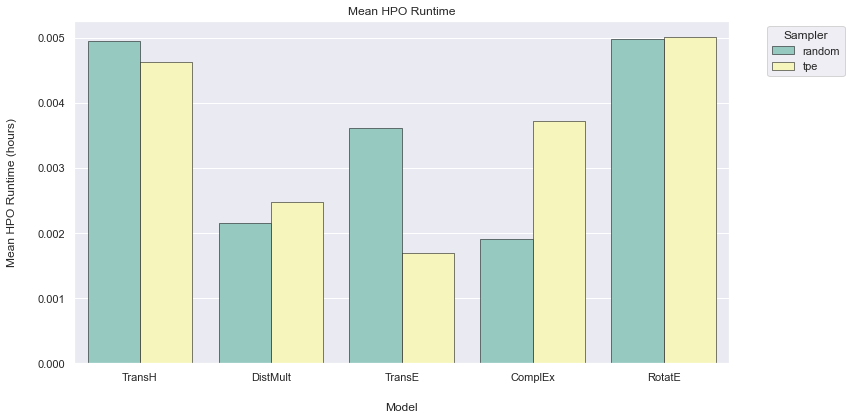

In [102]:
plt.figure(figsize=(12, 6))  # Adjust size as needed

sns.set(style="darkgrid")

# create barplot
sns.barplot(x='model', y='mean_hpo_runtime_hours', hue='sampler', data=hpo_summary, palette='Set3', errorbar="sd", linewidth=0.5, edgecolor='black')

plt.title('Mean HPO Runtime')
plt.xlabel('Model', labelpad=20)
plt.ylabel('Mean HPO Runtime (hours)', labelpad=20)
# plt.xticks(rotation=45)  # Rotate model names for better readability

# Optional: Place the legend outside the plot
plt.legend(title='Sampler', bbox_to_anchor=(1.05, 1), loc='upper left')

plt.tight_layout()
plt.show()


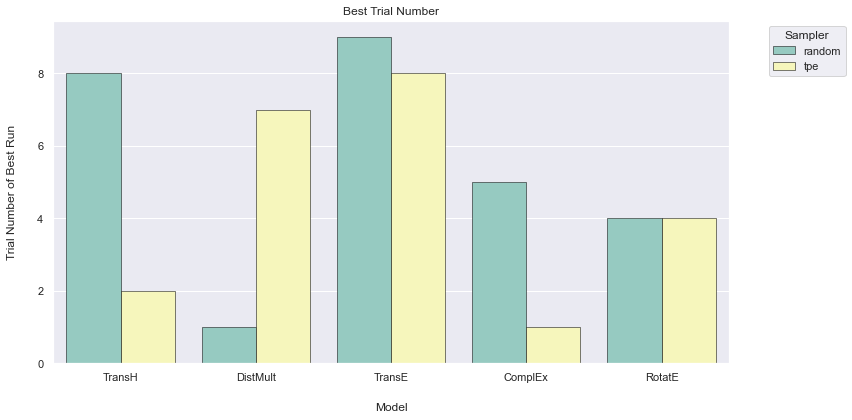

In [103]:
plt.figure(figsize=(12, 6))  # Adjust size as needed

sns.set(style="darkgrid")

# create barplot
sns.barplot(x='model', y='best_trial_number', hue='sampler', data=hpo_summary, palette='Set3', errorbar="sd", linewidth=0.5, edgecolor='black')

plt.title('Best Trial Number')
plt.xlabel('Model', labelpad=20)
plt.ylabel('Trial Number of Best Run', labelpad=20)
# plt.xticks(rotation=45)  # Rotate model names for better readability

# Optional: Place the legend outside the plot
plt.legend(title='Sampler', bbox_to_anchor=(1.05, 1), loc='upper left')

plt.tight_layout()
plt.show()


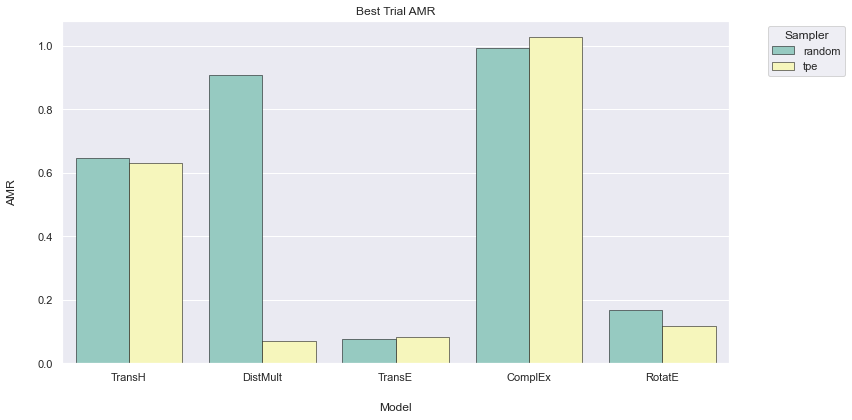

In [106]:
plt.figure(figsize=(12, 6))  # Adjust size as needed

sns.set(style="darkgrid")

# create barplot
sns.barplot(x='model', y='best_trial_AMR', hue='sampler', data=hpo_summary, palette='Set3', errorbar="sd", linewidth=0.5, edgecolor='black')

plt.title('Best Trial AMR')
plt.xlabel('Model', labelpad=20)
plt.ylabel('AMR', labelpad=20)
# plt.xticks(rotation=45)  # Rotate model names for better readability

# Optional: Place the legend outside the plot
plt.legend(title='Sampler', bbox_to_anchor=(1.05, 1), loc='upper left')

plt.tight_layout()
plt.show()


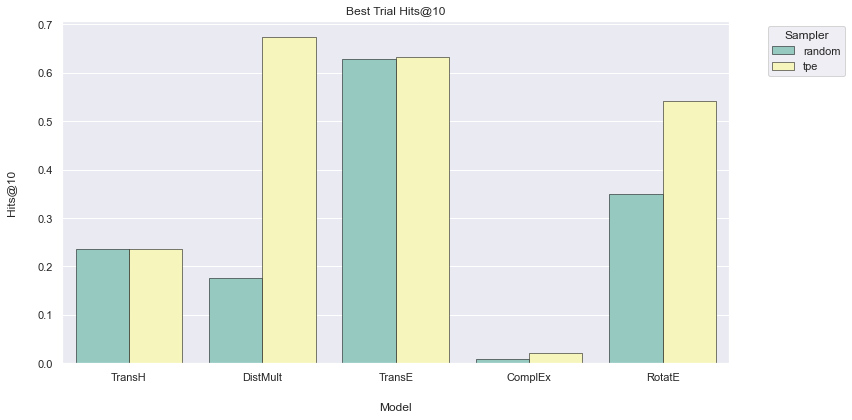

In [105]:
plt.figure(figsize=(12, 6))  # Adjust size as needed

sns.set(style="darkgrid")

# create barplot
sns.barplot(x='model', y='best_trial_hits@10', hue='sampler', data=hpo_summary, palette='Set3', errorbar="sd", linewidth=0.5, edgecolor='black')

plt.title('Best Trial Hits@10')
plt.xlabel('Model', labelpad=20)
plt.ylabel('Hits@10', labelpad=20)
# plt.xticks(rotation=45)  # Rotate model names for better readability

# Optional: Place the legend outside the plot
plt.legend(title='Sampler', bbox_to_anchor=(1.05, 1), loc='upper left')

plt.tight_layout()
plt.show()
